In [1]:
# Fix randomness and hide warnings
seed = 42

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
os.environ['PYTHONHASHSEED'] = str(seed)
os.environ['MPLCONFIGDIR'] = os.getcwd()+'/configs/'

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=Warning)

import numpy as np
np.random.seed(seed)

import logging

import random
random.seed(seed)

In [2]:
# Import tensorflow
import tensorflow as tf
from tensorflow import keras as tfk
from tensorflow.keras import layers as tfkl
tf.autograph.set_verbosity(0)
tf.get_logger().setLevel(logging.ERROR)
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)
print(tf.__version__)

2.13.0


In [3]:
import math
from PIL import Image
from keras import backend as K
import matplotlib.pyplot as plt
plt.rc('font', size=16)
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix

<h3>Create dataset and augment</h3>

In [4]:
normalized_volumes = np.load("/kaggle/input/biocv-dataset-true/normalized_dataset.npy")
X = [np.expand_dims(image,axis=-1) for volume in normalized_volumes for image in volume]
X = np.array(X)

In [5]:
vols_labels = np.load("/kaggle/input/biocv-dataset-true/labels.npy")
y = [np.expand_dims(image,axis=-1) for volume in vols_labels for image in volume]
y = np.array(y)

X = X.astype(np.float32)
print(len(np.unique(y)))

5


In [6]:
from sklearn.utils import shuffle
X,y = shuffle(X,y, random_state = seed)

In [7]:
segmentation_values_list = [0]+list(range(55,70)) +\
                            list(range(110, 135)) +\
                            list(range(175, 200)) +\
                            list(range(240, 255)) 
value_ranges = {
    (0,5) : 0,  #unlabelled
    (55, 70): 1, #Liver
    (110, 135): 2, #Right Kidney
    (175, 200): 3, #Left Kidney
    (240, 255): 4, #Spleen
}
def map_value_to_range(value, range_mapping):
    for value_range, label in range_mapping.items():
        if value_range[0] <= value <= value_range[1]:
            return label
    return -1
category_map = {value : map_value_to_range(value, value_ranges) for value in segmentation_values_list }
#print(category_map)
y = np.vectorize(category_map.get)(y)
#print(y)
num_classes = len(np.unique(y))
print('Number of classes',num_classes)

Number of classes 5


In [8]:

import albumentations as A

# Split the data into training, validation, and test sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=80, random_state=seed)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=80, random_state=seed)


augment = True
#Augment training data
if augment:
    transform = A.Compose([
        A.RandomCrop(width=256, height=256),
        A.Blur(p=0.8),
        #A.GaussNoise(p=0.65, var_limit=2.) 
        #A.RandomBrightnessContrast(p=1,brightness_limit=0.0001,contrast_limit=0.0001),
    ])
    X_train_a = []
    y_train_a = []
    for i in range(len(X_train)):
        augmented= transform(image=np.array(X_train[i],ndmin = 3),mask=np.array(y_train[i],ndmin=3)) 
        X_train_a.append(augmented["image"])
        y_train_a.append(augmented["mask"])
    X_train_a = np.array(X_train_a)
    y_train_a = np.array(y_train_a)
    X_train = np.concatenate((X_train,X_train_a))
    y_train = np.concatenate((y_train,y_train_a))

    transform = A.Compose([
        A.GaussNoise(var_limit=0.3, p = 1.), 
        #A.RandomBrightnessContrast(p=1,brightness_limit=0.0001,contrast_limit=0.0001)
    ])
    
    X_train_a1 = []
    y_train_a1 = []
    for i in range(len(X_train)):
        augmented= transform(image=np.array(X_train[i],ndmin = 3),mask=np.array(y_train[i],ndmin=3)) 
        X_train_a1.append(augmented["image"])
        y_train_a1.append(y_train[i])
    X_train_a1 = np.array(X_train_a1)
    y_train_a1 = np.array(y_train_a1)
    X_train = np.concatenate((X_train,X_train_a1))
    y_train = np.concatenate((y_train,y_train_a1))

# Display the shapes of the resulting datasets
X_train.shape, y_train.shape, X_val.shape, y_val.shape, X_test.shape, y_test.shape

((2000, 256, 256, 1),
 (2000, 256, 256, 1),
 (80, 256, 256, 1),
 (80, 256, 256, 1),
 (80, 256, 256, 1),
 (80, 256, 256, 1))

In [9]:
def display_color_mapped_image_continuous(image, n_colors=29):
    """
    Display an image with colors mapped from a given image array using a continuous colormap.
    The image array should contain integer values from 0 to n_colors-1, where each integer
    represents a different color sampled linearly from the colormap.

    Args:
    image (ndarray): An array of shape (H, W) containing integer values from 0 to n_colors-1.
    n_colors (int): The number of colors to use from the colormap. Max 30.
    """
    if n_colors > 30:
        raise ValueError("Maximum number of colors is 30.")
    if not (0 <= image.min() and image.max() < n_colors):
        raise ValueError("Image values should be in the range [0, n_colors-1].")

    # Using a continuous colormap (like 'viridis') and sampling linearly
    cmap = plt.get_cmap('')
    colors = cmap(np.linspace(0, 1, n_colors))

    # Map the colors
    colored_image = colors[image]

    return colored_image

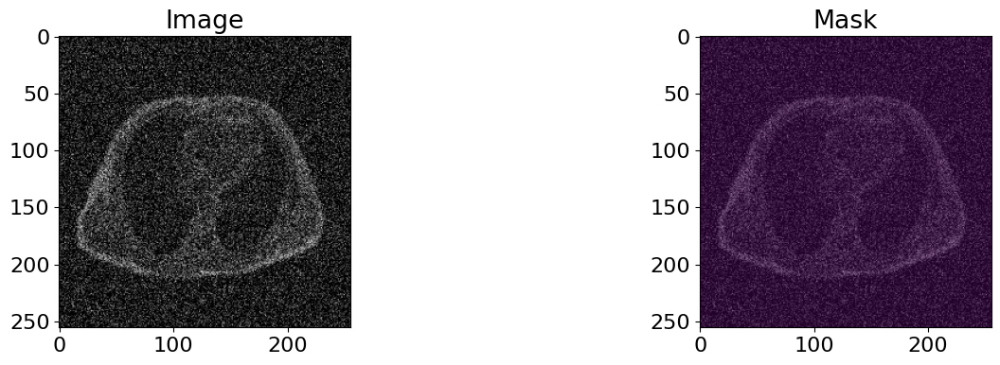

In [10]:
def plot_pairs(data, labels, index=None):
    if index == None:
        index = np.random.randint(0,len(data))
    fig, axes = plt.subplots(1, 2, figsize=(16,4))
    axes[0].set_title("Image")
    axes[0].imshow(data[index], cmap='gray')
    axes[1].set_title("Mask")
    axes[1].imshow(data[index], cmap='gray')
    #colored_image = display_color_mapped_image_continuous(labels[index])
    axes[1].imshow(np.squeeze(labels[index]),alpha=0.5)
    plt.show()
plot_pairs(X_train,y_train)

In [11]:
input_shape = X_train.shape[1:]
print('Input shape',input_shape)

Input shape (256, 256, 1)


<h3>Build UNet</h3>

In [12]:
def unet_block(input_tensor, filters, kernel_size=3, activation='relu', stack=2, name=''):

    x = input_tensor
    for i in range(stack):
        x = tfkl.Conv2D(filters, kernel_size=3, padding='same', name=name+'conv'+str(i+1))(x)
        x = tfkl.BatchNormalization(name=name+'bn'+str(i+1))(x)
        x = tfkl.Activation(activation, name=name+'activation'+str(i+1))(x)

    return x

In [13]:
def get_unet_model(input_shape=input_shape, num_classes=num_classes, seed=seed):
    tf.random.set_seed(seed)
    input_layer = tfkl.Input(shape=input_shape, name='input_layer')

    # First Downsampling
    down_block_1 = unet_block(input_layer, 64, name='down_block1_')
    d1 = tfkl.MaxPooling2D()(down_block_1)

    # Second Downsampling
    down_block_2 = unet_block(d1, 128, name='down_block2_')
    d2 = tfkl.MaxPooling2D()(down_block_2)

    # Third Downsampling
    down_block_3 = unet_block(d2, 256, name='down_block3_')
    d3 = tfkl.MaxPooling2D()(down_block_3)

    # Fourth Downsampling
    down_block_4 = unet_block(d3, 512, name='down_block4_')
    d4 = tfkl.MaxPooling2D()(down_block_4)

    # Bottleneck
    bottleneck = unet_block(d4, 512, name='bottleneck')

    # First Upsampling
    u1 = tfkl.UpSampling2D()(bottleneck)
    u1 = tfkl.Add(name='add1')([u1,down_block_4])
    u1 = unet_block(u1, 256, name='up_block1_')

    # Second Upsampling
    u2 = tfkl.UpSampling2D()(u1)
    u2 = tfkl.Add(name='add2')([u2,down_block_3])
    u2 = unet_block(u2, 128, name='up_block2_')

    # Third Upsampling
    u3 = tfkl.UpSampling2D()(u2)
    u3 = tfkl.Add(name='add3')([u3,down_block_2])
    u3 = unet_block(u3, 64, name='up_block3_')

    # Forth Upsampling
    u4 = tfkl.UpSampling2D()(u3)
    u4 = tfkl.Add(name='add4')([u4,down_block_1])
    u4 = unet_block(u4, 64, name='up_block4_')

    # Output Layer
    output_layer = tf.keras.layers.Conv2D(num_classes, kernel_size=3, padding='same', activation="softmax", name='output_layer')(u4)

    model = tf.keras.Model(inputs=input_layer, outputs=output_layer)
    return model

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_layer (InputLayer)    [(None, 256, 256, 1)]        0         []                            
                                                                                                  
 down_block1_conv1 (Conv2D)  (None, 256, 256, 64)         640       ['input_layer[0][0]']         
                                                                                                  
 down_block1_bn1 (BatchNorm  (None, 256, 256, 64)         256       ['down_block1_conv1[0][0]']   
 alization)                                                                                       
                                                                                                  
 down_block1_activation1 (A  (None, 256, 256, 64)         0         ['down_block1_bn1[0][0]'] 

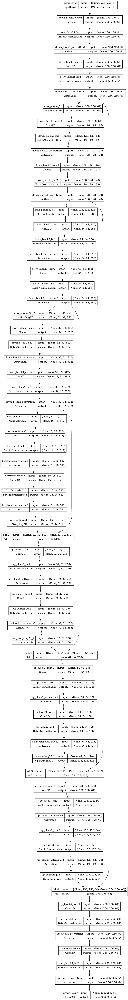

In [14]:
model = get_unet_model()
model.summary()
tf.keras.utils.plot_model(model, show_shapes=True, expand_nested=True)

In [15]:
# Define a custom metric class for mean intersection over union (IoU)
class UpdatedMeanIoU(tf.keras.metrics.MeanIoU):
    def __init__(self, num_classes=None, name="mean_iou", dtype=None):
        super(UpdatedMeanIoU, self).__init__(num_classes=num_classes, name=name, dtype=dtype)

    def update_state(self, y_true, y_pred, sample_weight=None):
        y_pred = tf.math.argmax(y_pred, axis=-1)
        return super().update_state(y_true, y_pred, sample_weight)

# Define a callback class for visualization during training
class VizCallback(tf.keras.callbacks.Callback):

    def __init__(self, image, label):
        super().__init__()
        self.image = image
        self.label = label

    def on_epoch_end(self, epoch, logs=None):
        # Predict using the model and visualize ground truth vs predicted mask
        pred = model.predict(self.image, verbose=0)
        y_pred = tf.math.argmax(pred, axis=-1)
        y_pred = np.array(y_pred)
        y_pred = np.reshape(y_pred, (256, 256, 1))
        fig, axes = plt.subplots(1, 2, figsize=(16, 4))
        axes[0].imshow(self.image[0], cmap='gray')
        axes[0].imshow(np.squeeze(self.label),alpha=0.5)
        axes[0].set_title("Ground Truth Mask")
        #colored_image = display_color_mapped_image_continuous(y_pred)
        axes[1].imshow(self.image[0], cmap='gray')
        axes[1].imshow(np.squeeze(y_pred),alpha=0.5)
        axes[1].set_title("Predicted Mask")
        plt.tight_layout()
        plt.show()

In [16]:
learning_rate = 1e-3
batch_size = 32
epochs = 1000

In [17]:
model.compile(
    loss = tf.keras.losses.SparseCategoricalCrossentropy(),
    optimizer = tfk.optimizers.AdamW(learning_rate,weight_decay = 5e-4),
    metrics = ["accuracy", UpdatedMeanIoU(num_classes=num_classes)]
    )

patience = 80
early_stopping = tfk.callbacks.EarlyStopping(monitor='val_mean_iou', mode='max', patience=patience, restore_best_weights=True)
viz_callback = VizCallback(np.expand_dims(X_val[0],axis=0), np.expand_dims(y_val[0],axis=0))
scheduler = tfk.callbacks.ReduceLROnPlateau(monitor='val_mean_iou', mode='max', factor=0.1, patience=patience-40, min_lr=1e-5)

Epoch 1/1000


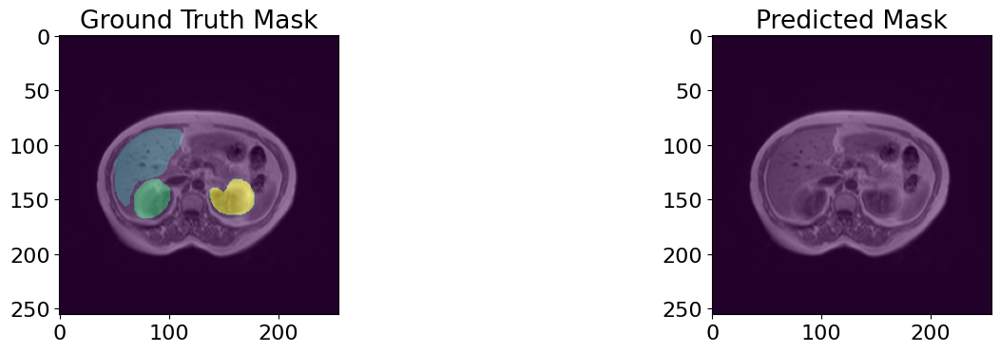

63/63 - 72s - loss: 0.2575 - accuracy: 0.9362 - mean_iou: 0.1890 - val_loss: 0.5667 - val_accuracy: 0.9567 - val_mean_iou: 0.1913 - lr: 0.0010 - 72s/epoch - 1s/step
Epoch 2/1000


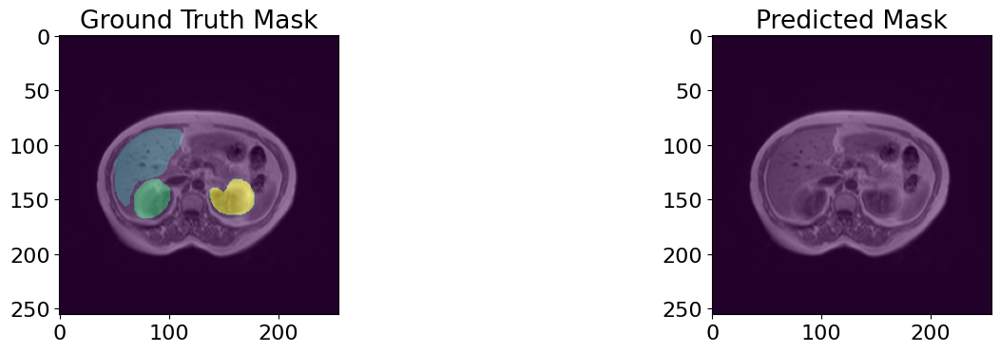

63/63 - 34s - loss: 0.1605 - accuracy: 0.9556 - mean_iou: 0.1913 - val_loss: 0.3193 - val_accuracy: 0.9567 - val_mean_iou: 0.1913 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 3/1000


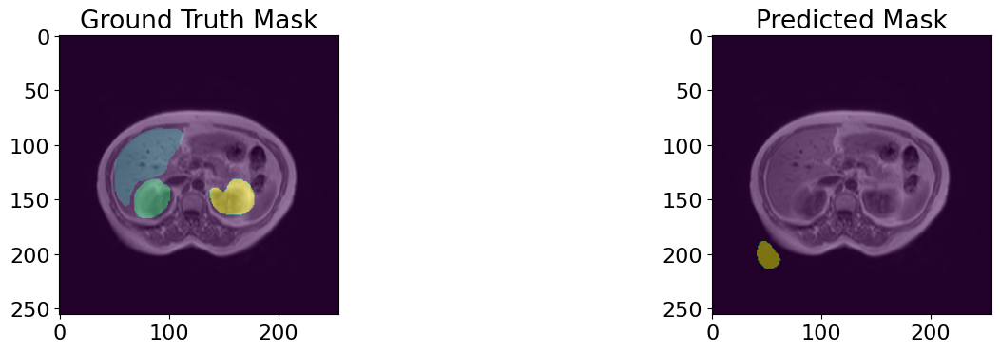

63/63 - 34s - loss: 0.1248 - accuracy: 0.9601 - mean_iou: 0.2475 - val_loss: 0.3409 - val_accuracy: 0.9444 - val_mean_iou: 0.1889 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 4/1000


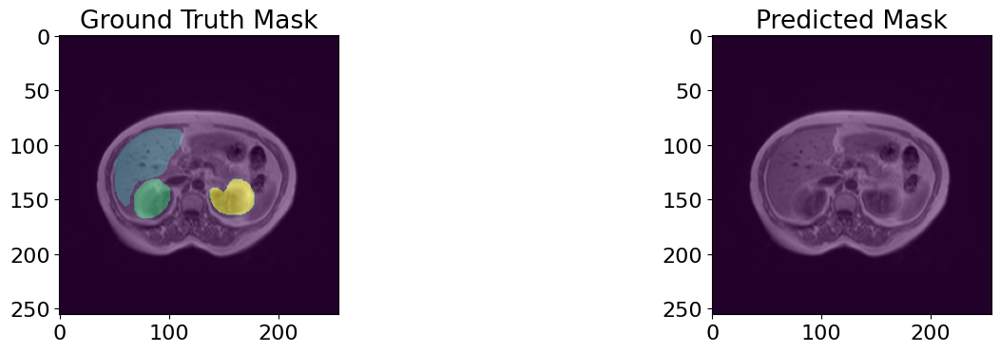

63/63 - 34s - loss: 0.0984 - accuracy: 0.9646 - mean_iou: 0.2906 - val_loss: 0.3001 - val_accuracy: 0.9548 - val_mean_iou: 0.1910 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 5/1000


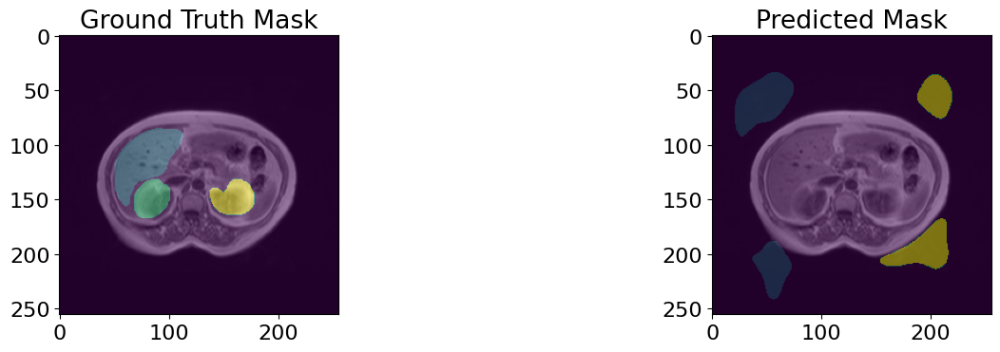

63/63 - 34s - loss: 0.0805 - accuracy: 0.9691 - mean_iou: 0.3757 - val_loss: 0.3455 - val_accuracy: 0.8772 - val_mean_iou: 0.1933 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 6/1000


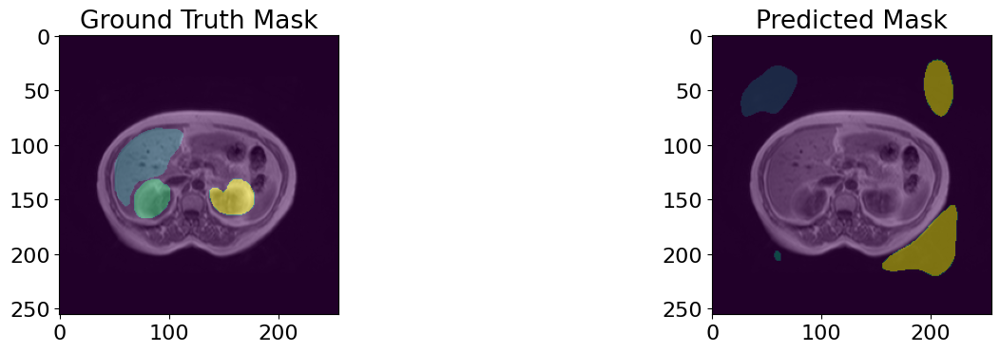

63/63 - 34s - loss: 0.0736 - accuracy: 0.9715 - mean_iou: 0.4287 - val_loss: 0.3854 - val_accuracy: 0.8895 - val_mean_iou: 0.1810 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 7/1000


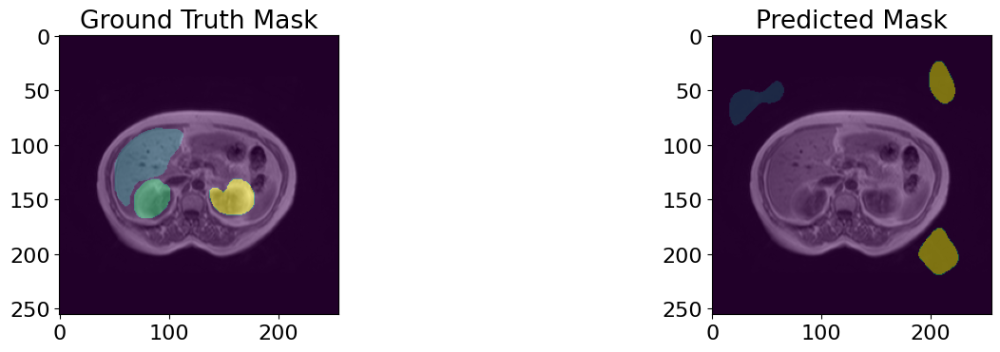

63/63 - 34s - loss: 0.0673 - accuracy: 0.9735 - mean_iou: 0.4850 - val_loss: 0.3880 - val_accuracy: 0.9260 - val_mean_iou: 0.1891 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 8/1000


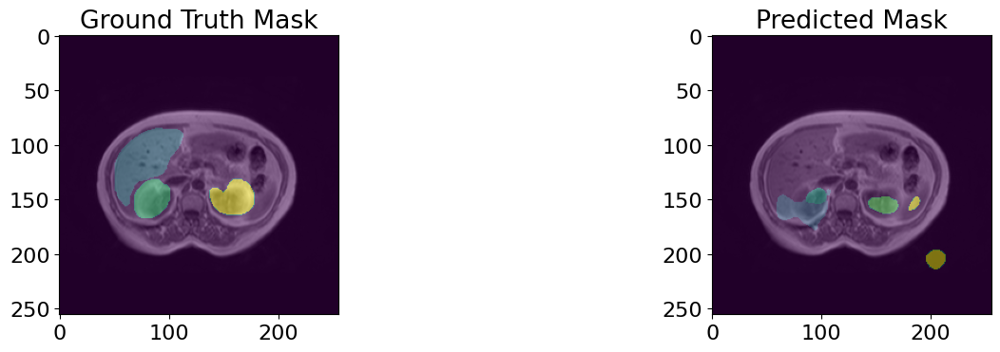

63/63 - 34s - loss: 0.0625 - accuracy: 0.9752 - mean_iou: 0.5254 - val_loss: 0.1731 - val_accuracy: 0.9526 - val_mean_iou: 0.2971 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 9/1000


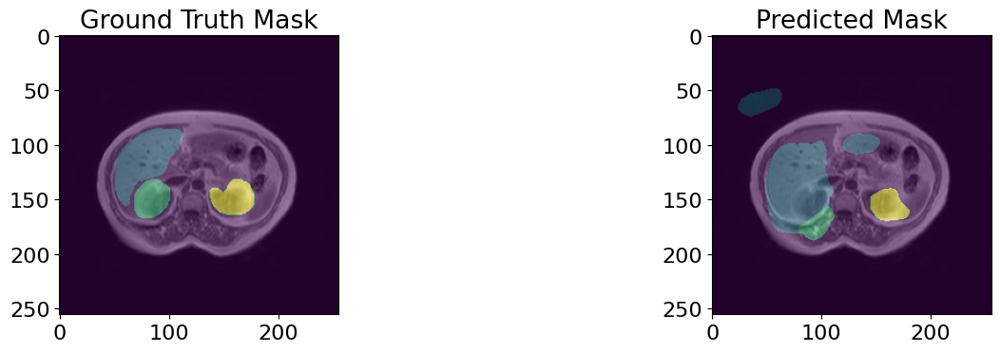

63/63 - 34s - loss: 0.0601 - accuracy: 0.9760 - mean_iou: 0.5379 - val_loss: 0.1353 - val_accuracy: 0.9525 - val_mean_iou: 0.4029 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 10/1000


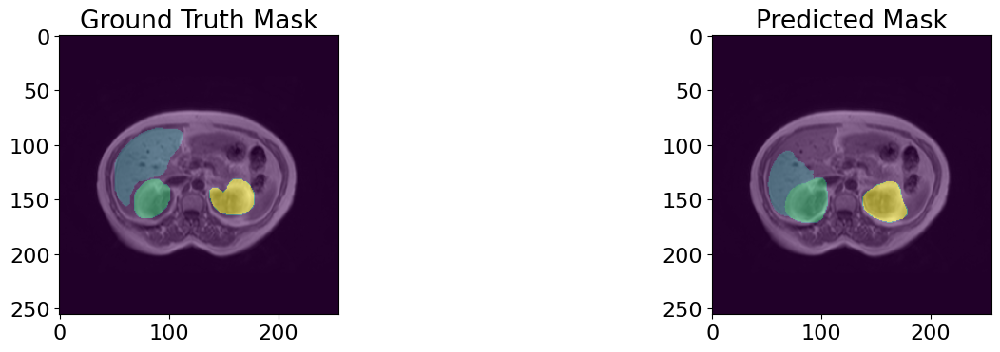

63/63 - 34s - loss: 0.0573 - accuracy: 0.9769 - mean_iou: 0.5655 - val_loss: 0.0850 - val_accuracy: 0.9648 - val_mean_iou: 0.4897 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 11/1000


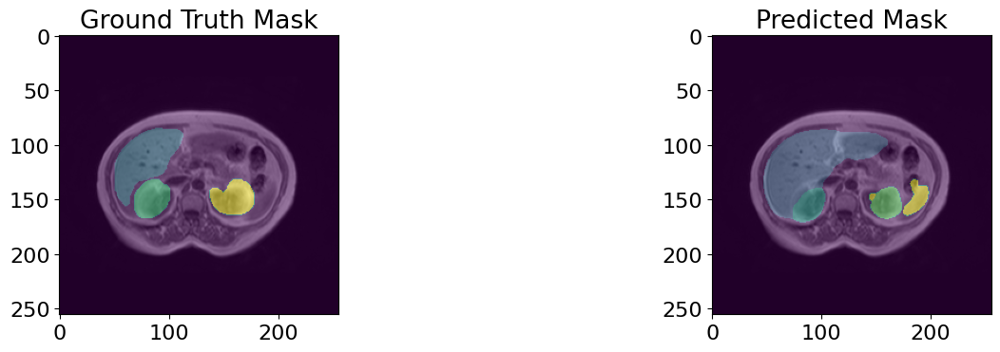

63/63 - 34s - loss: 0.0531 - accuracy: 0.9785 - mean_iou: 0.5855 - val_loss: 0.0570 - val_accuracy: 0.9766 - val_mean_iou: 0.6025 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 12/1000


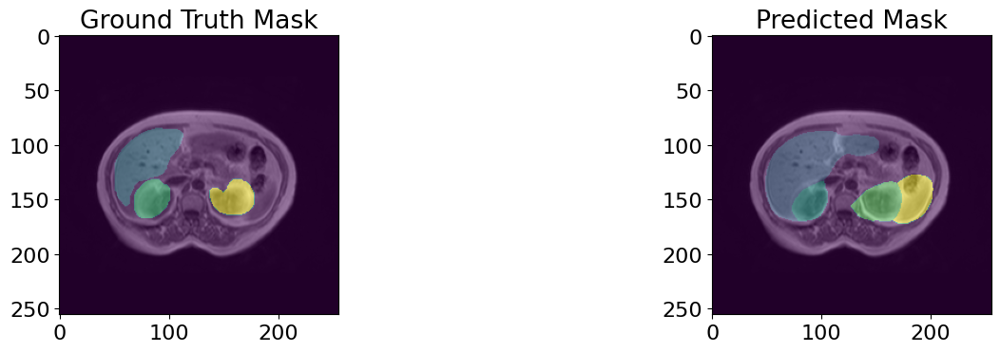

63/63 - 34s - loss: 0.0525 - accuracy: 0.9786 - mean_iou: 0.5825 - val_loss: 0.0775 - val_accuracy: 0.9682 - val_mean_iou: 0.5665 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 13/1000


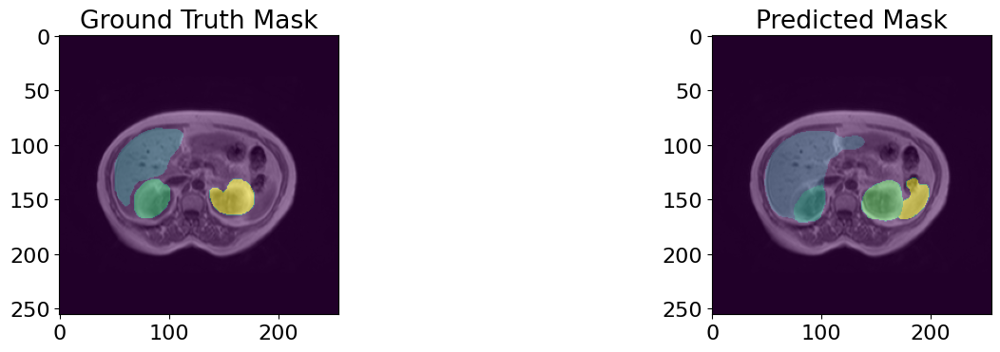

63/63 - 34s - loss: 0.0487 - accuracy: 0.9799 - mean_iou: 0.6114 - val_loss: 0.0646 - val_accuracy: 0.9734 - val_mean_iou: 0.6050 - lr: 0.0010 - 34s/epoch - 545ms/step
Epoch 14/1000


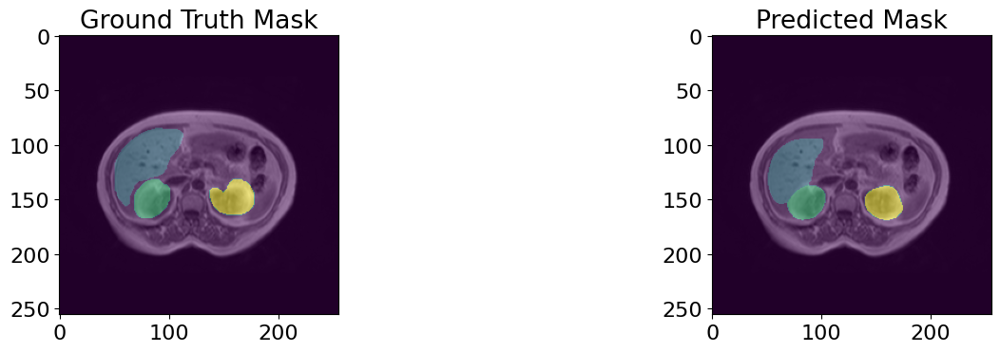

63/63 - 34s - loss: 0.0477 - accuracy: 0.9804 - mean_iou: 0.6243 - val_loss: 0.0542 - val_accuracy: 0.9788 - val_mean_iou: 0.5909 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 15/1000


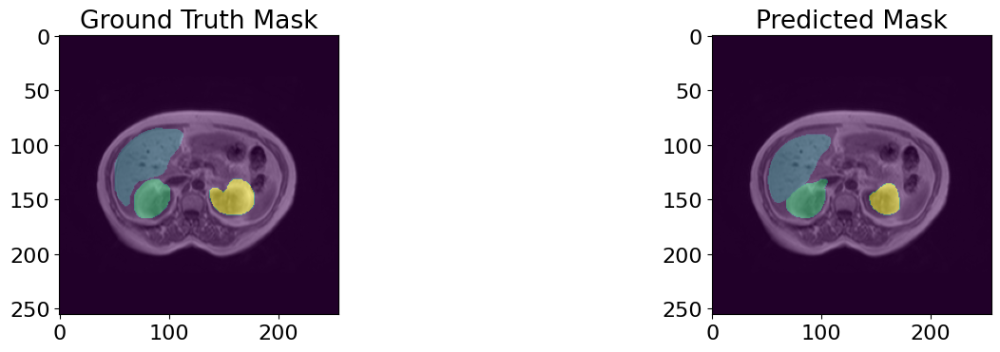

63/63 - 34s - loss: 0.0445 - accuracy: 0.9816 - mean_iou: 0.6437 - val_loss: 0.0502 - val_accuracy: 0.9807 - val_mean_iou: 0.6363 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 16/1000


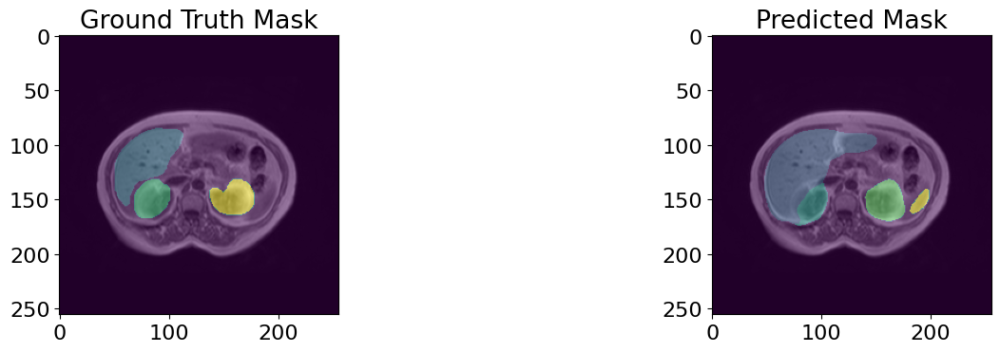

63/63 - 35s - loss: 0.0427 - accuracy: 0.9824 - mean_iou: 0.6560 - val_loss: 0.0614 - val_accuracy: 0.9753 - val_mean_iou: 0.6485 - lr: 0.0010 - 35s/epoch - 548ms/step
Epoch 17/1000


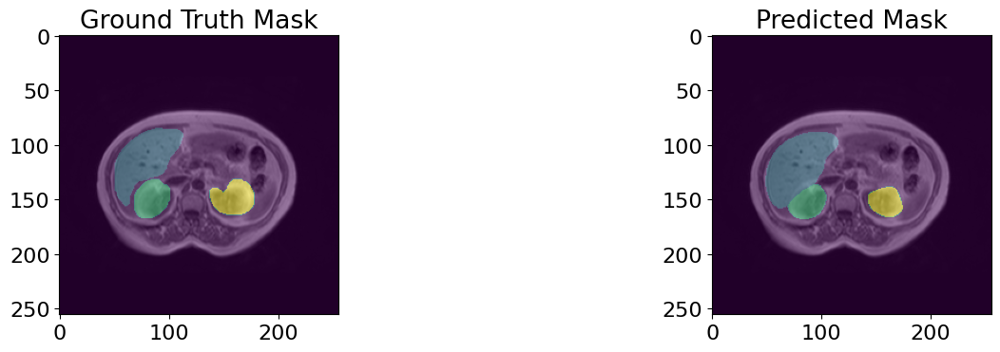

63/63 - 34s - loss: 0.0396 - accuracy: 0.9835 - mean_iou: 0.6824 - val_loss: 0.0453 - val_accuracy: 0.9826 - val_mean_iou: 0.6761 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 18/1000


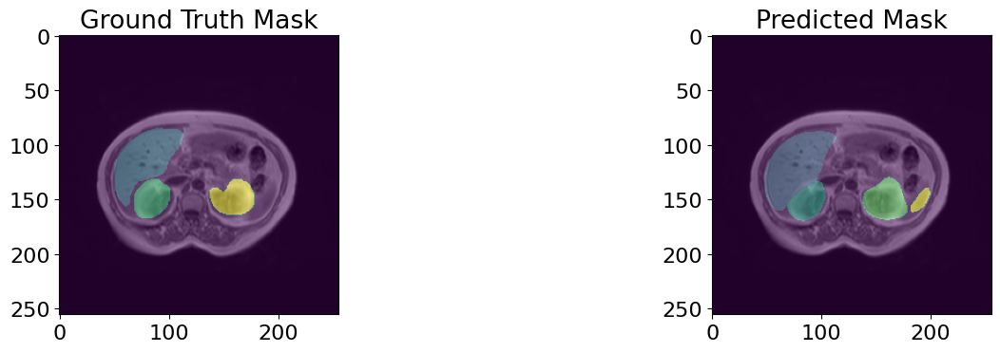

63/63 - 34s - loss: 0.0385 - accuracy: 0.9841 - mean_iou: 0.6879 - val_loss: 0.0439 - val_accuracy: 0.9837 - val_mean_iou: 0.6947 - lr: 0.0010 - 34s/epoch - 545ms/step
Epoch 19/1000


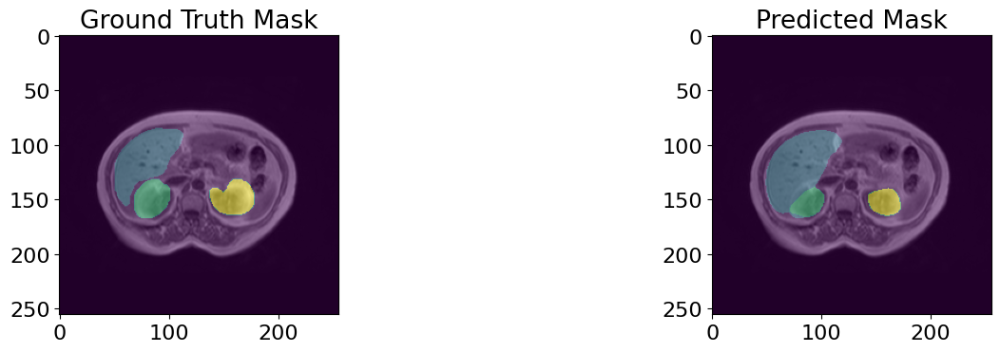

63/63 - 34s - loss: 0.0340 - accuracy: 0.9860 - mean_iou: 0.7188 - val_loss: 0.0403 - val_accuracy: 0.9841 - val_mean_iou: 0.6619 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 20/1000


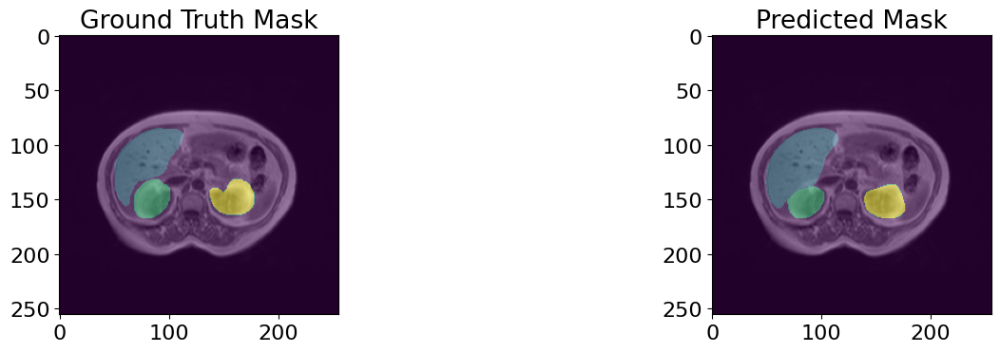

63/63 - 34s - loss: 0.0318 - accuracy: 0.9868 - mean_iou: 0.7330 - val_loss: 0.0380 - val_accuracy: 0.9848 - val_mean_iou: 0.7076 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 21/1000


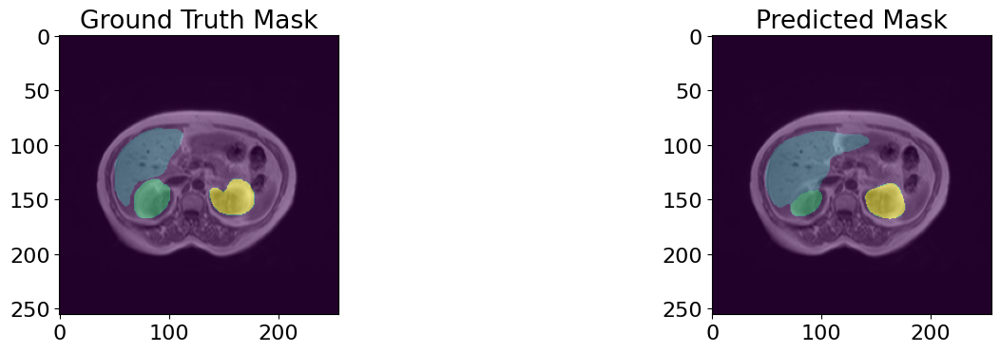

63/63 - 34s - loss: 0.0326 - accuracy: 0.9866 - mean_iou: 0.7346 - val_loss: 0.0481 - val_accuracy: 0.9821 - val_mean_iou: 0.6822 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 22/1000


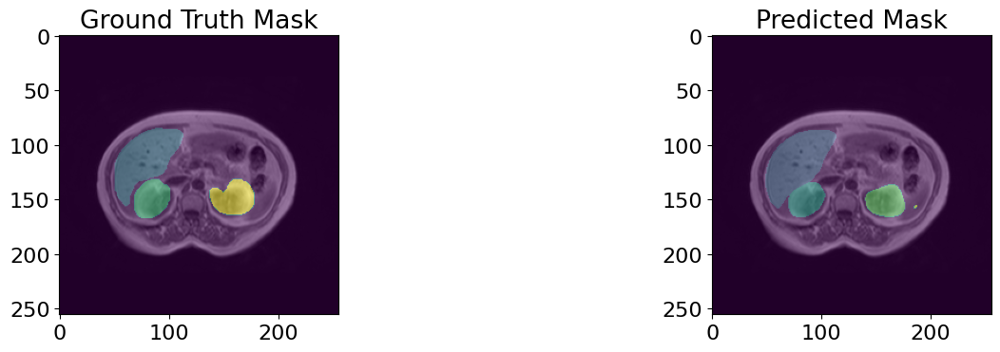

63/63 - 34s - loss: 0.0277 - accuracy: 0.9885 - mean_iou: 0.7678 - val_loss: 0.0420 - val_accuracy: 0.9845 - val_mean_iou: 0.7001 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 23/1000


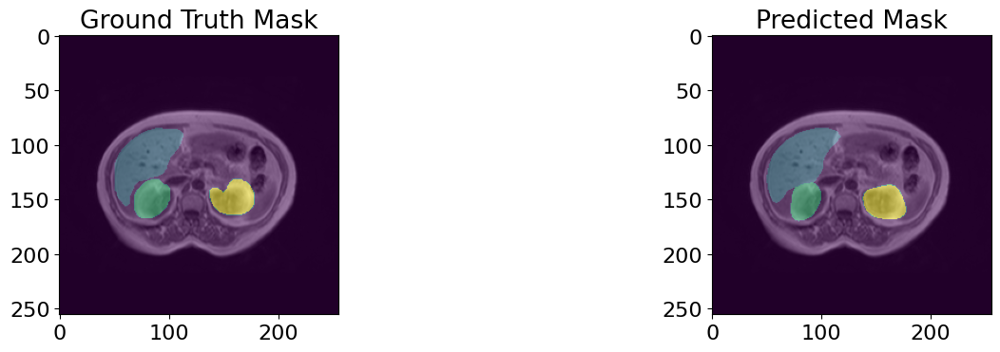

63/63 - 34s - loss: 0.0264 - accuracy: 0.9890 - mean_iou: 0.7741 - val_loss: 0.0384 - val_accuracy: 0.9854 - val_mean_iou: 0.7343 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 24/1000


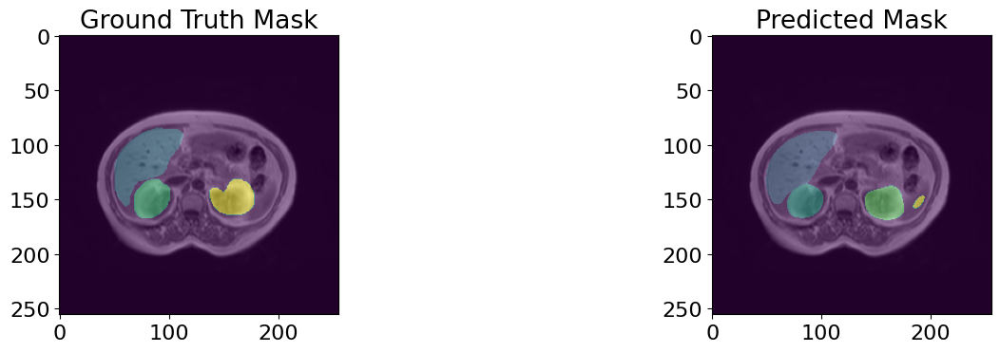

63/63 - 34s - loss: 0.0247 - accuracy: 0.9897 - mean_iou: 0.7883 - val_loss: 0.0393 - val_accuracy: 0.9852 - val_mean_iou: 0.7149 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 25/1000


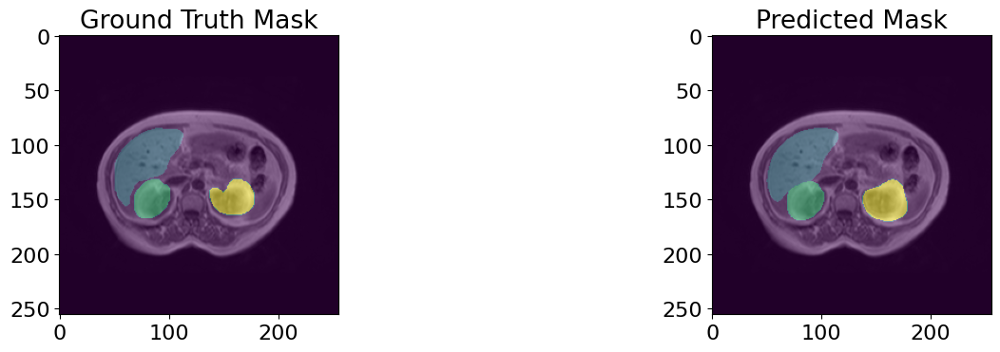

63/63 - 34s - loss: 0.0219 - accuracy: 0.9909 - mean_iou: 0.8105 - val_loss: 0.0349 - val_accuracy: 0.9861 - val_mean_iou: 0.7374 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 26/1000


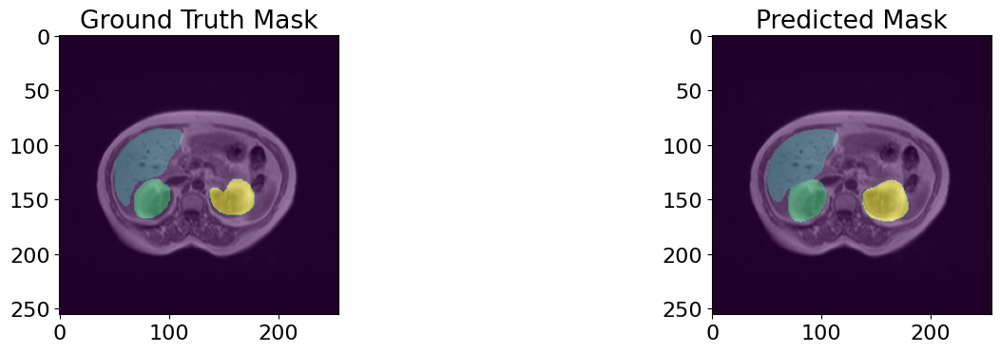

63/63 - 34s - loss: 0.0206 - accuracy: 0.9914 - mean_iou: 0.8212 - val_loss: 0.0374 - val_accuracy: 0.9863 - val_mean_iou: 0.7388 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 27/1000


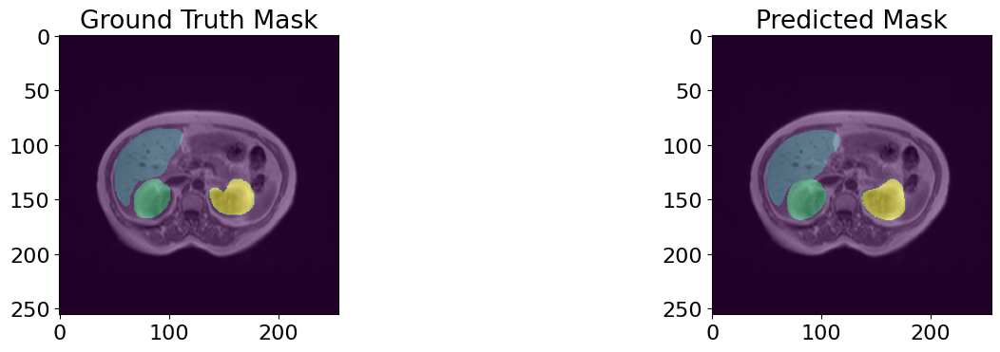

63/63 - 34s - loss: 0.0198 - accuracy: 0.9917 - mean_iou: 0.8252 - val_loss: 0.0391 - val_accuracy: 0.9860 - val_mean_iou: 0.7389 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 28/1000


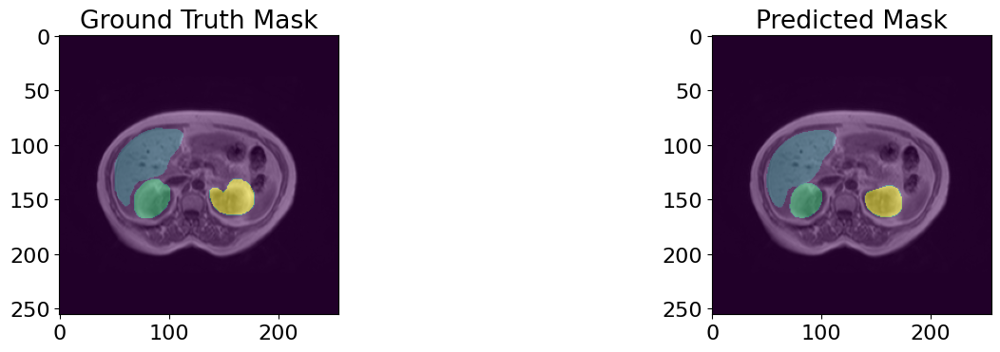

63/63 - 34s - loss: 0.0180 - accuracy: 0.9925 - mean_iou: 0.8390 - val_loss: 0.0432 - val_accuracy: 0.9863 - val_mean_iou: 0.6995 - lr: 0.0010 - 34s/epoch - 546ms/step
Epoch 29/1000


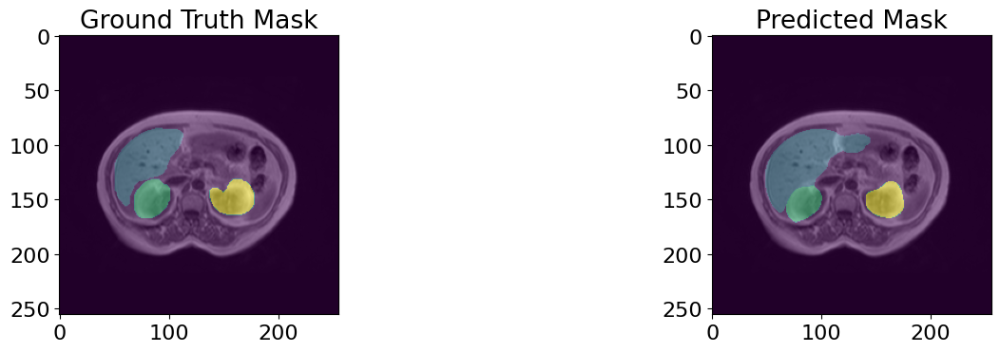

63/63 - 34s - loss: 0.0189 - accuracy: 0.9921 - mean_iou: 0.8293 - val_loss: 0.0472 - val_accuracy: 0.9842 - val_mean_iou: 0.7000 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 30/1000


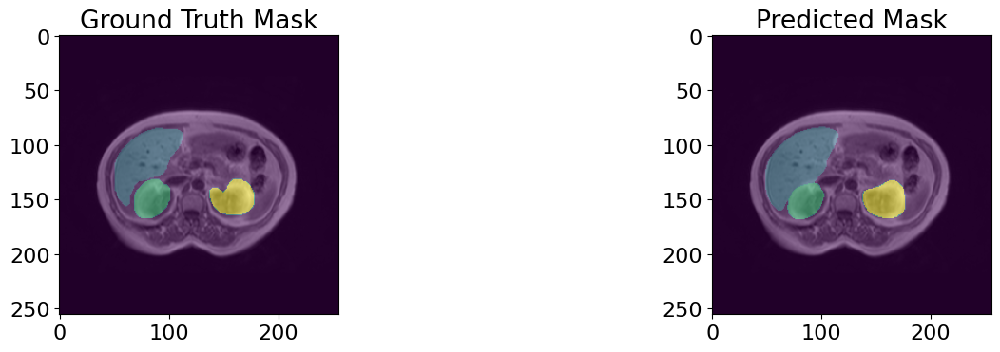

63/63 - 34s - loss: 0.0168 - accuracy: 0.9929 - mean_iou: 0.8511 - val_loss: 0.0384 - val_accuracy: 0.9867 - val_mean_iou: 0.7561 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 31/1000


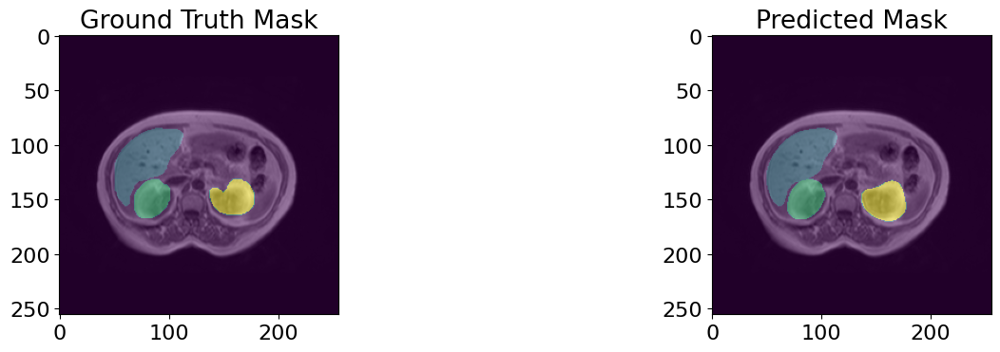

63/63 - 34s - loss: 0.0160 - accuracy: 0.9933 - mean_iou: 0.8607 - val_loss: 0.0360 - val_accuracy: 0.9876 - val_mean_iou: 0.7694 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 32/1000


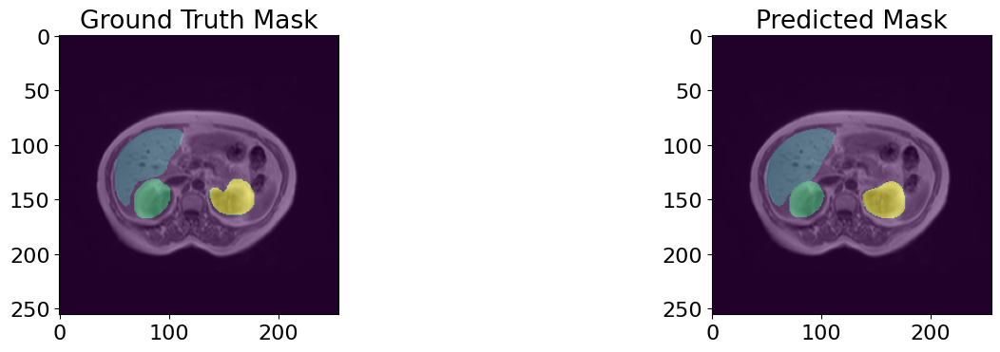

63/63 - 34s - loss: 0.0168 - accuracy: 0.9930 - mean_iou: 0.8513 - val_loss: 0.0401 - val_accuracy: 0.9872 - val_mean_iou: 0.7501 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 33/1000


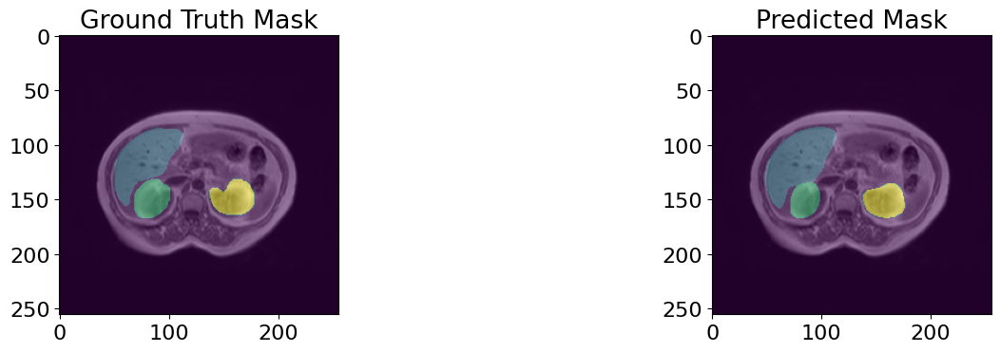

63/63 - 34s - loss: 0.0162 - accuracy: 0.9932 - mean_iou: 0.8559 - val_loss: 0.0427 - val_accuracy: 0.9868 - val_mean_iou: 0.7377 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 34/1000


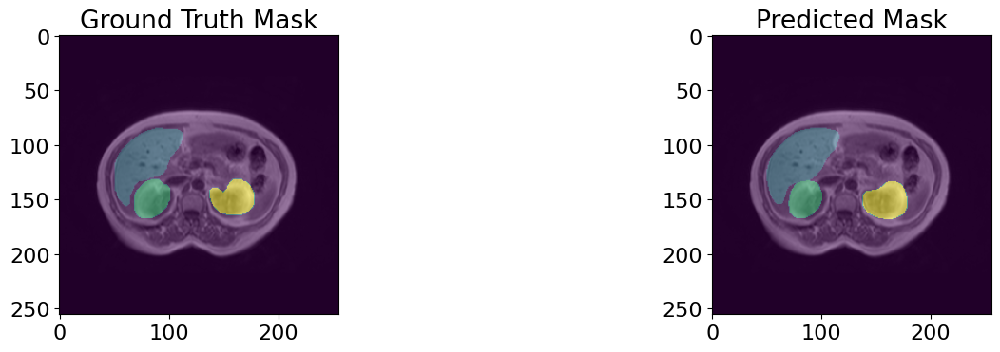

63/63 - 34s - loss: 0.0137 - accuracy: 0.9942 - mean_iou: 0.8785 - val_loss: 0.0358 - val_accuracy: 0.9880 - val_mean_iou: 0.7626 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 35/1000


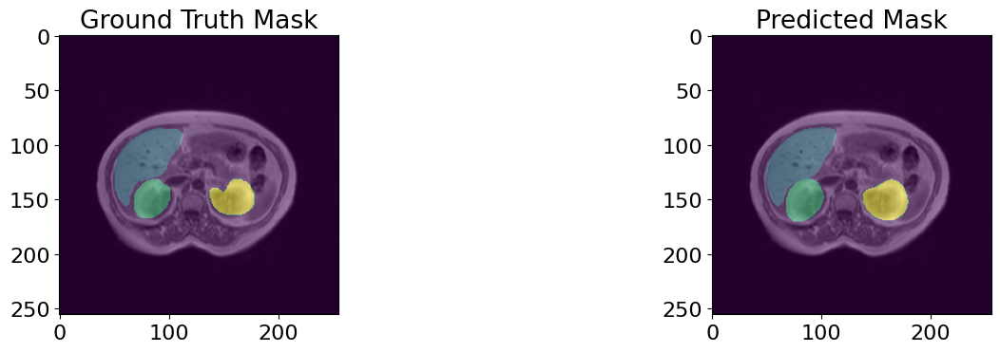

63/63 - 34s - loss: 0.0131 - accuracy: 0.9944 - mean_iou: 0.8836 - val_loss: 0.0426 - val_accuracy: 0.9868 - val_mean_iou: 0.7542 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 36/1000


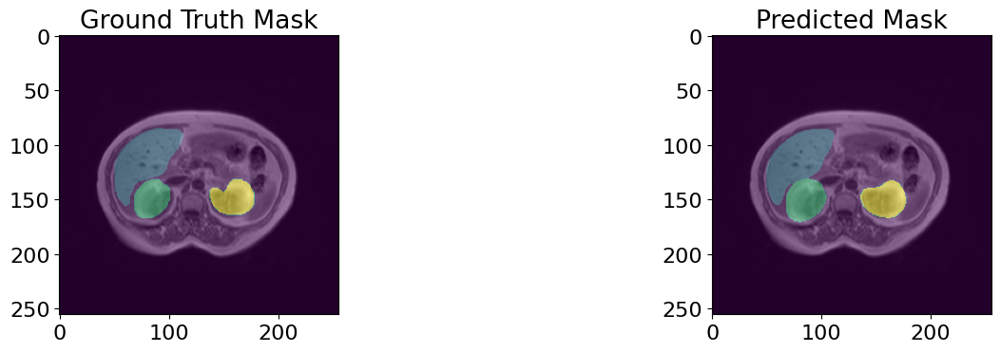

63/63 - 34s - loss: 0.0132 - accuracy: 0.9944 - mean_iou: 0.8768 - val_loss: 0.0397 - val_accuracy: 0.9872 - val_mean_iou: 0.7558 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 37/1000


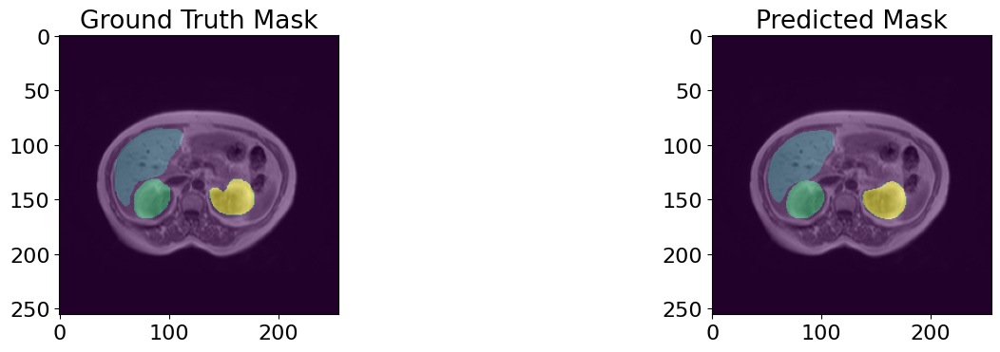

63/63 - 34s - loss: 0.0126 - accuracy: 0.9947 - mean_iou: 0.8852 - val_loss: 0.0401 - val_accuracy: 0.9880 - val_mean_iou: 0.7700 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 38/1000


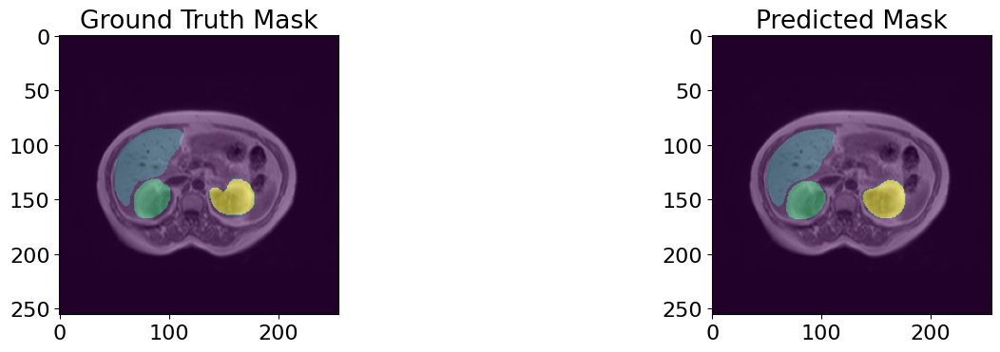

63/63 - 34s - loss: 0.0116 - accuracy: 0.9951 - mean_iou: 0.8941 - val_loss: 0.0402 - val_accuracy: 0.9883 - val_mean_iou: 0.7641 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 39/1000


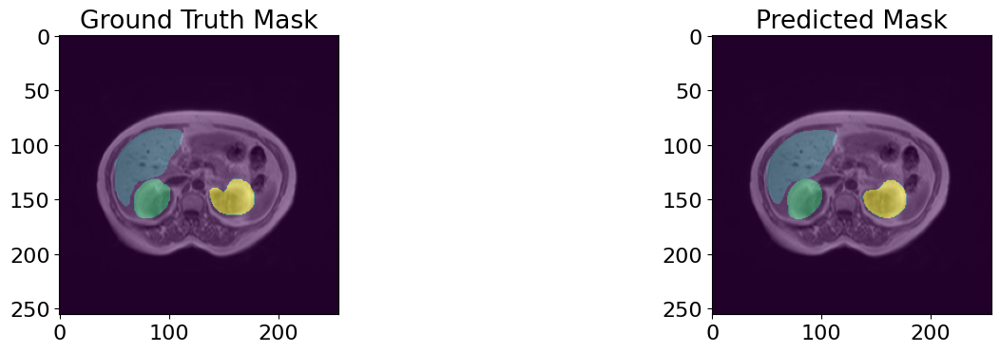

63/63 - 34s - loss: 0.0113 - accuracy: 0.9952 - mean_iou: 0.8970 - val_loss: 0.0400 - val_accuracy: 0.9886 - val_mean_iou: 0.7746 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 40/1000


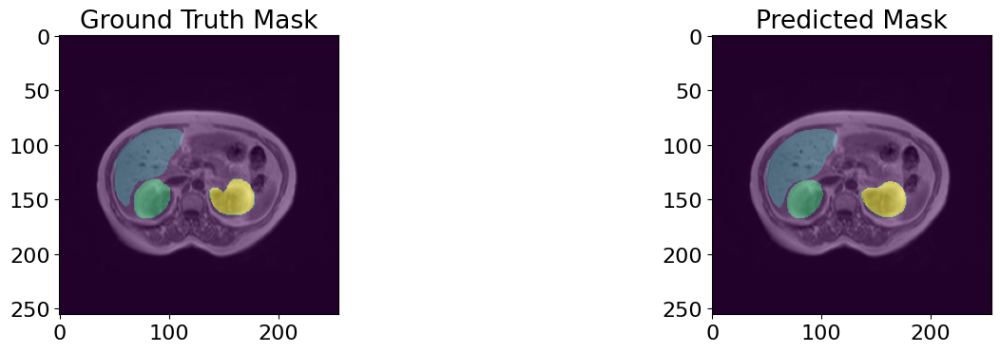

63/63 - 34s - loss: 0.0102 - accuracy: 0.9957 - mean_iou: 0.9046 - val_loss: 0.0442 - val_accuracy: 0.9879 - val_mean_iou: 0.7747 - lr: 0.0010 - 34s/epoch - 545ms/step
Epoch 41/1000


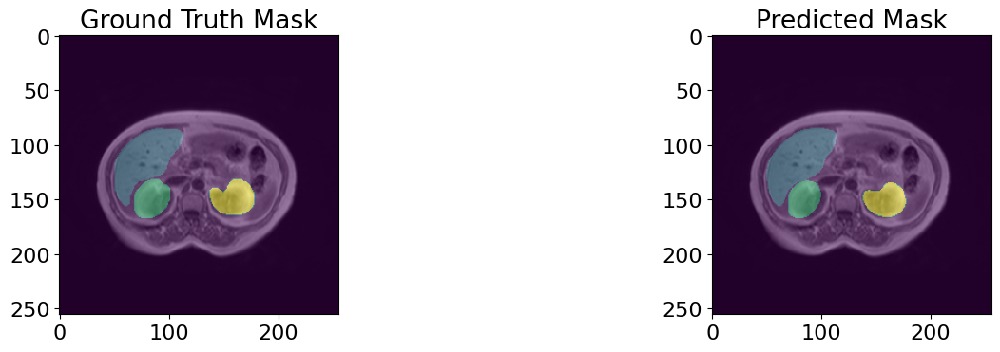

63/63 - 34s - loss: 0.0097 - accuracy: 0.9959 - mean_iou: 0.9097 - val_loss: 0.0437 - val_accuracy: 0.9884 - val_mean_iou: 0.7587 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 42/1000


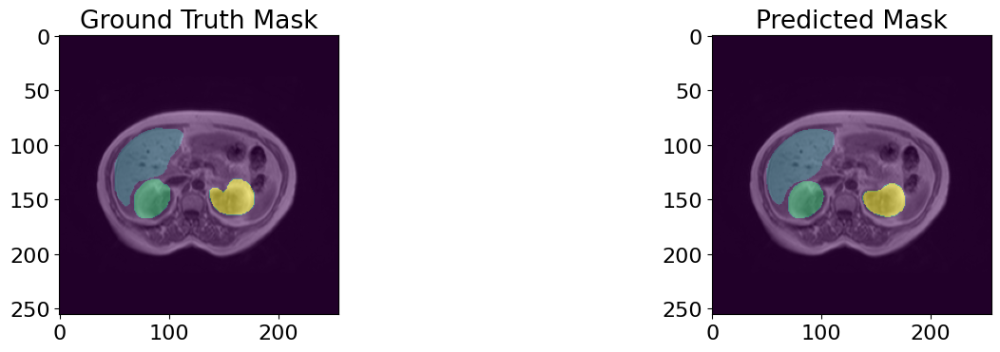

63/63 - 34s - loss: 0.0093 - accuracy: 0.9960 - mean_iou: 0.9121 - val_loss: 0.0453 - val_accuracy: 0.9879 - val_mean_iou: 0.7510 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 43/1000


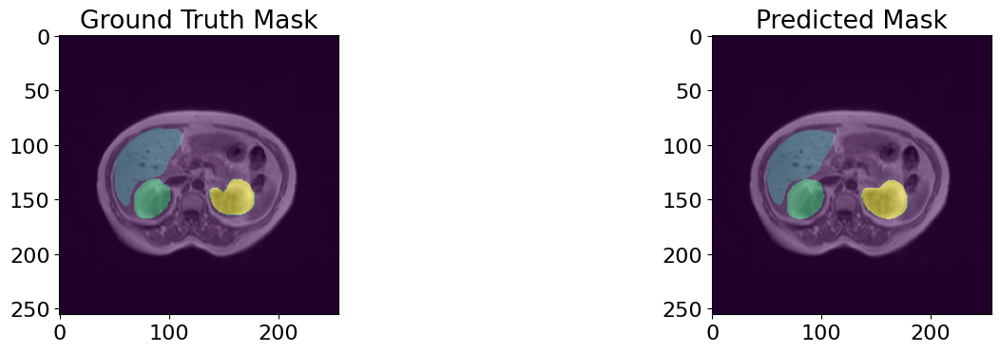

63/63 - 34s - loss: 0.0100 - accuracy: 0.9958 - mean_iou: 0.9042 - val_loss: 0.0455 - val_accuracy: 0.9884 - val_mean_iou: 0.7748 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 44/1000


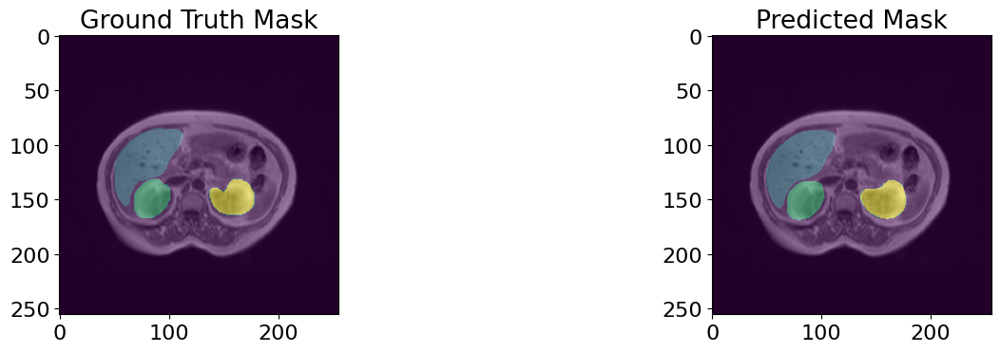

63/63 - 35s - loss: 0.0092 - accuracy: 0.9961 - mean_iou: 0.9115 - val_loss: 0.0419 - val_accuracy: 0.9883 - val_mean_iou: 0.7781 - lr: 0.0010 - 35s/epoch - 549ms/step
Epoch 45/1000


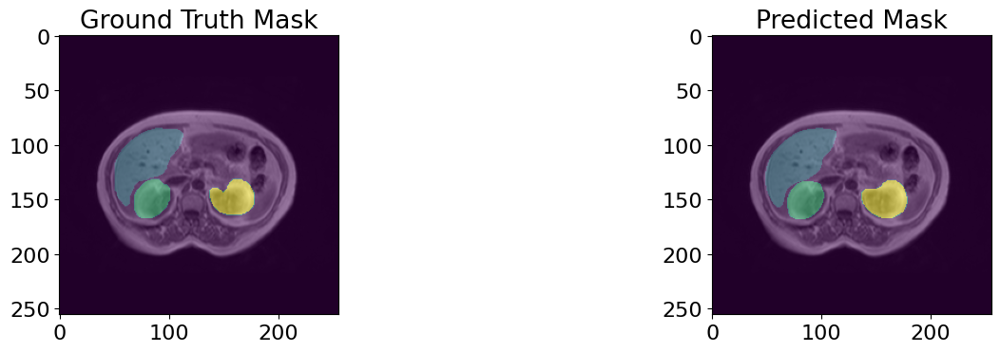

63/63 - 34s - loss: 0.0087 - accuracy: 0.9963 - mean_iou: 0.9175 - val_loss: 0.0432 - val_accuracy: 0.9882 - val_mean_iou: 0.7772 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 46/1000


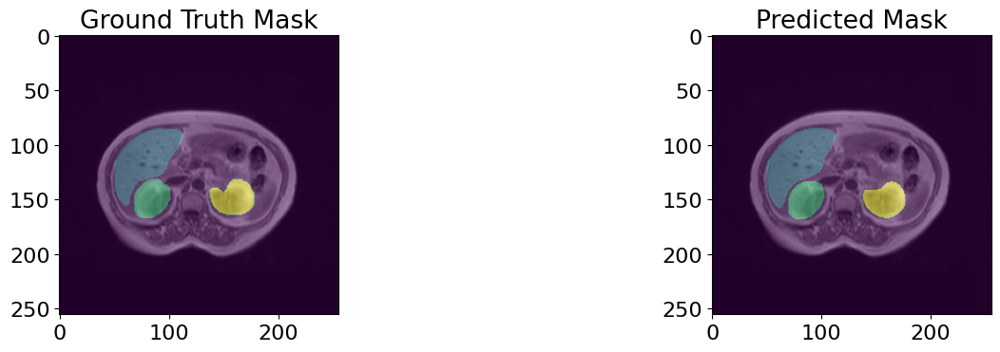

63/63 - 34s - loss: 0.0085 - accuracy: 0.9964 - mean_iou: 0.9202 - val_loss: 0.0466 - val_accuracy: 0.9881 - val_mean_iou: 0.7696 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 47/1000


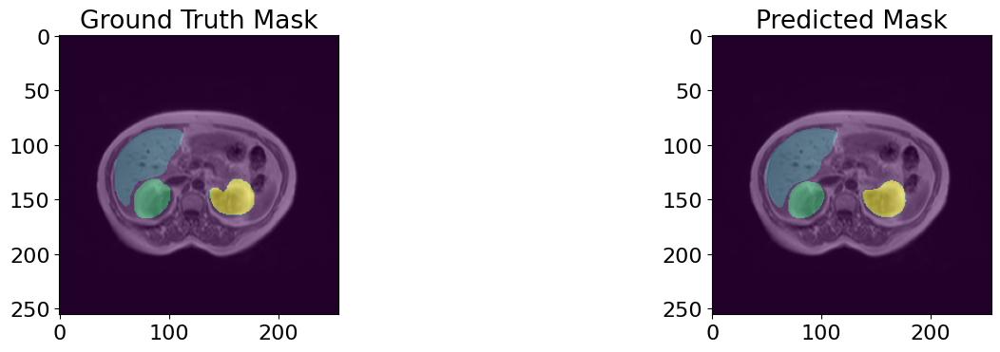

63/63 - 34s - loss: 0.0088 - accuracy: 0.9963 - mean_iou: 0.9129 - val_loss: 0.0483 - val_accuracy: 0.9881 - val_mean_iou: 0.7703 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 48/1000


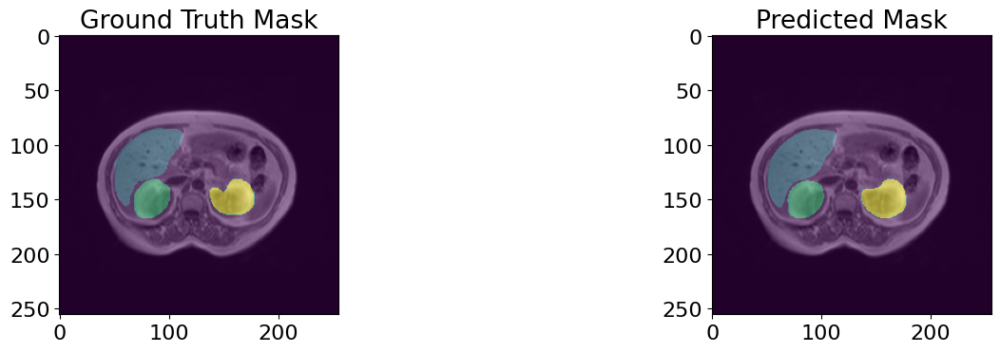

63/63 - 34s - loss: 0.0085 - accuracy: 0.9964 - mean_iou: 0.9196 - val_loss: 0.0456 - val_accuracy: 0.9882 - val_mean_iou: 0.7694 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 49/1000


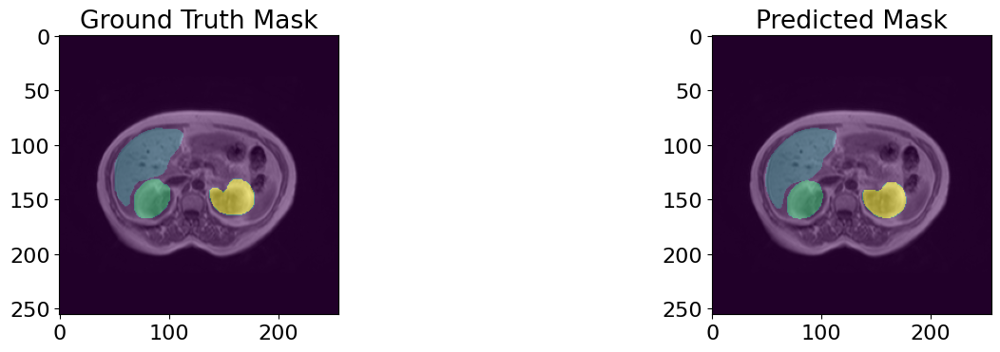

63/63 - 34s - loss: 0.0078 - accuracy: 0.9967 - mean_iou: 0.9257 - val_loss: 0.0454 - val_accuracy: 0.9884 - val_mean_iou: 0.7758 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 50/1000


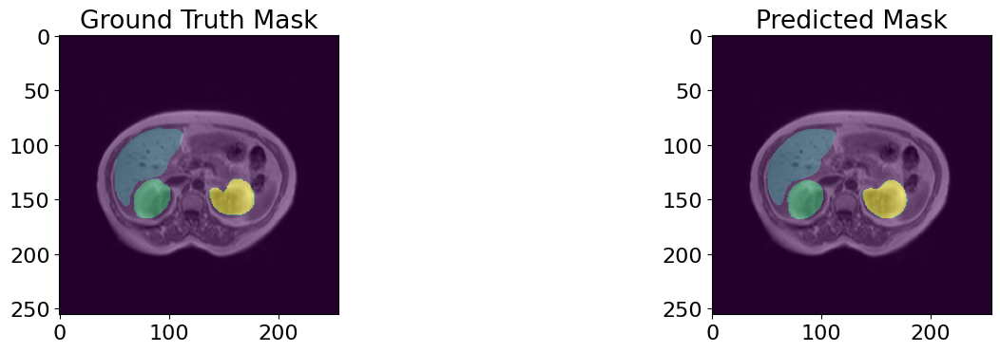

63/63 - 34s - loss: 0.0074 - accuracy: 0.9969 - mean_iou: 0.9300 - val_loss: 0.0451 - val_accuracy: 0.9887 - val_mean_iou: 0.7773 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 51/1000


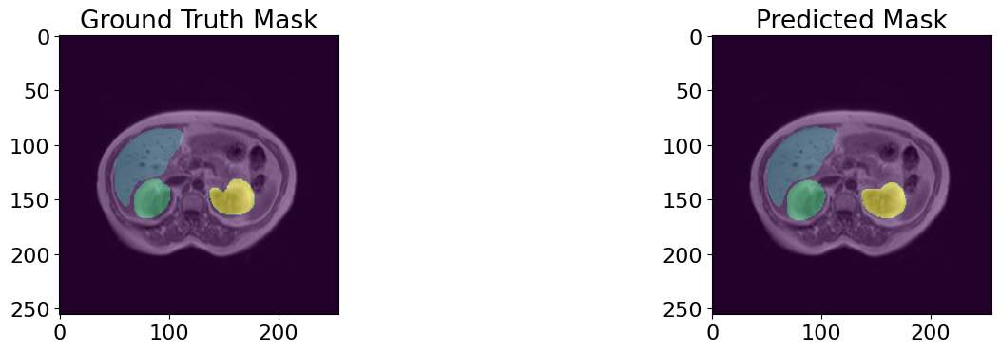

63/63 - 34s - loss: 0.0072 - accuracy: 0.9969 - mean_iou: 0.9292 - val_loss: 0.0450 - val_accuracy: 0.9886 - val_mean_iou: 0.7799 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 52/1000


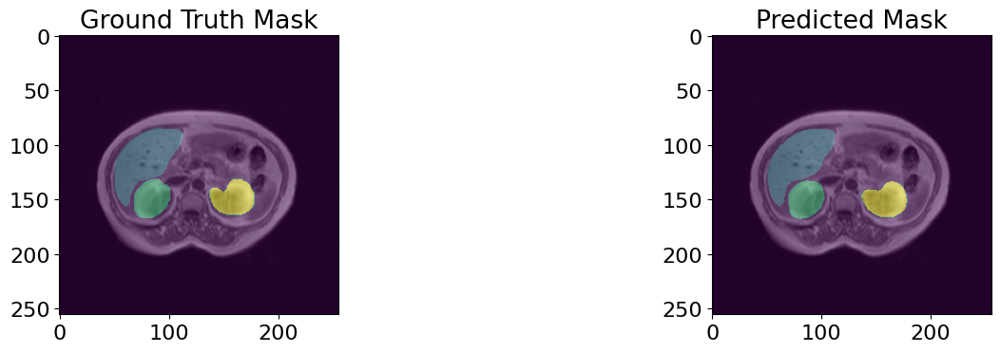

63/63 - 34s - loss: 0.0072 - accuracy: 0.9969 - mean_iou: 0.9279 - val_loss: 0.0467 - val_accuracy: 0.9888 - val_mean_iou: 0.7781 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 53/1000


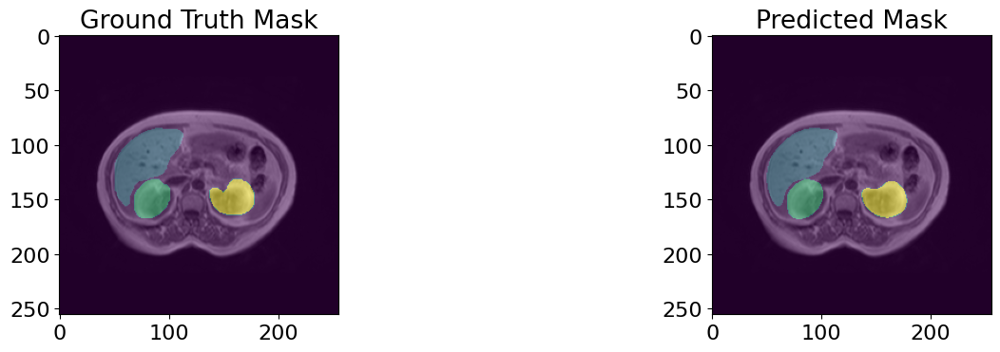

63/63 - 34s - loss: 0.0069 - accuracy: 0.9970 - mean_iou: 0.9336 - val_loss: 0.0481 - val_accuracy: 0.9883 - val_mean_iou: 0.7795 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 54/1000


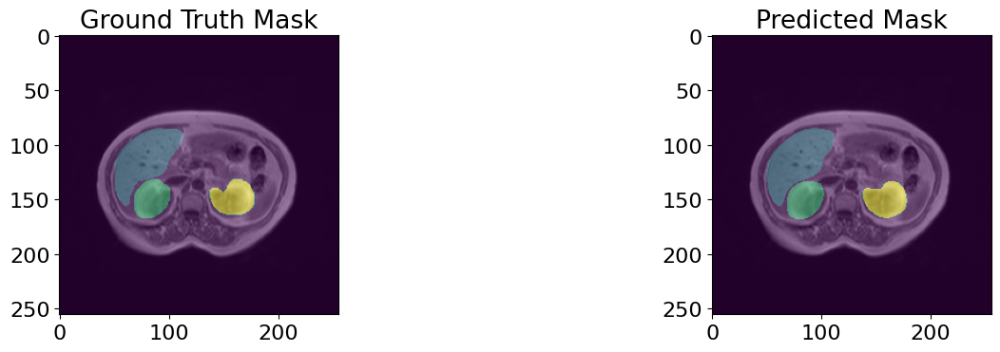

63/63 - 34s - loss: 0.0064 - accuracy: 0.9973 - mean_iou: 0.9361 - val_loss: 0.0489 - val_accuracy: 0.9889 - val_mean_iou: 0.7768 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 55/1000


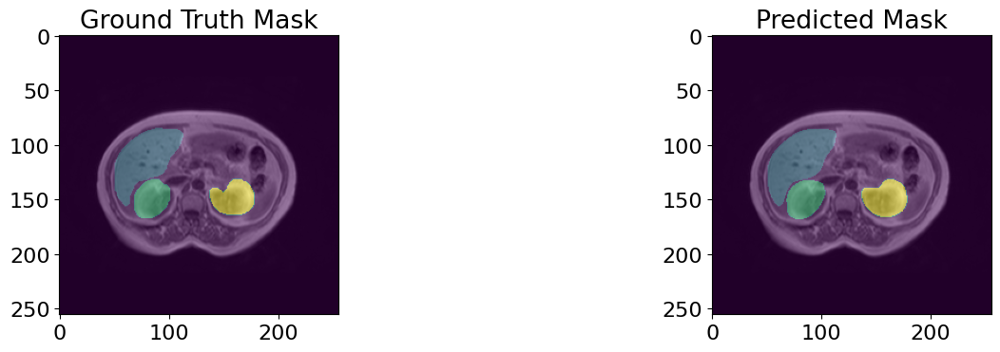

63/63 - 34s - loss: 0.0067 - accuracy: 0.9971 - mean_iou: 0.9351 - val_loss: 0.0504 - val_accuracy: 0.9884 - val_mean_iou: 0.7803 - lr: 0.0010 - 34s/epoch - 545ms/step
Epoch 56/1000


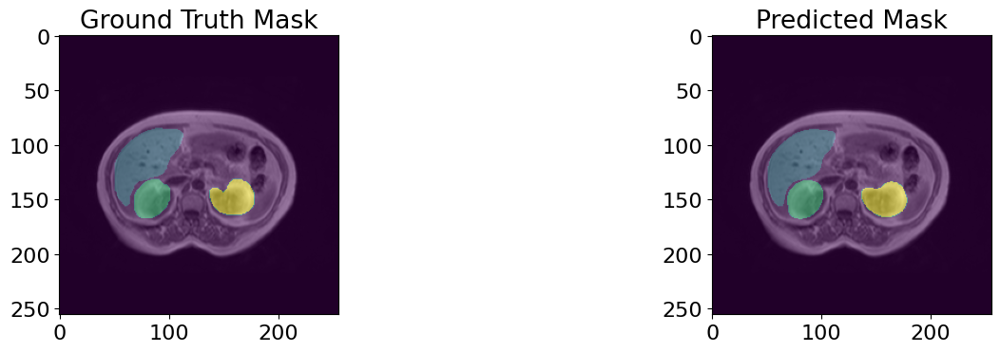

63/63 - 34s - loss: 0.0062 - accuracy: 0.9973 - mean_iou: 0.9377 - val_loss: 0.0509 - val_accuracy: 0.9888 - val_mean_iou: 0.7827 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 57/1000


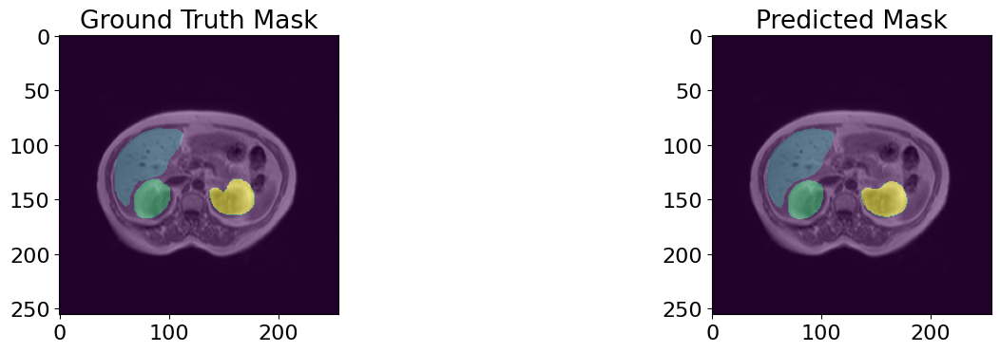

63/63 - 34s - loss: 0.0060 - accuracy: 0.9974 - mean_iou: 0.9398 - val_loss: 0.0512 - val_accuracy: 0.9887 - val_mean_iou: 0.7851 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 58/1000


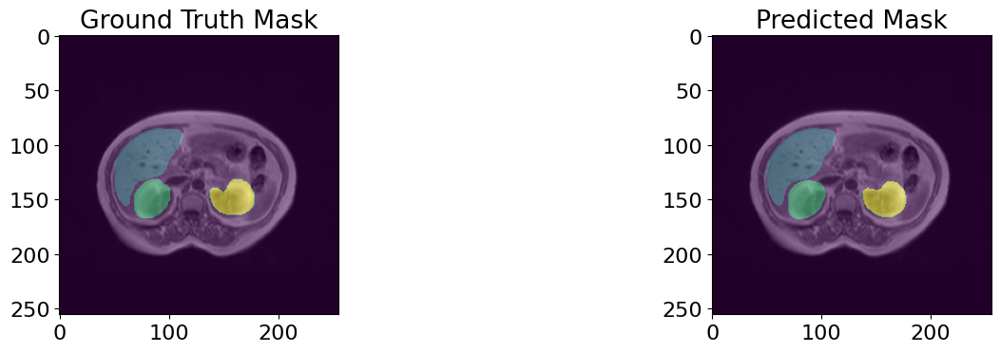

63/63 - 34s - loss: 0.0059 - accuracy: 0.9975 - mean_iou: 0.9396 - val_loss: 0.0499 - val_accuracy: 0.9890 - val_mean_iou: 0.7834 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 59/1000


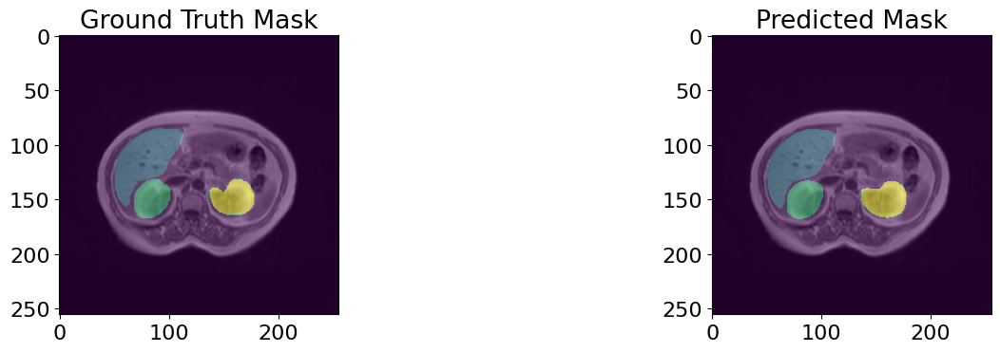

63/63 - 34s - loss: 0.0058 - accuracy: 0.9975 - mean_iou: 0.9407 - val_loss: 0.0510 - val_accuracy: 0.9885 - val_mean_iou: 0.7792 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 60/1000


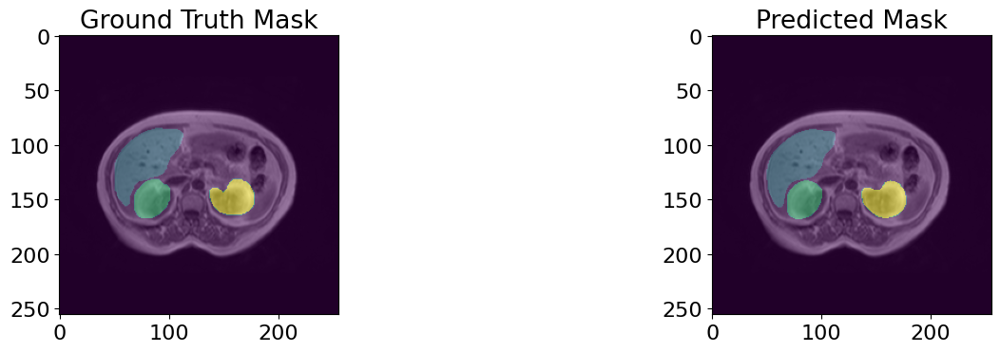

63/63 - 34s - loss: 0.0059 - accuracy: 0.9975 - mean_iou: 0.9421 - val_loss: 0.0532 - val_accuracy: 0.9885 - val_mean_iou: 0.7795 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 61/1000


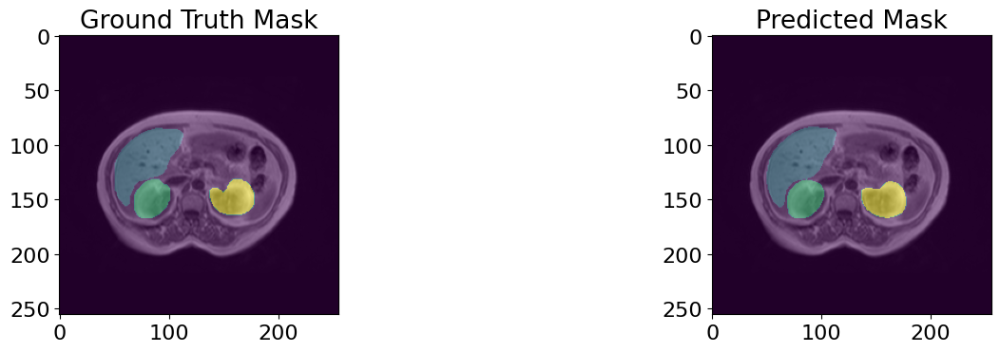

63/63 - 34s - loss: 0.0057 - accuracy: 0.9975 - mean_iou: 0.9428 - val_loss: 0.0538 - val_accuracy: 0.9882 - val_mean_iou: 0.7741 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 62/1000


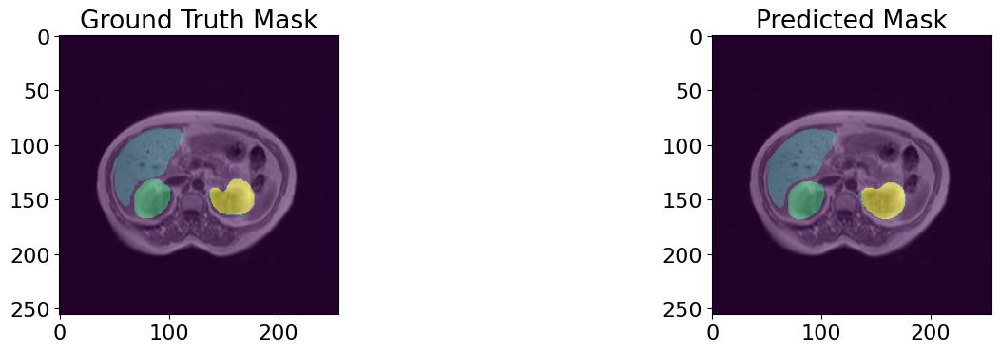

63/63 - 34s - loss: 0.0060 - accuracy: 0.9975 - mean_iou: 0.9413 - val_loss: 0.0527 - val_accuracy: 0.9888 - val_mean_iou: 0.7833 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 63/1000


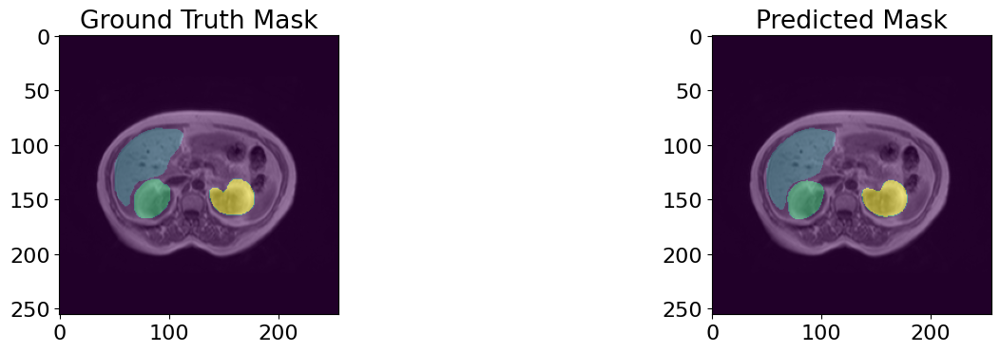

63/63 - 34s - loss: 0.0055 - accuracy: 0.9977 - mean_iou: 0.9441 - val_loss: 0.0542 - val_accuracy: 0.9889 - val_mean_iou: 0.7814 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 64/1000


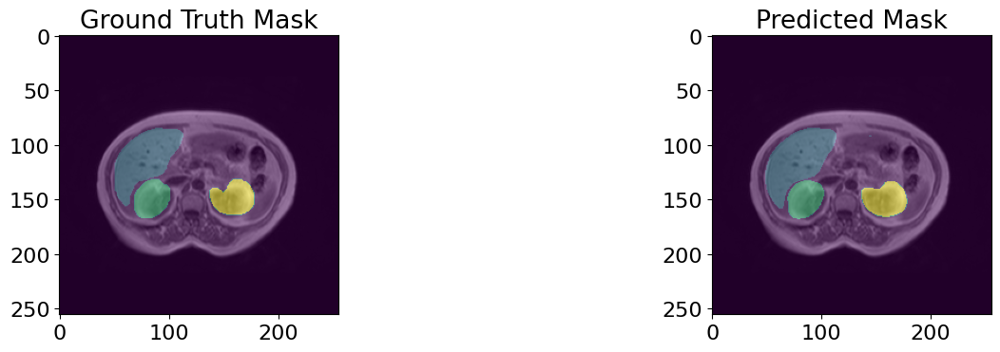

63/63 - 34s - loss: 0.0054 - accuracy: 0.9977 - mean_iou: 0.9472 - val_loss: 0.0531 - val_accuracy: 0.9887 - val_mean_iou: 0.7865 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 65/1000


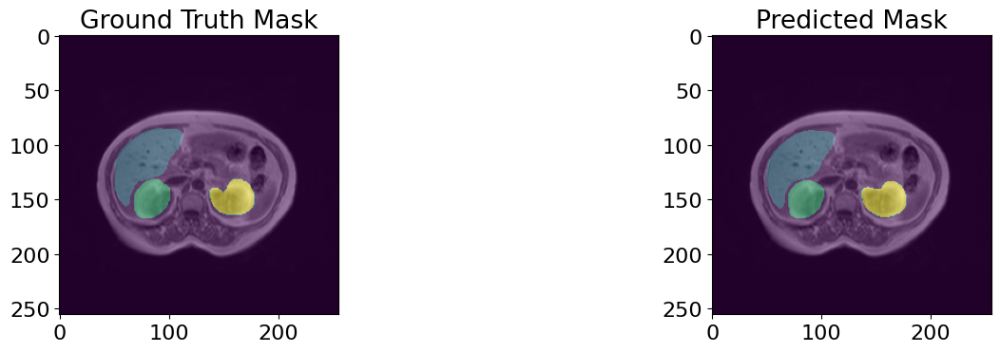

63/63 - 34s - loss: 0.0053 - accuracy: 0.9978 - mean_iou: 0.9474 - val_loss: 0.0586 - val_accuracy: 0.9883 - val_mean_iou: 0.7753 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 66/1000


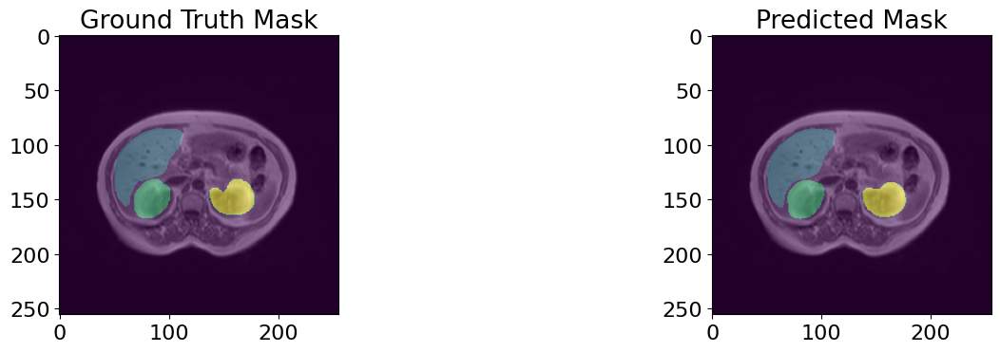

63/63 - 34s - loss: 0.0052 - accuracy: 0.9978 - mean_iou: 0.9485 - val_loss: 0.0555 - val_accuracy: 0.9886 - val_mean_iou: 0.7789 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 67/1000


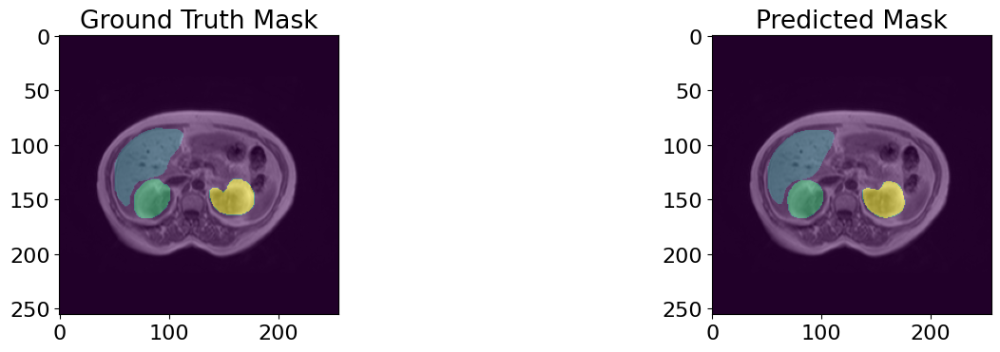

63/63 - 34s - loss: 0.0057 - accuracy: 0.9976 - mean_iou: 0.9432 - val_loss: 0.0616 - val_accuracy: 0.9888 - val_mean_iou: 0.7676 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 68/1000


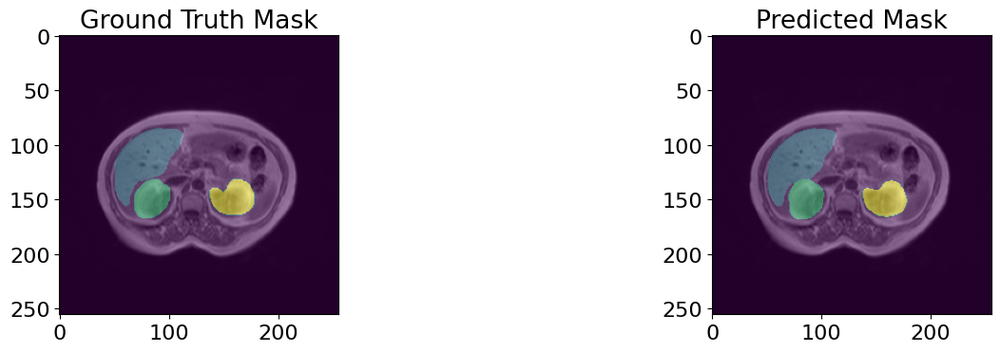

63/63 - 34s - loss: 0.0076 - accuracy: 0.9968 - mean_iou: 0.9274 - val_loss: 0.0519 - val_accuracy: 0.9885 - val_mean_iou: 0.7741 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 69/1000


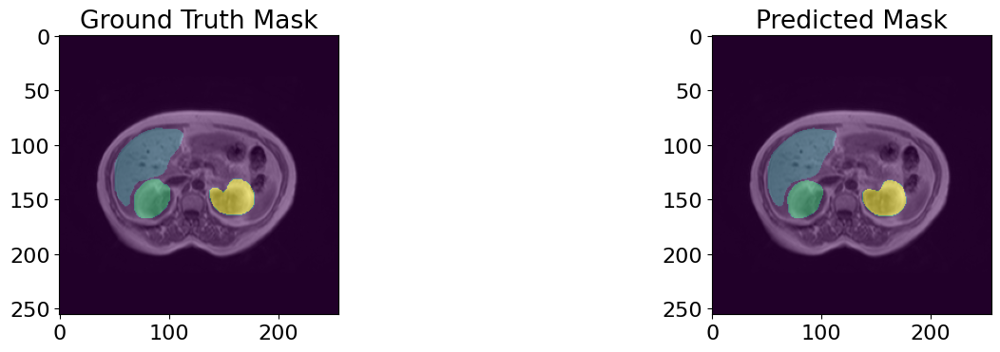

63/63 - 34s - loss: 0.0057 - accuracy: 0.9976 - mean_iou: 0.9419 - val_loss: 0.0551 - val_accuracy: 0.9886 - val_mean_iou: 0.7827 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 70/1000


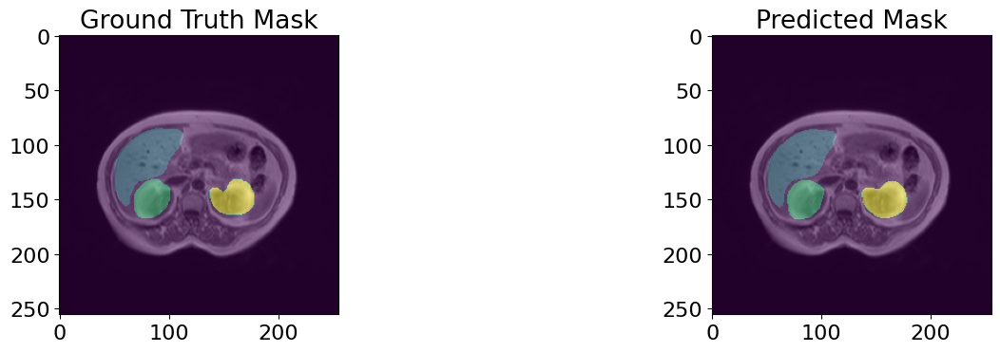

63/63 - 35s - loss: 0.0052 - accuracy: 0.9978 - mean_iou: 0.9471 - val_loss: 0.0558 - val_accuracy: 0.9886 - val_mean_iou: 0.7855 - lr: 0.0010 - 35s/epoch - 549ms/step
Epoch 71/1000


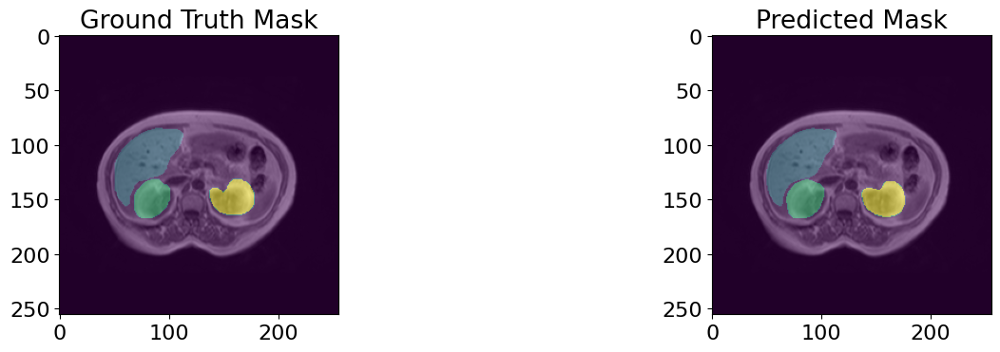

63/63 - 34s - loss: 0.0046 - accuracy: 0.9980 - mean_iou: 0.9525 - val_loss: 0.0550 - val_accuracy: 0.9891 - val_mean_iou: 0.7908 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 72/1000


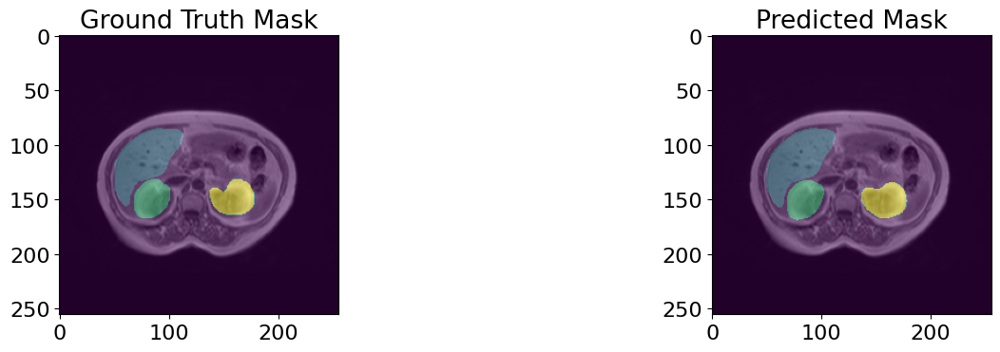

63/63 - 34s - loss: 0.0045 - accuracy: 0.9981 - mean_iou: 0.9527 - val_loss: 0.0618 - val_accuracy: 0.9882 - val_mean_iou: 0.7770 - lr: 0.0010 - 34s/epoch - 541ms/step
Epoch 73/1000


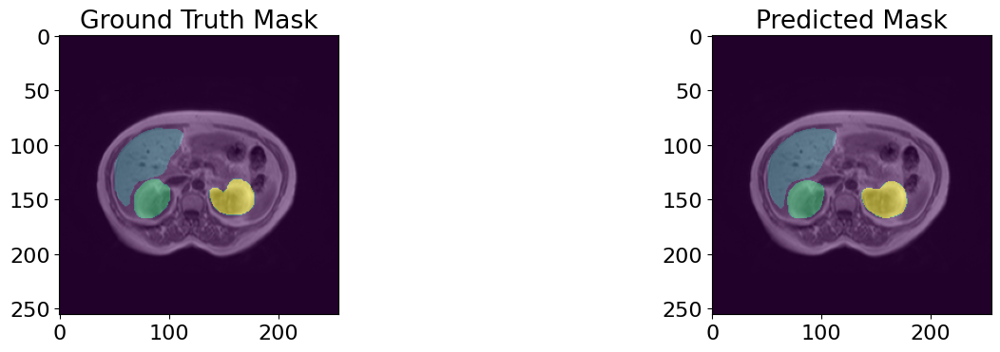

63/63 - 34s - loss: 0.0043 - accuracy: 0.9982 - mean_iou: 0.9558 - val_loss: 0.0593 - val_accuracy: 0.9886 - val_mean_iou: 0.7822 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 74/1000


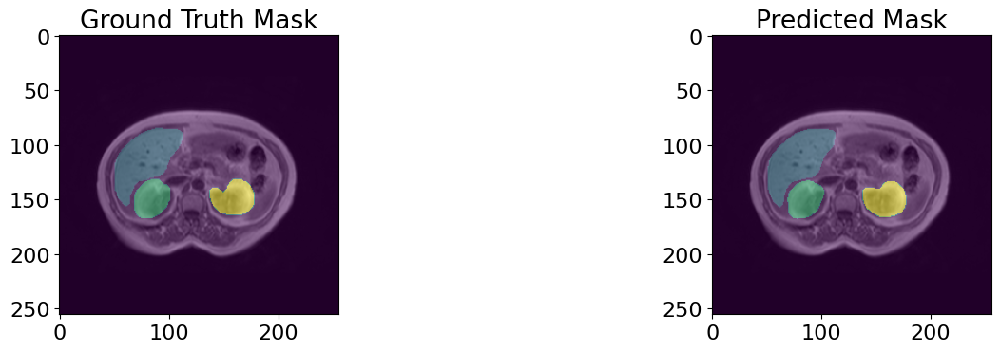

63/63 - 34s - loss: 0.0041 - accuracy: 0.9983 - mean_iou: 0.9581 - val_loss: 0.0577 - val_accuracy: 0.9891 - val_mean_iou: 0.7931 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 75/1000


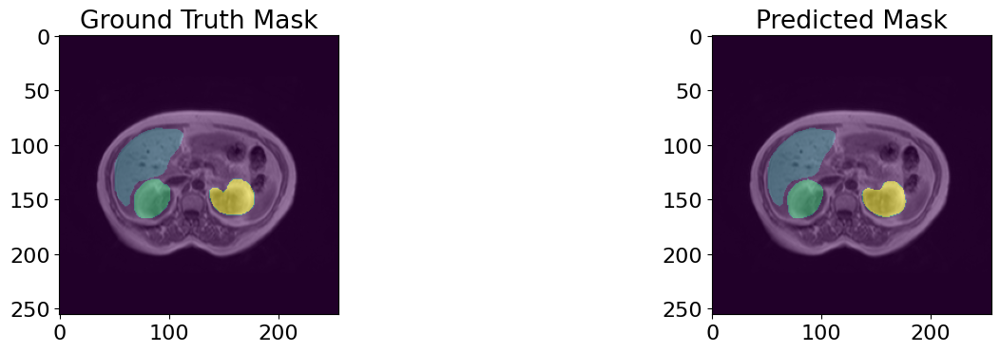

63/63 - 34s - loss: 0.0042 - accuracy: 0.9982 - mean_iou: 0.9562 - val_loss: 0.0609 - val_accuracy: 0.9892 - val_mean_iou: 0.7871 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 76/1000


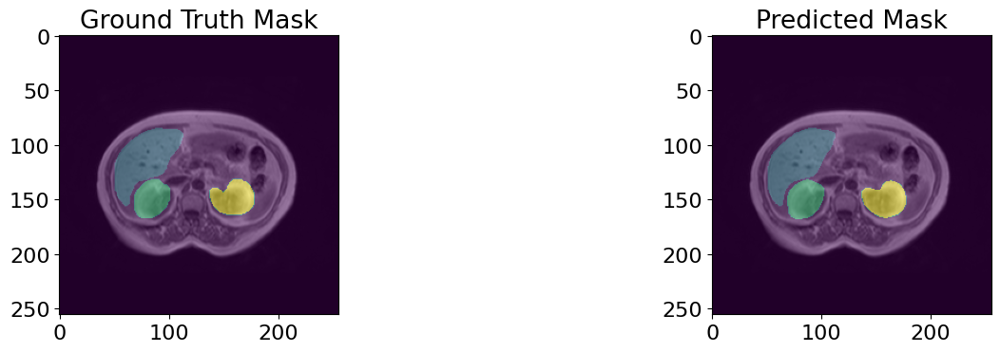

63/63 - 34s - loss: 0.0040 - accuracy: 0.9983 - mean_iou: 0.9591 - val_loss: 0.0622 - val_accuracy: 0.9892 - val_mean_iou: 0.7865 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 77/1000


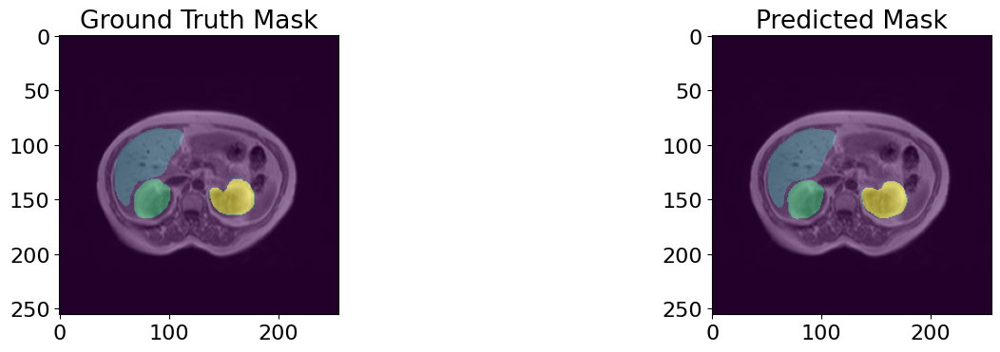

63/63 - 34s - loss: 0.0040 - accuracy: 0.9983 - mean_iou: 0.9575 - val_loss: 0.0661 - val_accuracy: 0.9887 - val_mean_iou: 0.7812 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 78/1000


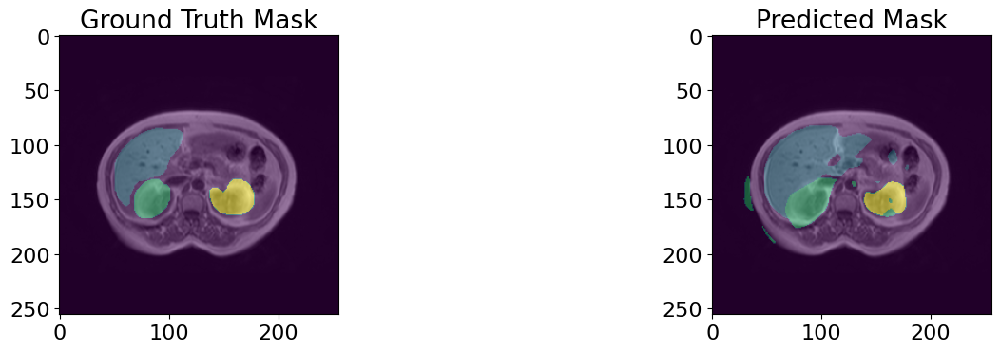

63/63 - 34s - loss: 0.0101 - accuracy: 0.9961 - mean_iou: 0.9223 - val_loss: 0.1634 - val_accuracy: 0.9561 - val_mean_iou: 0.5648 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 79/1000


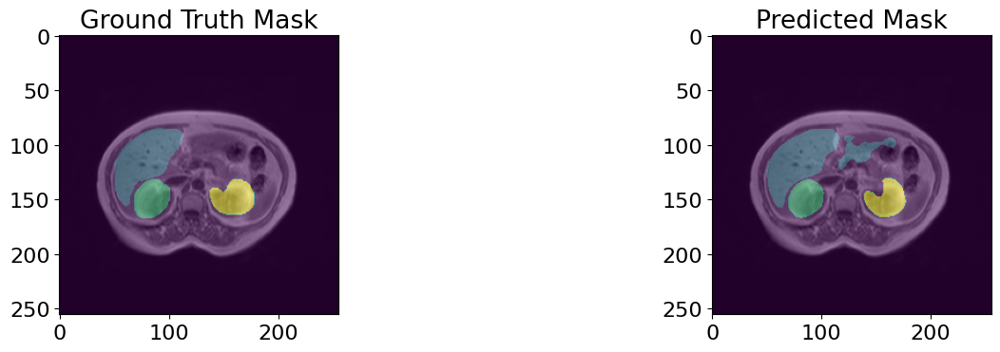

63/63 - 34s - loss: 0.0179 - accuracy: 0.9930 - mean_iou: 0.8532 - val_loss: 0.0877 - val_accuracy: 0.9805 - val_mean_iou: 0.6529 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 80/1000


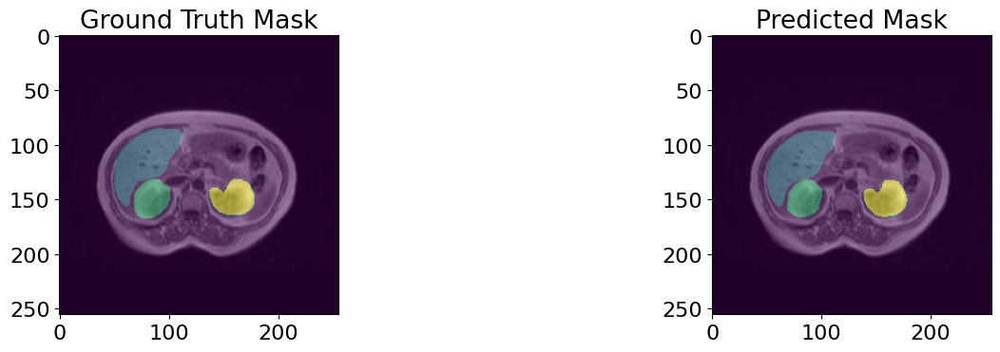

63/63 - 34s - loss: 0.0115 - accuracy: 0.9953 - mean_iou: 0.8973 - val_loss: 0.0511 - val_accuracy: 0.9882 - val_mean_iou: 0.7713 - lr: 0.0010 - 34s/epoch - 545ms/step
Epoch 81/1000


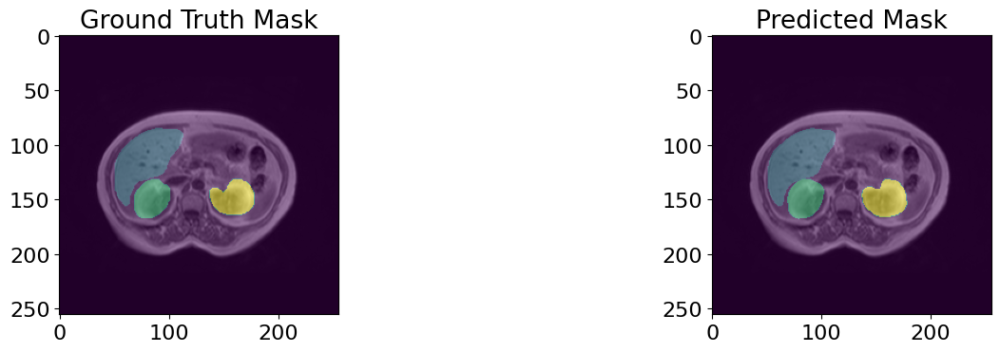

63/63 - 34s - loss: 0.0060 - accuracy: 0.9975 - mean_iou: 0.9394 - val_loss: 0.0522 - val_accuracy: 0.9888 - val_mean_iou: 0.7809 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 82/1000


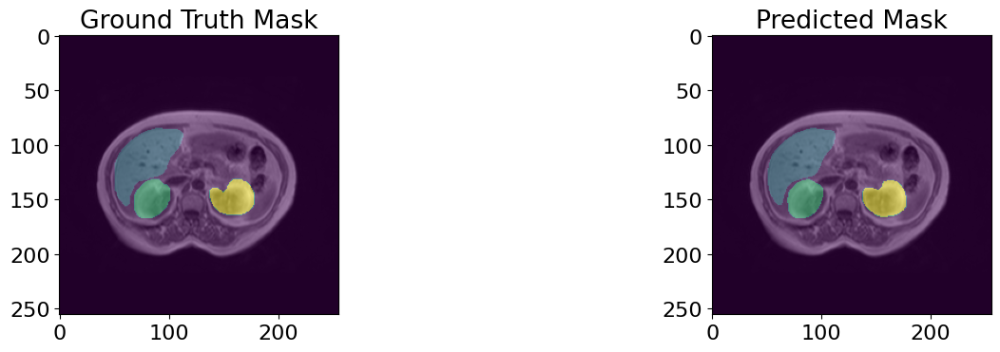

63/63 - 34s - loss: 0.0045 - accuracy: 0.9981 - mean_iou: 0.9542 - val_loss: 0.0519 - val_accuracy: 0.9889 - val_mean_iou: 0.7837 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 83/1000


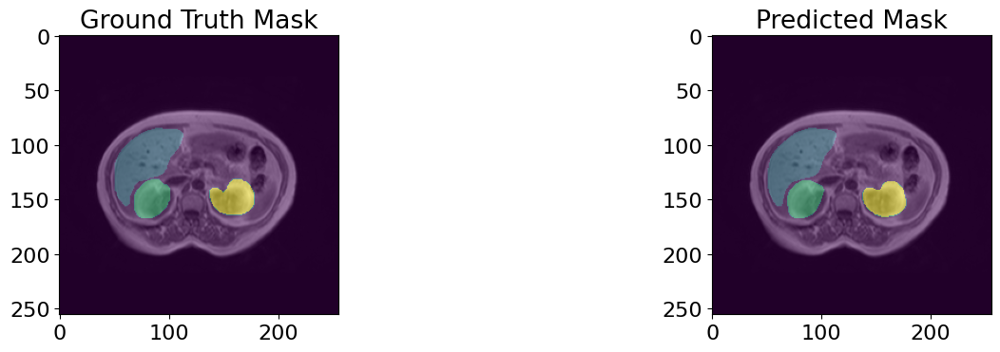

63/63 - 34s - loss: 0.0037 - accuracy: 0.9984 - mean_iou: 0.9615 - val_loss: 0.0589 - val_accuracy: 0.9891 - val_mean_iou: 0.7793 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 84/1000


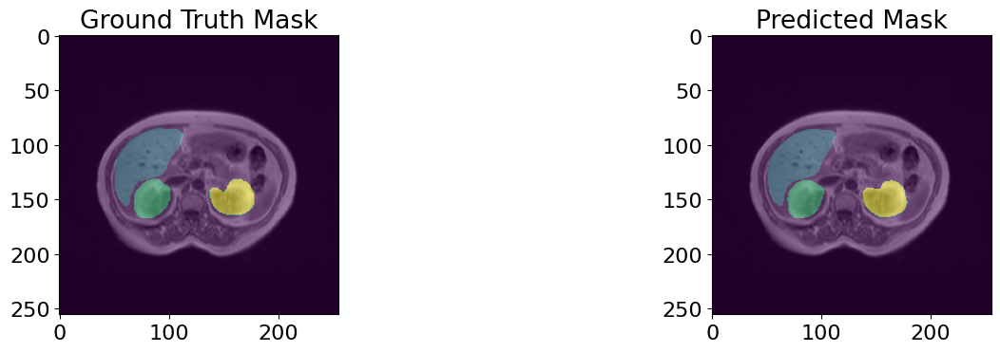

63/63 - 34s - loss: 0.0035 - accuracy: 0.9985 - mean_iou: 0.9644 - val_loss: 0.0587 - val_accuracy: 0.9887 - val_mean_iou: 0.7796 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 85/1000


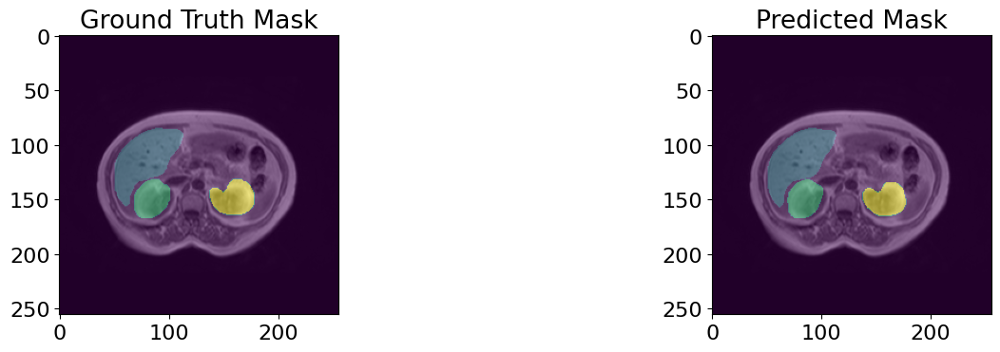

63/63 - 34s - loss: 0.0034 - accuracy: 0.9986 - mean_iou: 0.9656 - val_loss: 0.0607 - val_accuracy: 0.9887 - val_mean_iou: 0.7810 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 86/1000


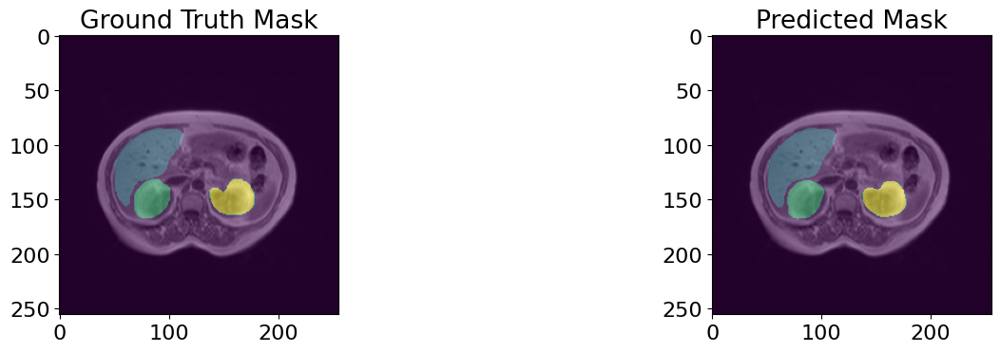

63/63 - 34s - loss: 0.0032 - accuracy: 0.9987 - mean_iou: 0.9673 - val_loss: 0.0635 - val_accuracy: 0.9888 - val_mean_iou: 0.7792 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 87/1000


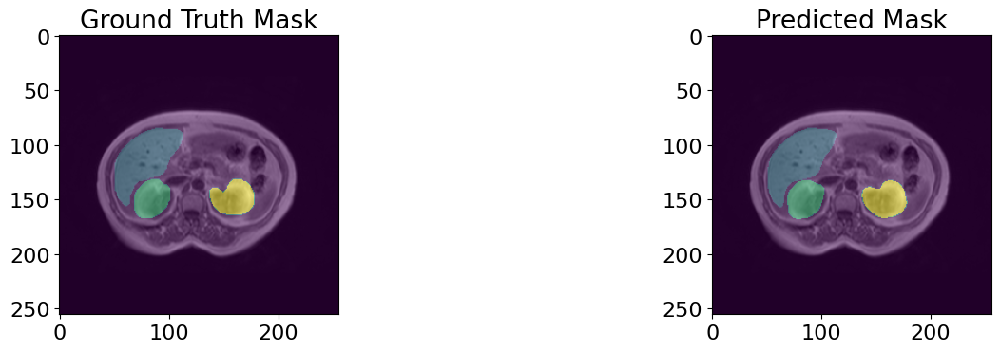

63/63 - 34s - loss: 0.0030 - accuracy: 0.9987 - mean_iou: 0.9686 - val_loss: 0.0623 - val_accuracy: 0.9889 - val_mean_iou: 0.7832 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 88/1000


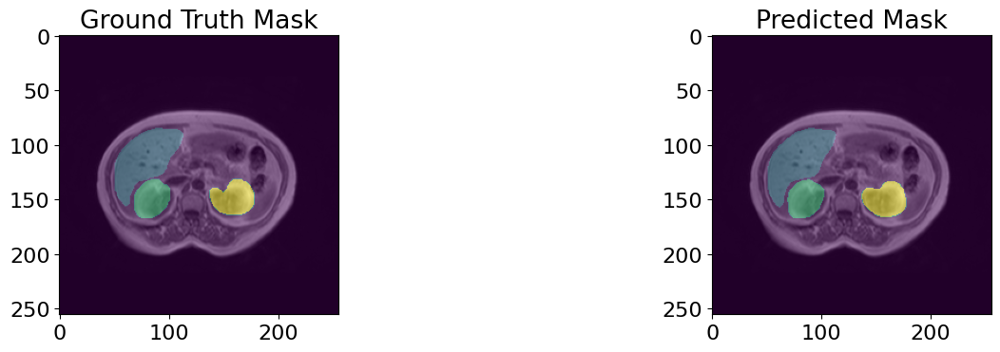

63/63 - 34s - loss: 0.0031 - accuracy: 0.9987 - mean_iou: 0.9677 - val_loss: 0.0638 - val_accuracy: 0.9889 - val_mean_iou: 0.7847 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 89/1000


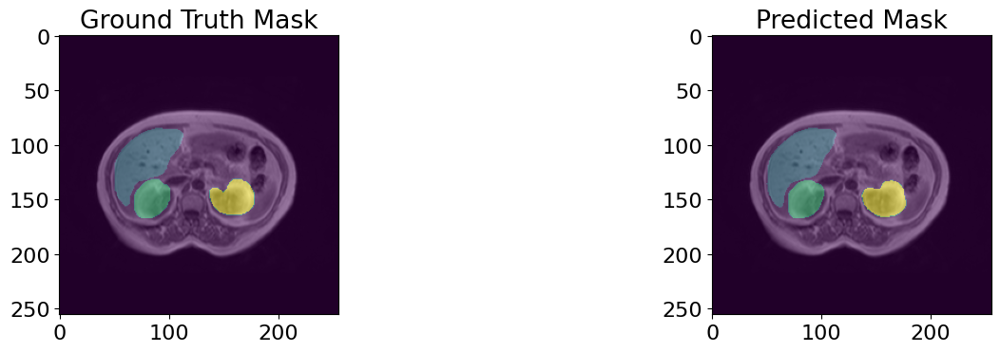

63/63 - 34s - loss: 0.0031 - accuracy: 0.9987 - mean_iou: 0.9676 - val_loss: 0.0621 - val_accuracy: 0.9891 - val_mean_iou: 0.7881 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 90/1000


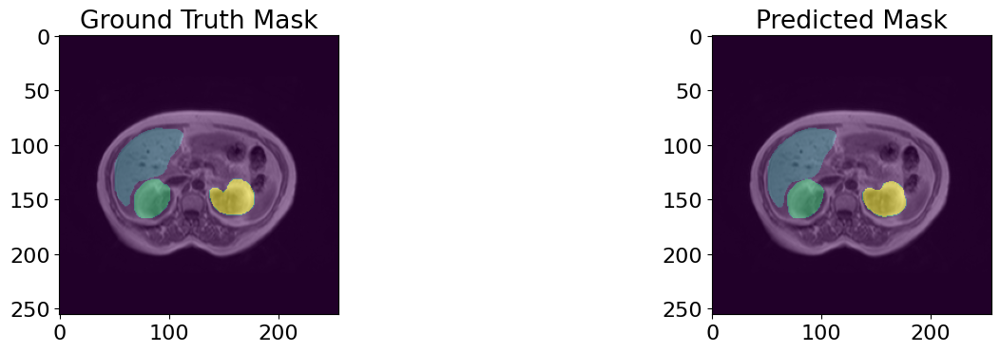

63/63 - 34s - loss: 0.0029 - accuracy: 0.9988 - mean_iou: 0.9693 - val_loss: 0.0678 - val_accuracy: 0.9890 - val_mean_iou: 0.7836 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 91/1000


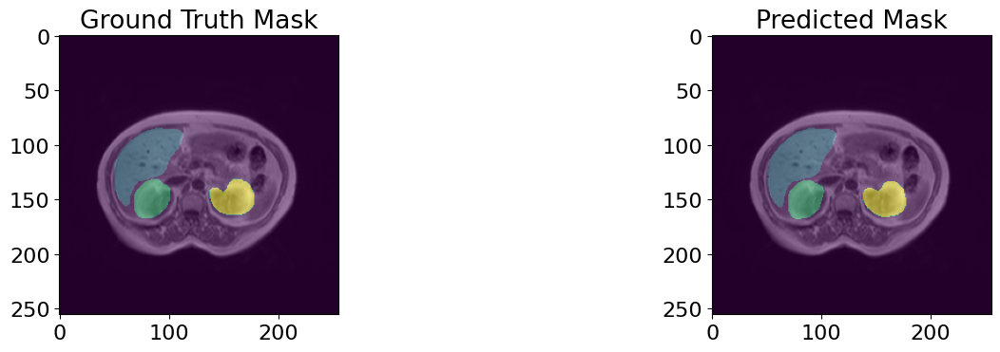

63/63 - 34s - loss: 0.0029 - accuracy: 0.9988 - mean_iou: 0.9697 - val_loss: 0.0674 - val_accuracy: 0.9888 - val_mean_iou: 0.7826 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 92/1000


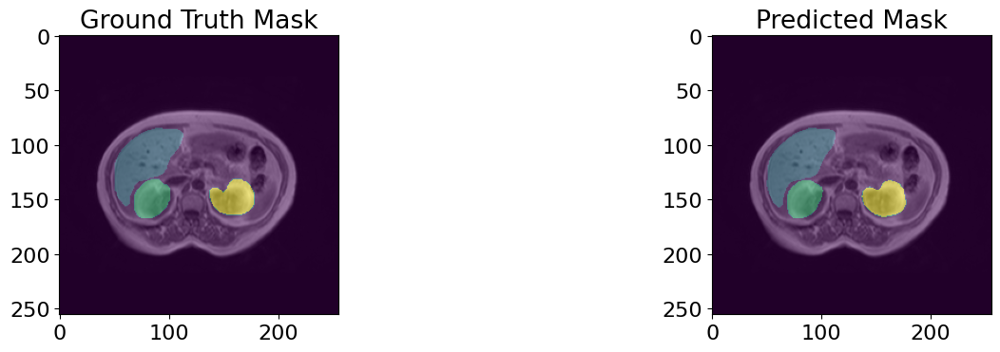

63/63 - 34s - loss: 0.0029 - accuracy: 0.9988 - mean_iou: 0.9696 - val_loss: 0.0688 - val_accuracy: 0.9887 - val_mean_iou: 0.7783 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 93/1000


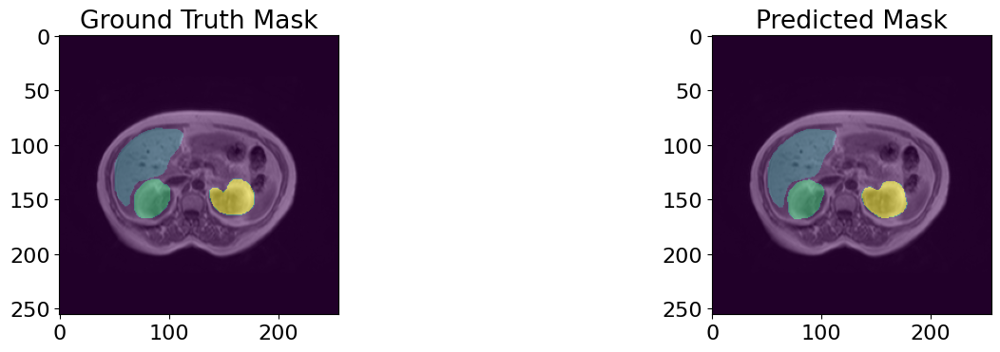

63/63 - 34s - loss: 0.0029 - accuracy: 0.9988 - mean_iou: 0.9699 - val_loss: 0.0699 - val_accuracy: 0.9889 - val_mean_iou: 0.7839 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 94/1000


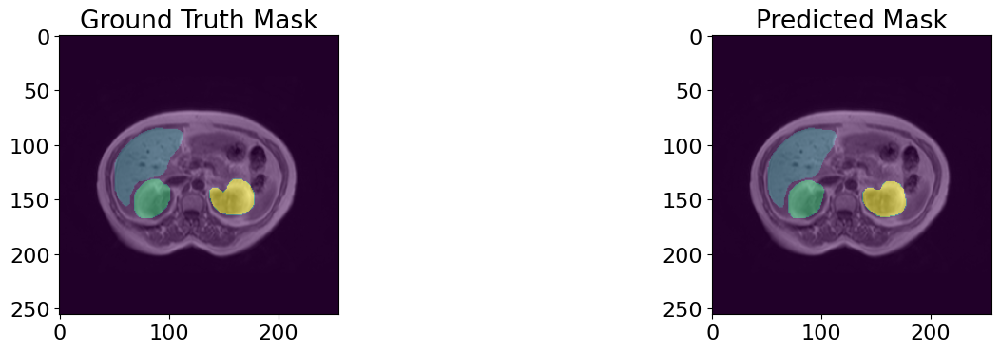

63/63 - 34s - loss: 0.0028 - accuracy: 0.9988 - mean_iou: 0.9704 - val_loss: 0.0688 - val_accuracy: 0.9890 - val_mean_iou: 0.7817 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 95/1000


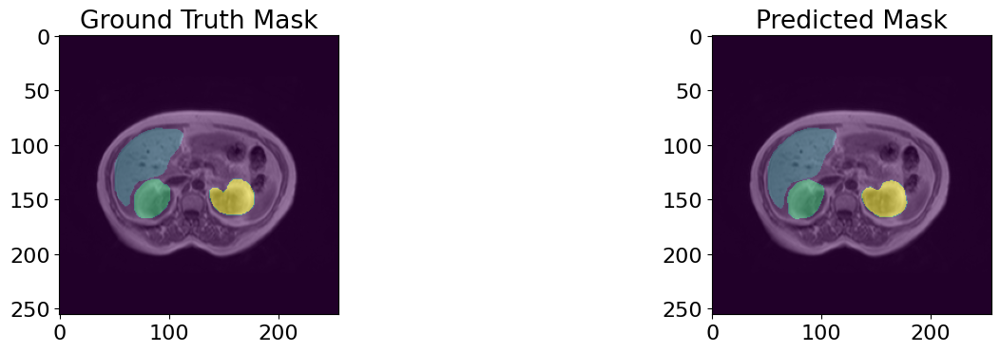

63/63 - 34s - loss: 0.0027 - accuracy: 0.9989 - mean_iou: 0.9722 - val_loss: 0.0731 - val_accuracy: 0.9885 - val_mean_iou: 0.7783 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 96/1000


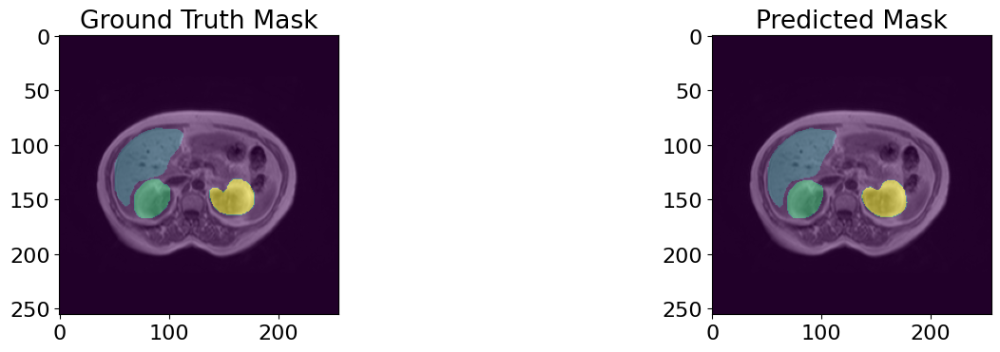

63/63 - 34s - loss: 0.0028 - accuracy: 0.9988 - mean_iou: 0.9708 - val_loss: 0.0669 - val_accuracy: 0.9891 - val_mean_iou: 0.7841 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 97/1000


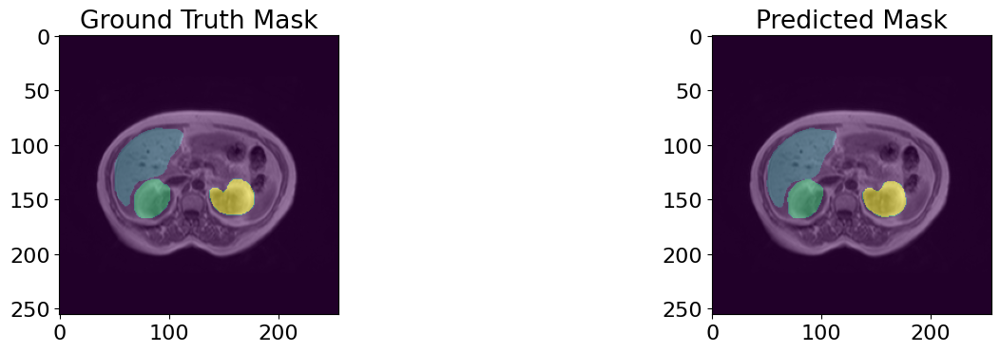

63/63 - 35s - loss: 0.0028 - accuracy: 0.9988 - mean_iou: 0.9694 - val_loss: 0.0698 - val_accuracy: 0.9890 - val_mean_iou: 0.7849 - lr: 0.0010 - 35s/epoch - 550ms/step
Epoch 98/1000


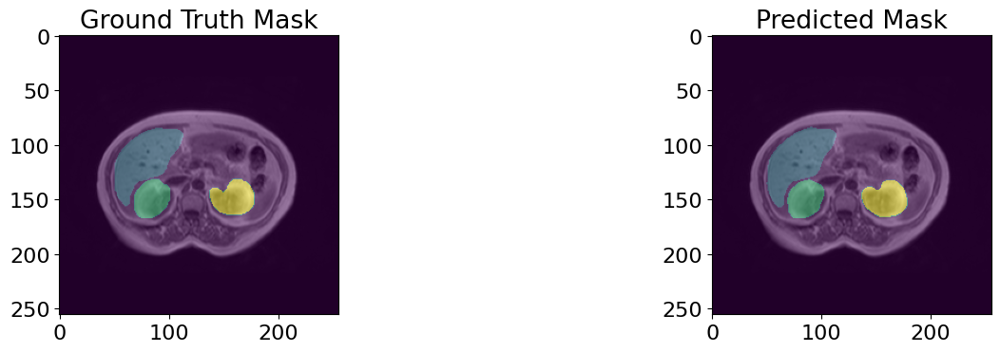

63/63 - 34s - loss: 0.0026 - accuracy: 0.9989 - mean_iou: 0.9729 - val_loss: 0.0688 - val_accuracy: 0.9889 - val_mean_iou: 0.7824 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 99/1000


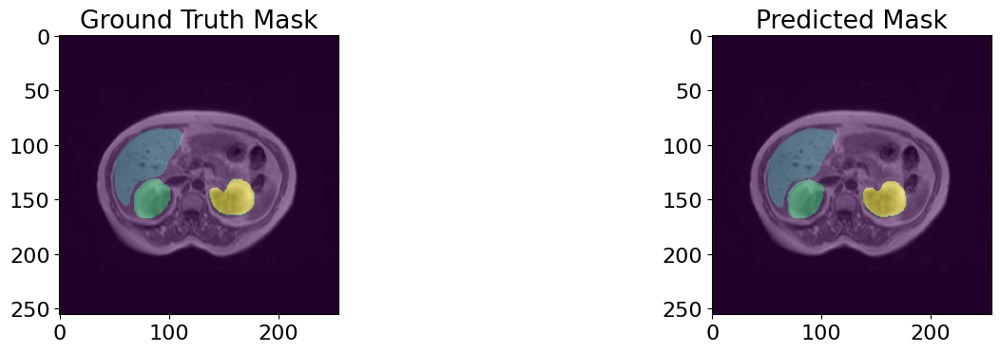

63/63 - 34s - loss: 0.0025 - accuracy: 0.9990 - mean_iou: 0.9732 - val_loss: 0.0731 - val_accuracy: 0.9890 - val_mean_iou: 0.7824 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 100/1000


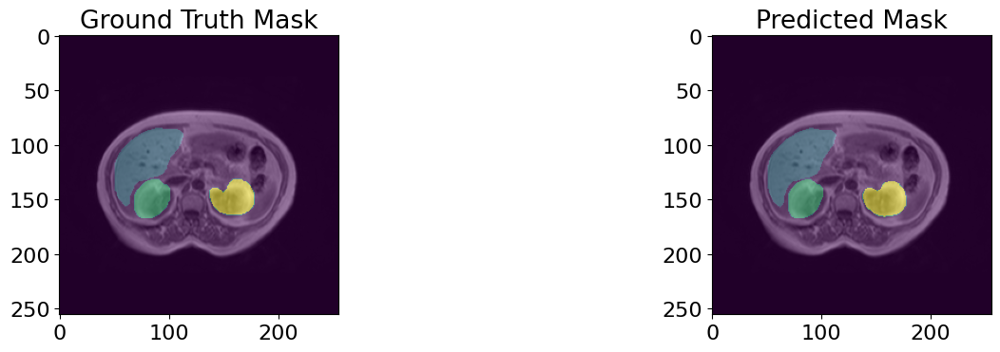

63/63 - 34s - loss: 0.0025 - accuracy: 0.9989 - mean_iou: 0.9733 - val_loss: 0.0711 - val_accuracy: 0.9891 - val_mean_iou: 0.7847 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 101/1000


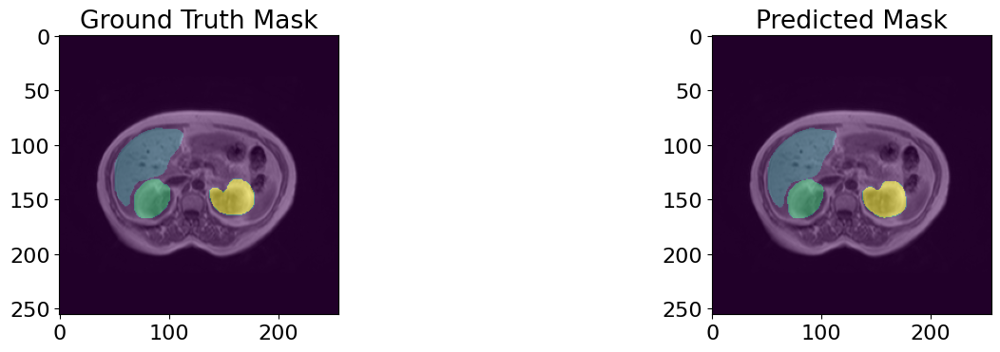

63/63 - 34s - loss: 0.0025 - accuracy: 0.9989 - mean_iou: 0.9737 - val_loss: 0.0715 - val_accuracy: 0.9892 - val_mean_iou: 0.7898 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 102/1000


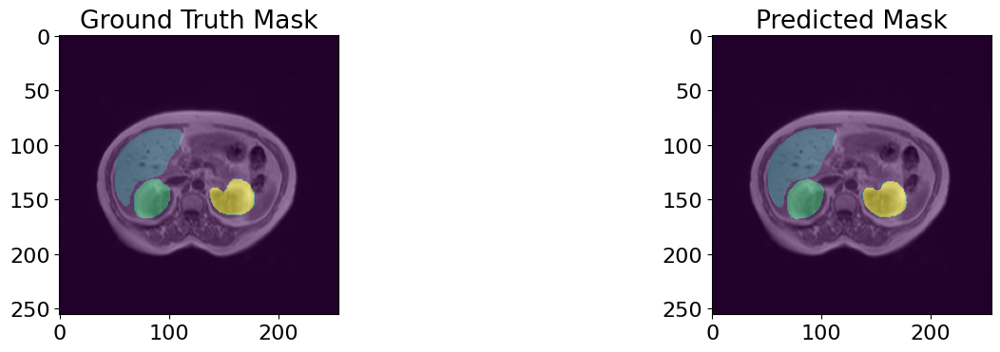

63/63 - 34s - loss: 0.0025 - accuracy: 0.9989 - mean_iou: 0.9738 - val_loss: 0.0715 - val_accuracy: 0.9886 - val_mean_iou: 0.7787 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 103/1000


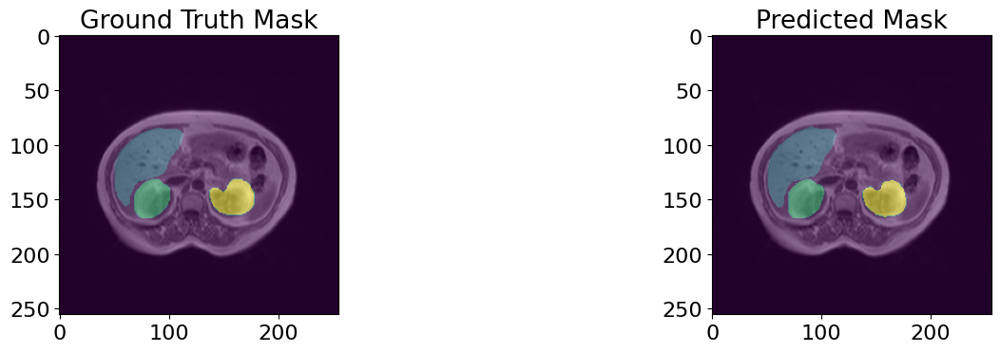

63/63 - 34s - loss: 0.0025 - accuracy: 0.9990 - mean_iou: 0.9740 - val_loss: 0.0708 - val_accuracy: 0.9891 - val_mean_iou: 0.7849 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 104/1000


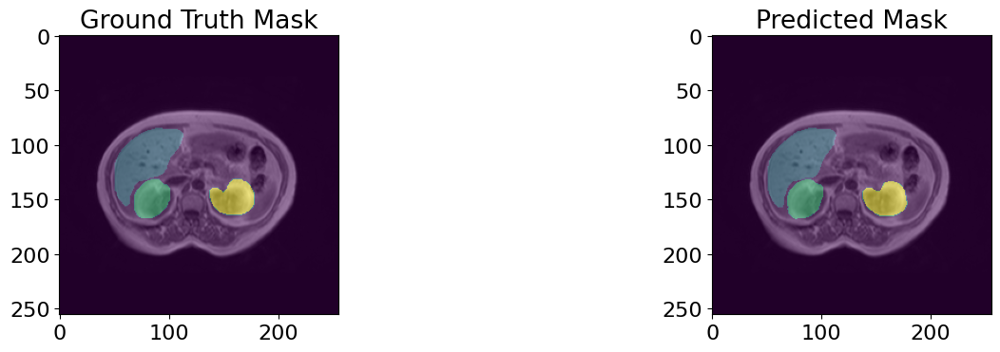

63/63 - 34s - loss: 0.0025 - accuracy: 0.9989 - mean_iou: 0.9738 - val_loss: 0.0743 - val_accuracy: 0.9889 - val_mean_iou: 0.7822 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 105/1000


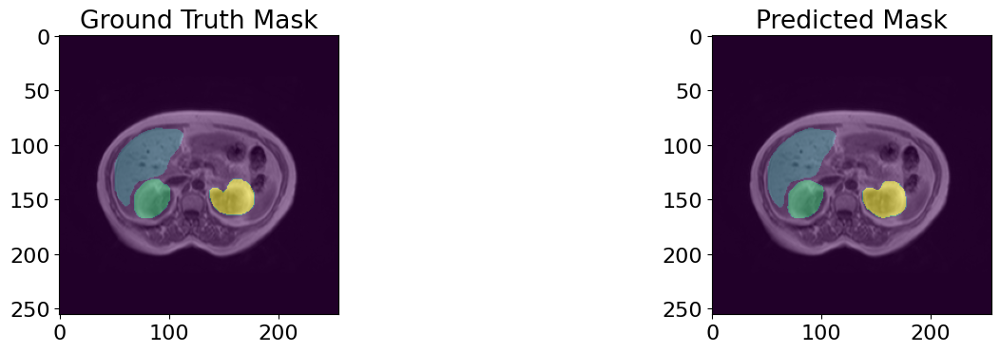

63/63 - 34s - loss: 0.0026 - accuracy: 0.9989 - mean_iou: 0.9731 - val_loss: 0.0717 - val_accuracy: 0.9889 - val_mean_iou: 0.7838 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 106/1000


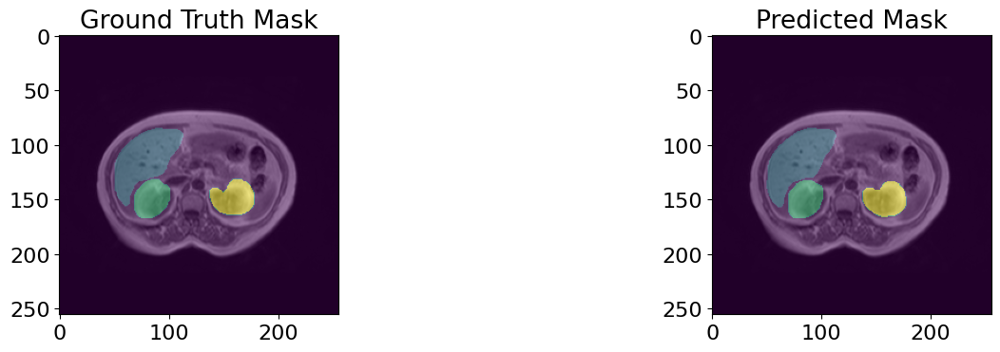

63/63 - 34s - loss: 0.0024 - accuracy: 0.9990 - mean_iou: 0.9746 - val_loss: 0.0768 - val_accuracy: 0.9889 - val_mean_iou: 0.7833 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 107/1000


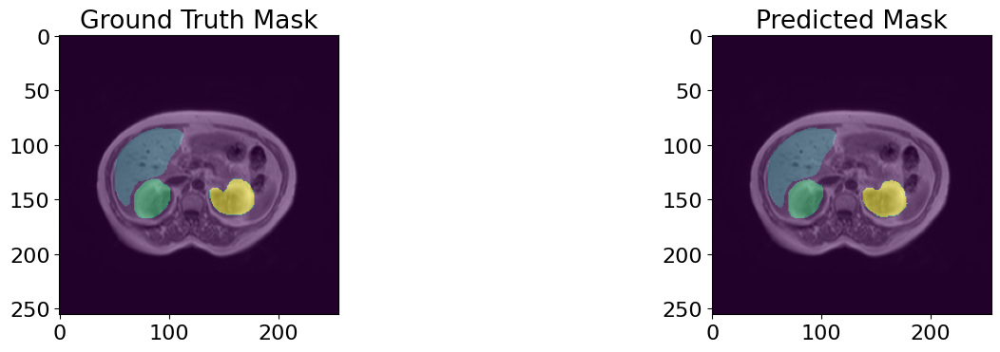

63/63 - 34s - loss: 0.0023 - accuracy: 0.9990 - mean_iou: 0.9758 - val_loss: 0.0751 - val_accuracy: 0.9890 - val_mean_iou: 0.7821 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 108/1000


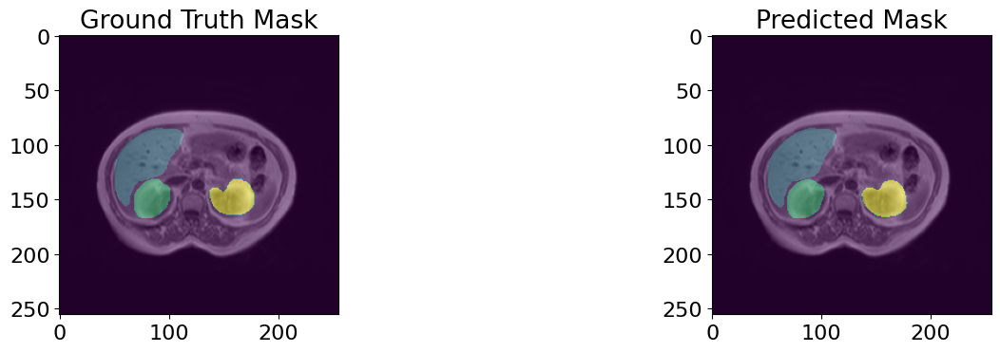

63/63 - 34s - loss: 0.0024 - accuracy: 0.9990 - mean_iou: 0.9755 - val_loss: 0.0763 - val_accuracy: 0.9888 - val_mean_iou: 0.7839 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 109/1000


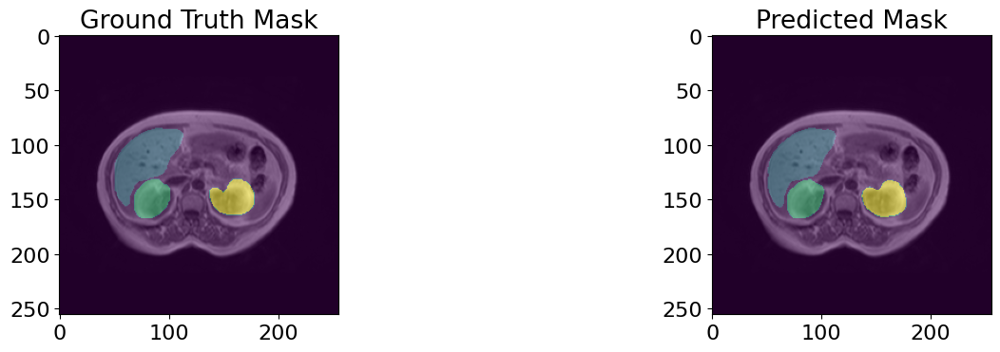

63/63 - 34s - loss: 0.0023 - accuracy: 0.9990 - mean_iou: 0.9761 - val_loss: 0.0765 - val_accuracy: 0.9893 - val_mean_iou: 0.7866 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 110/1000


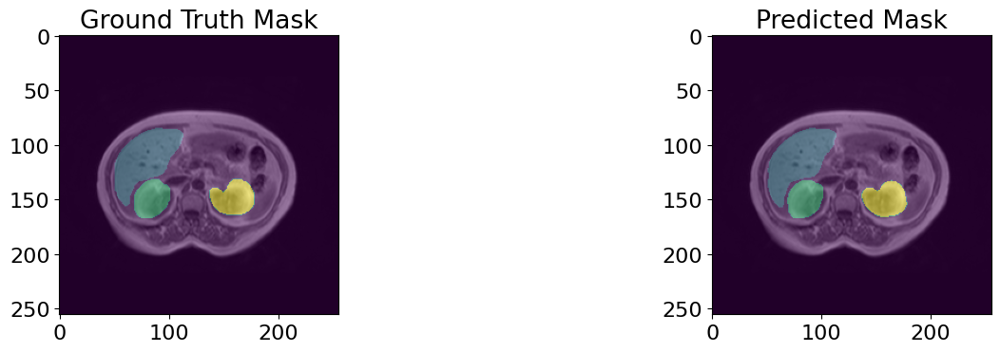

63/63 - 34s - loss: 0.0023 - accuracy: 0.9990 - mean_iou: 0.9756 - val_loss: 0.0750 - val_accuracy: 0.9891 - val_mean_iou: 0.7863 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 111/1000


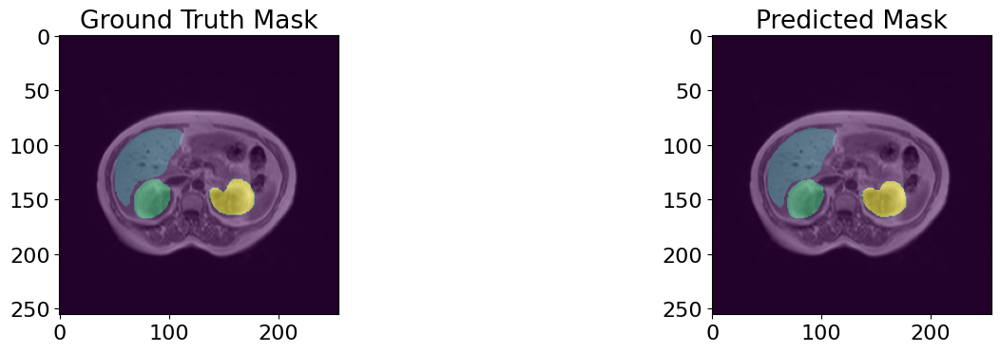

63/63 - 34s - loss: 0.0023 - accuracy: 0.9990 - mean_iou: 0.9755 - val_loss: 0.0766 - val_accuracy: 0.9892 - val_mean_iou: 0.7912 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 112/1000


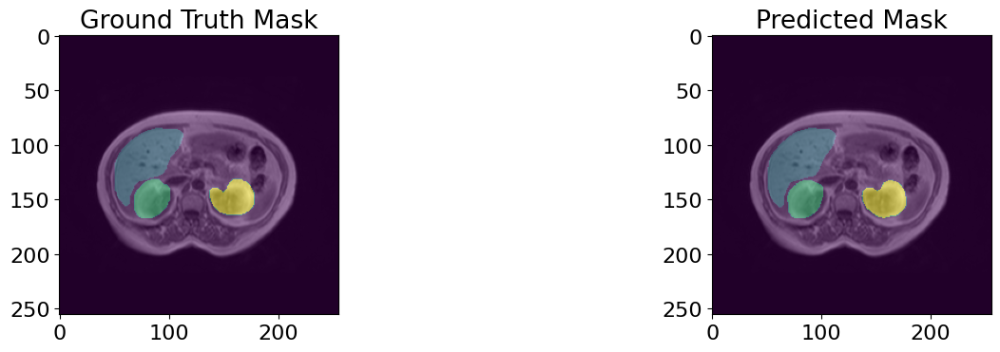

63/63 - 34s - loss: 0.0022 - accuracy: 0.9991 - mean_iou: 0.9775 - val_loss: 0.0739 - val_accuracy: 0.9891 - val_mean_iou: 0.7866 - lr: 0.0010 - 34s/epoch - 544ms/step
Epoch 113/1000


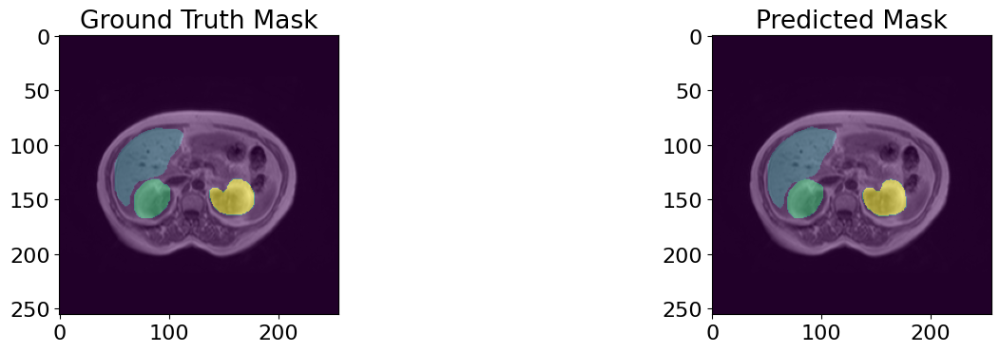

63/63 - 34s - loss: 0.0028 - accuracy: 0.9989 - mean_iou: 0.9731 - val_loss: 0.0762 - val_accuracy: 0.9885 - val_mean_iou: 0.7813 - lr: 0.0010 - 34s/epoch - 543ms/step
Epoch 114/1000


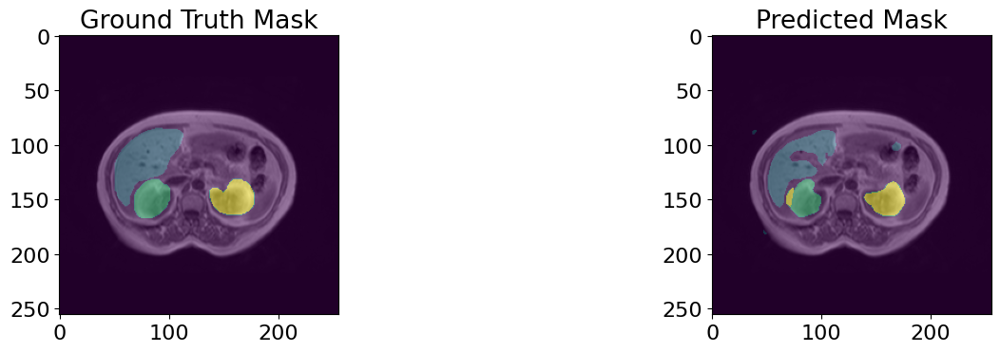

63/63 - 34s - loss: 0.0207 - accuracy: 0.9926 - mean_iou: 0.8529 - val_loss: 0.1558 - val_accuracy: 0.9726 - val_mean_iou: 0.5511 - lr: 0.0010 - 34s/epoch - 542ms/step
Epoch 115/1000


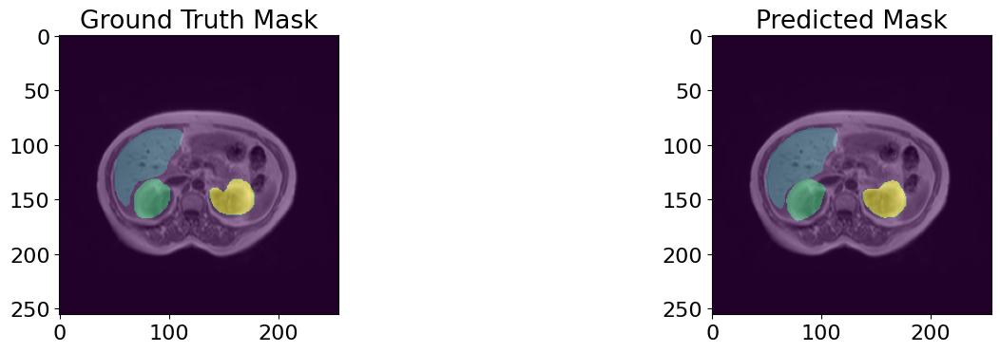

63/63 - 34s - loss: 0.0113 - accuracy: 0.9955 - mean_iou: 0.8985 - val_loss: 0.0508 - val_accuracy: 0.9874 - val_mean_iou: 0.7632 - lr: 1.0000e-04 - 34s/epoch - 543ms/step
Epoch 116/1000


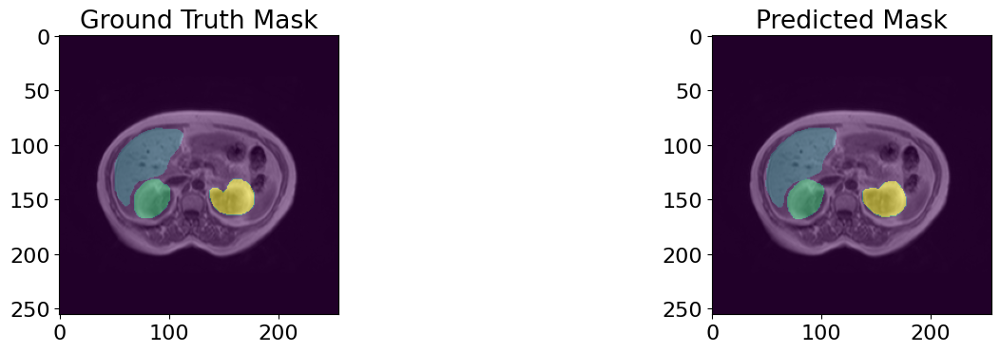

63/63 - 34s - loss: 0.0066 - accuracy: 0.9973 - mean_iou: 0.9362 - val_loss: 0.0414 - val_accuracy: 0.9893 - val_mean_iou: 0.7854 - lr: 1.0000e-04 - 34s/epoch - 542ms/step
Epoch 117/1000


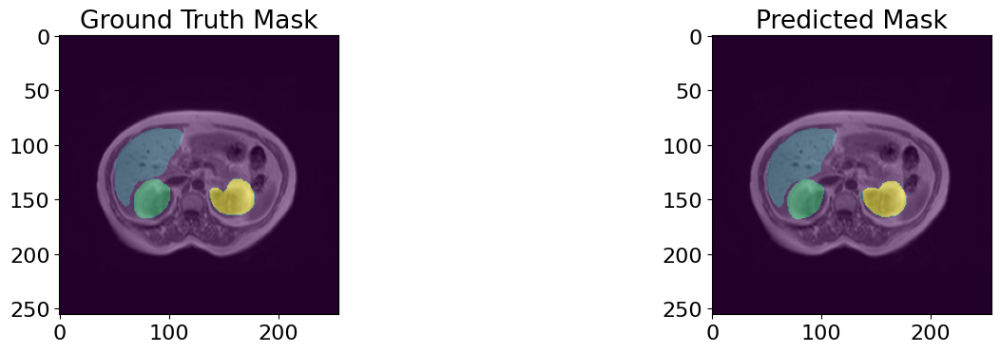

63/63 - 34s - loss: 0.0053 - accuracy: 0.9978 - mean_iou: 0.9478 - val_loss: 0.0406 - val_accuracy: 0.9896 - val_mean_iou: 0.7903 - lr: 1.0000e-04 - 34s/epoch - 542ms/step
Epoch 118/1000


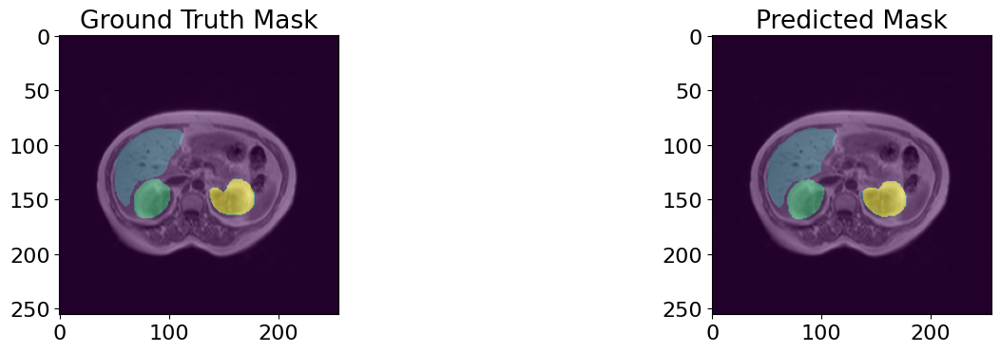

63/63 - 34s - loss: 0.0046 - accuracy: 0.9981 - mean_iou: 0.9542 - val_loss: 0.0426 - val_accuracy: 0.9896 - val_mean_iou: 0.7900 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 119/1000


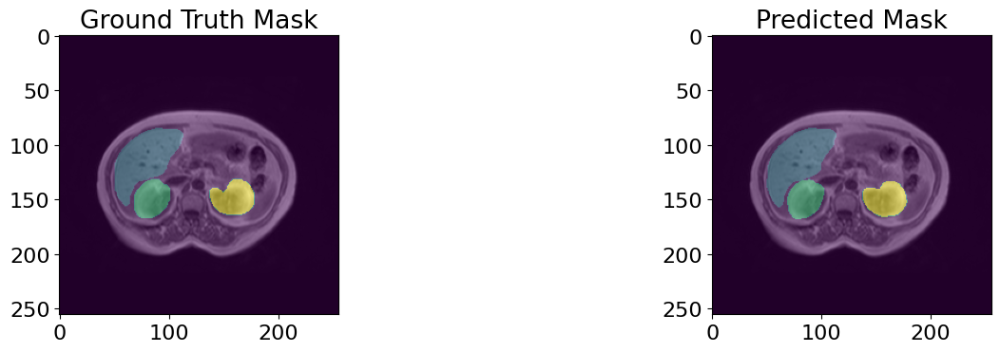

63/63 - 34s - loss: 0.0040 - accuracy: 0.9983 - mean_iou: 0.9595 - val_loss: 0.0439 - val_accuracy: 0.9897 - val_mean_iou: 0.7921 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 120/1000


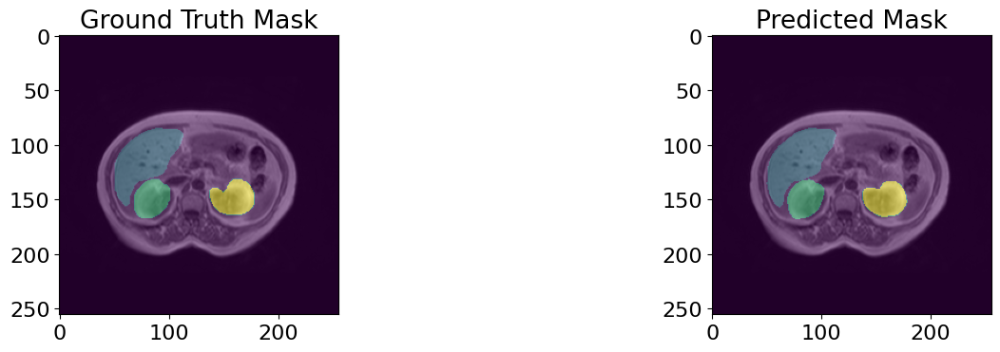

63/63 - 34s - loss: 0.0036 - accuracy: 0.9985 - mean_iou: 0.9631 - val_loss: 0.0456 - val_accuracy: 0.9897 - val_mean_iou: 0.7926 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 121/1000


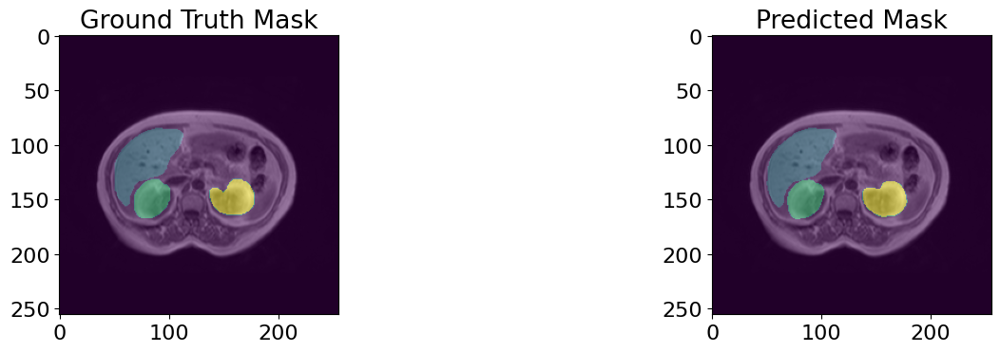

63/63 - 34s - loss: 0.0033 - accuracy: 0.9986 - mean_iou: 0.9665 - val_loss: 0.0478 - val_accuracy: 0.9897 - val_mean_iou: 0.7920 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 122/1000


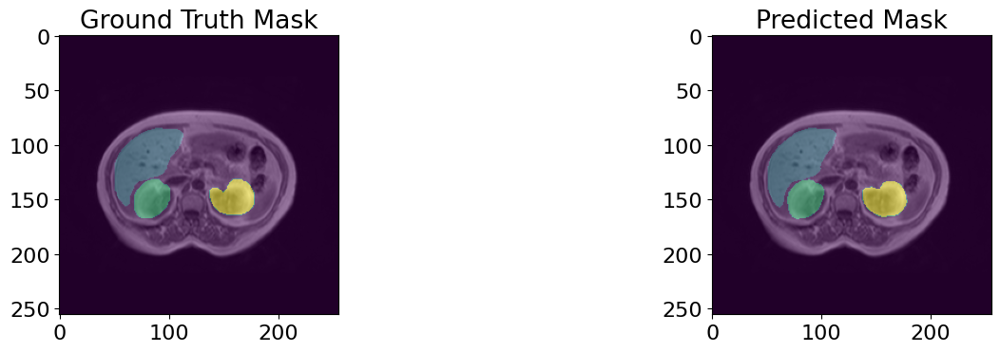

63/63 - 34s - loss: 0.0031 - accuracy: 0.9987 - mean_iou: 0.9688 - val_loss: 0.0490 - val_accuracy: 0.9897 - val_mean_iou: 0.7925 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 123/1000


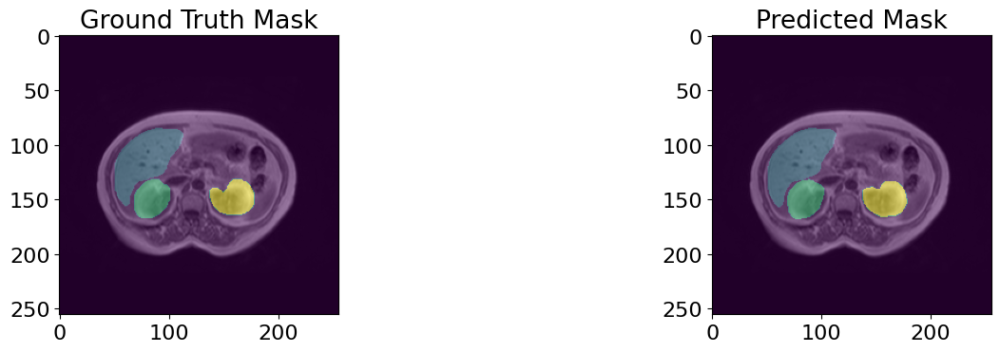

63/63 - 34s - loss: 0.0028 - accuracy: 0.9988 - mean_iou: 0.9716 - val_loss: 0.0506 - val_accuracy: 0.9897 - val_mean_iou: 0.7932 - lr: 1.0000e-04 - 34s/epoch - 543ms/step
Epoch 124/1000


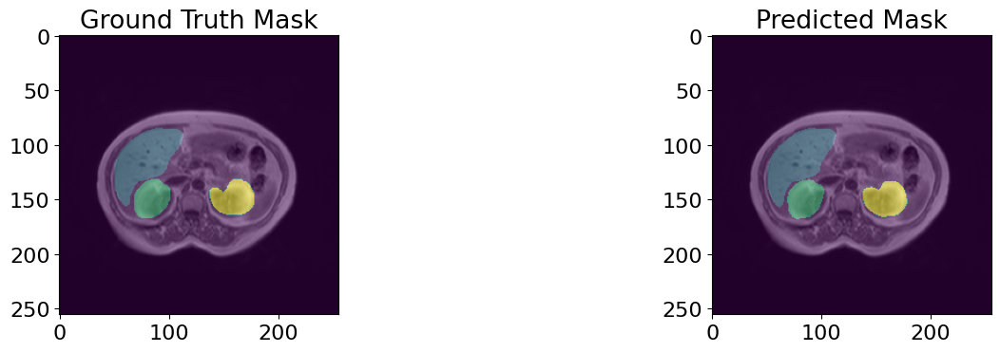

63/63 - 34s - loss: 0.0026 - accuracy: 0.9989 - mean_iou: 0.9734 - val_loss: 0.0522 - val_accuracy: 0.9898 - val_mean_iou: 0.7923 - lr: 1.0000e-04 - 34s/epoch - 542ms/step
Epoch 125/1000


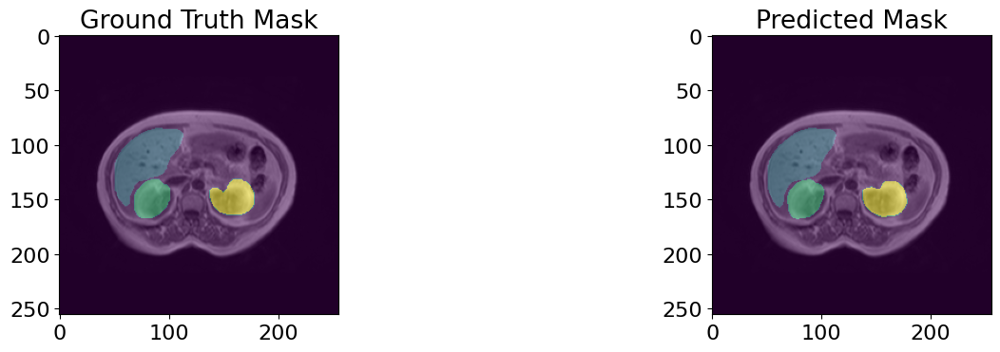

63/63 - 35s - loss: 0.0025 - accuracy: 0.9990 - mean_iou: 0.9748 - val_loss: 0.0534 - val_accuracy: 0.9898 - val_mean_iou: 0.7930 - lr: 1.0000e-04 - 35s/epoch - 548ms/step
Epoch 126/1000


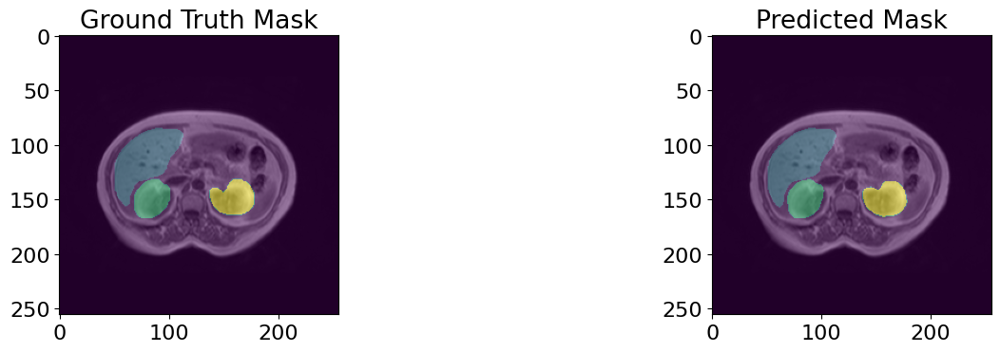

63/63 - 34s - loss: 0.0023 - accuracy: 0.9990 - mean_iou: 0.9760 - val_loss: 0.0555 - val_accuracy: 0.9898 - val_mean_iou: 0.7914 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 127/1000


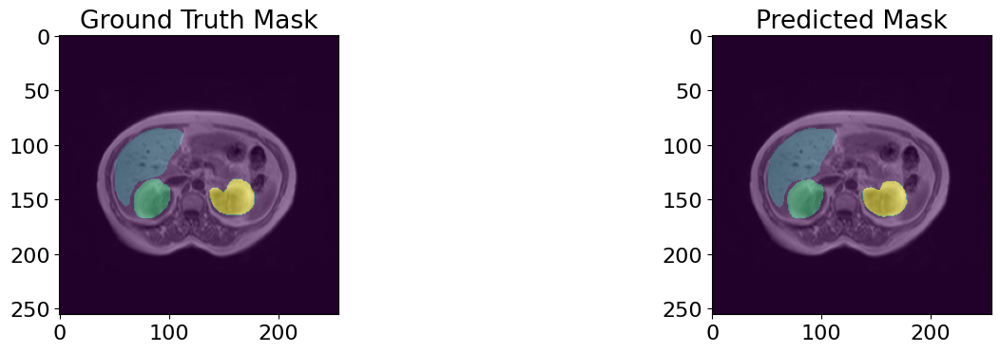

63/63 - 34s - loss: 0.0022 - accuracy: 0.9991 - mean_iou: 0.9773 - val_loss: 0.0571 - val_accuracy: 0.9898 - val_mean_iou: 0.7910 - lr: 1.0000e-04 - 34s/epoch - 543ms/step
Epoch 128/1000


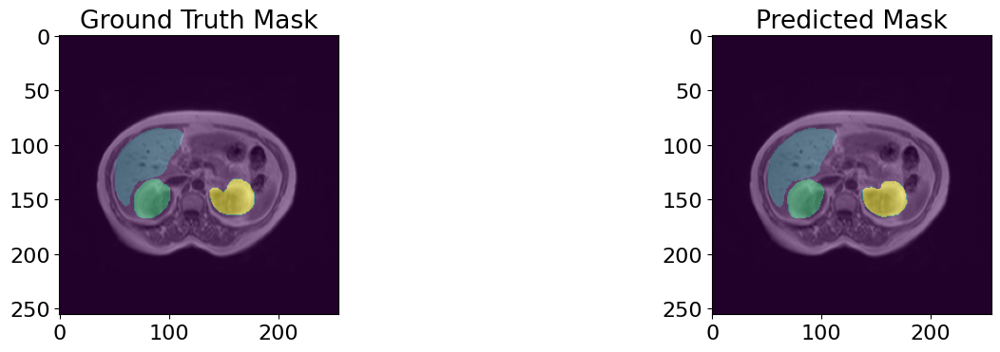

63/63 - 34s - loss: 0.0021 - accuracy: 0.9991 - mean_iou: 0.9782 - val_loss: 0.0579 - val_accuracy: 0.9897 - val_mean_iou: 0.7912 - lr: 1.0000e-04 - 34s/epoch - 543ms/step
Epoch 129/1000


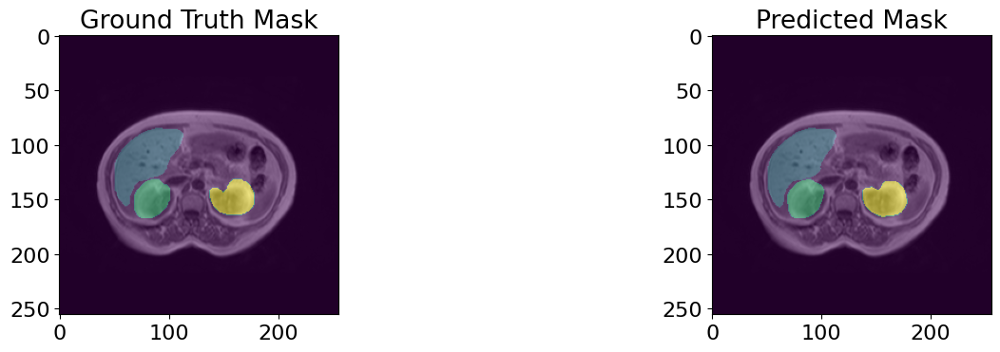

63/63 - 34s - loss: 0.0020 - accuracy: 0.9992 - mean_iou: 0.9797 - val_loss: 0.0593 - val_accuracy: 0.9897 - val_mean_iou: 0.7922 - lr: 1.0000e-04 - 34s/epoch - 542ms/step
Epoch 130/1000


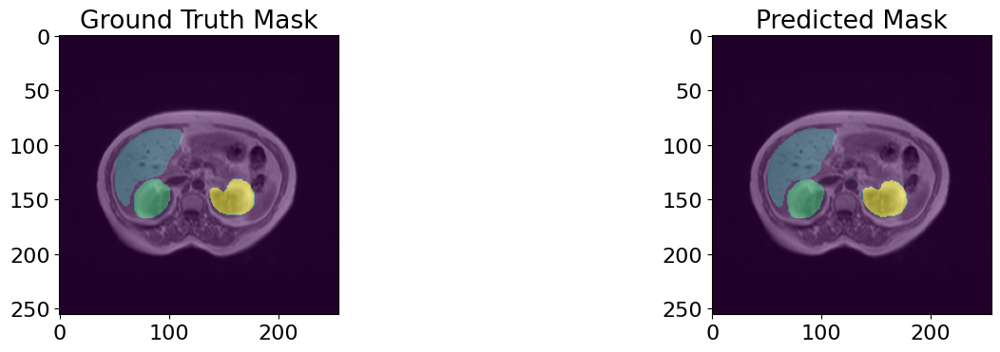

63/63 - 34s - loss: 0.0020 - accuracy: 0.9992 - mean_iou: 0.9801 - val_loss: 0.0597 - val_accuracy: 0.9897 - val_mean_iou: 0.7914 - lr: 1.0000e-04 - 34s/epoch - 542ms/step
Epoch 131/1000


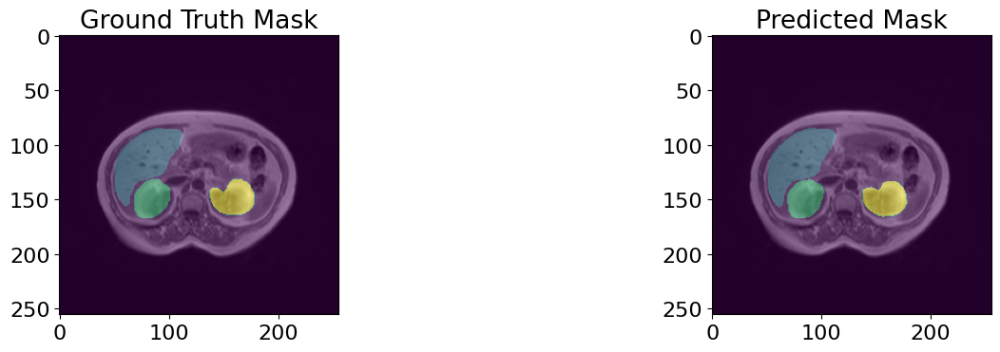

63/63 - 34s - loss: 0.0018 - accuracy: 0.9992 - mean_iou: 0.9813 - val_loss: 0.0614 - val_accuracy: 0.9897 - val_mean_iou: 0.7906 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 132/1000


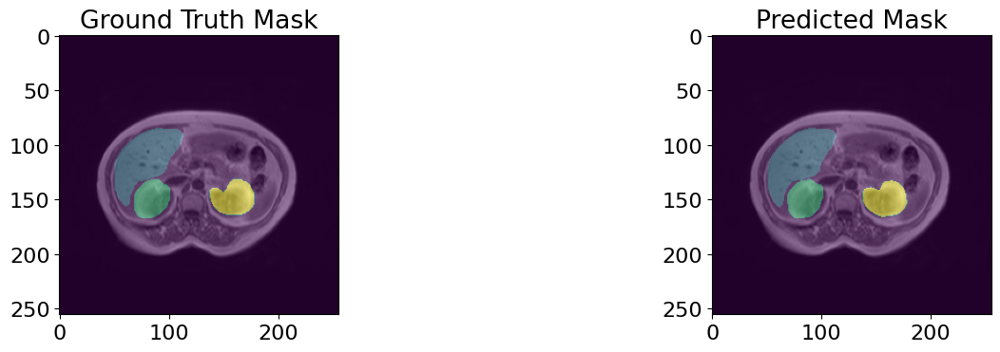

63/63 - 34s - loss: 0.0018 - accuracy: 0.9993 - mean_iou: 0.9819 - val_loss: 0.0632 - val_accuracy: 0.9897 - val_mean_iou: 0.7903 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 133/1000


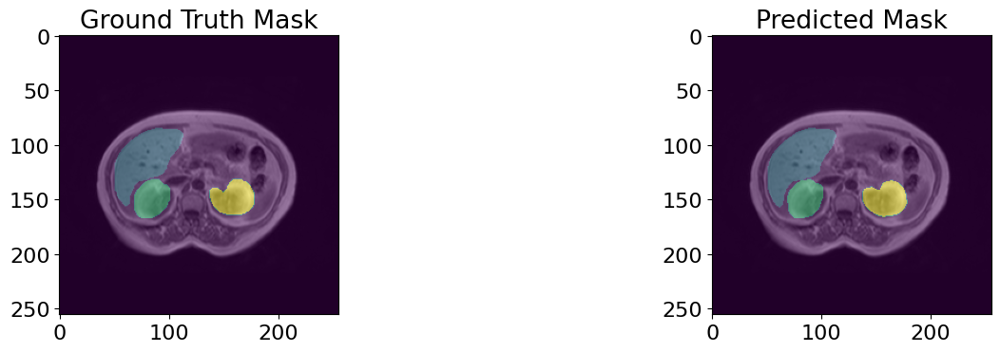

63/63 - 34s - loss: 0.0017 - accuracy: 0.9993 - mean_iou: 0.9824 - val_loss: 0.0634 - val_accuracy: 0.9897 - val_mean_iou: 0.7911 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 134/1000


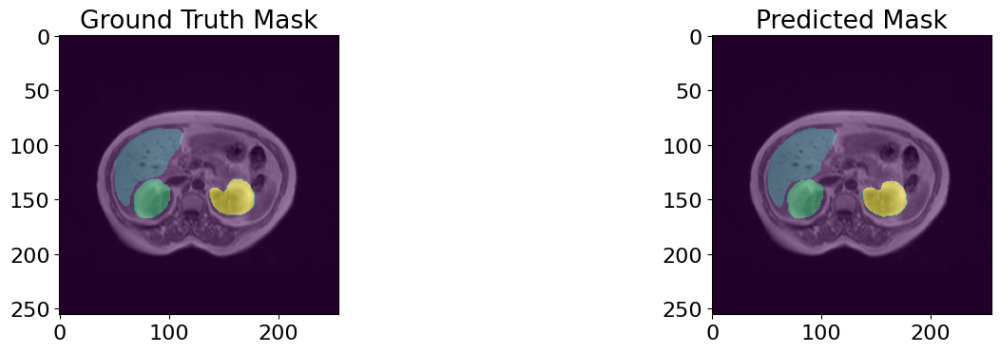

63/63 - 34s - loss: 0.0017 - accuracy: 0.9993 - mean_iou: 0.9828 - val_loss: 0.0643 - val_accuracy: 0.9897 - val_mean_iou: 0.7918 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 135/1000


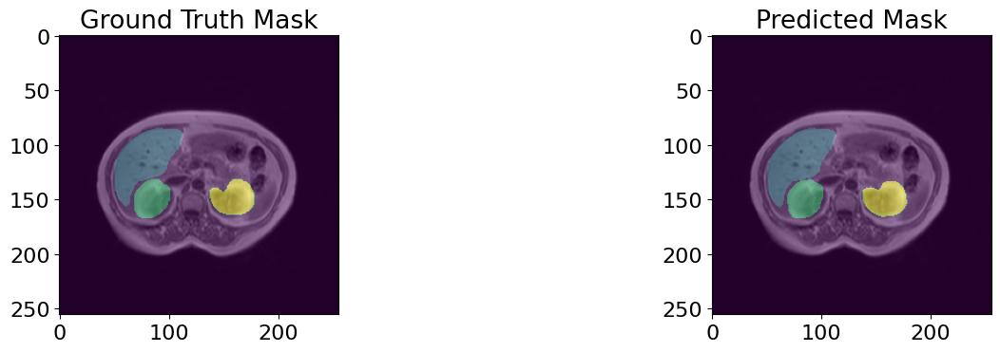

63/63 - 34s - loss: 0.0016 - accuracy: 0.9994 - mean_iou: 0.9838 - val_loss: 0.0658 - val_accuracy: 0.9896 - val_mean_iou: 0.7907 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 136/1000


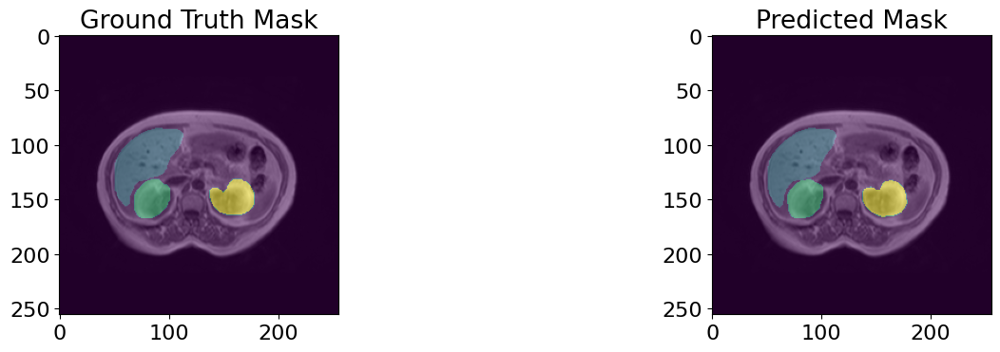

63/63 - 34s - loss: 0.0016 - accuracy: 0.9994 - mean_iou: 0.9847 - val_loss: 0.0671 - val_accuracy: 0.9897 - val_mean_iou: 0.7904 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 137/1000


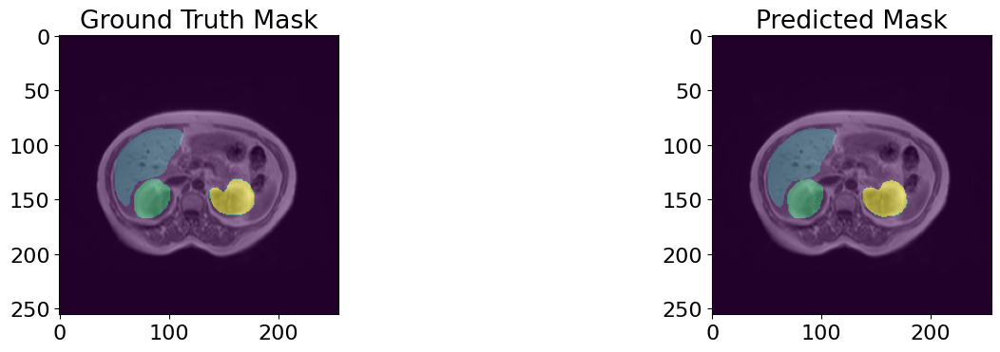

63/63 - 34s - loss: 0.0015 - accuracy: 0.9994 - mean_iou: 0.9845 - val_loss: 0.0666 - val_accuracy: 0.9897 - val_mean_iou: 0.7900 - lr: 1.0000e-04 - 34s/epoch - 543ms/step
Epoch 138/1000


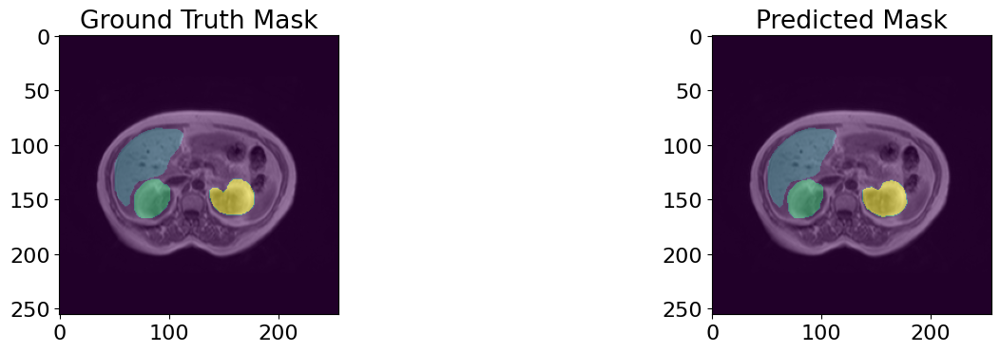

63/63 - 34s - loss: 0.0015 - accuracy: 0.9994 - mean_iou: 0.9850 - val_loss: 0.0682 - val_accuracy: 0.9896 - val_mean_iou: 0.7890 - lr: 1.0000e-04 - 34s/epoch - 542ms/step
Epoch 139/1000


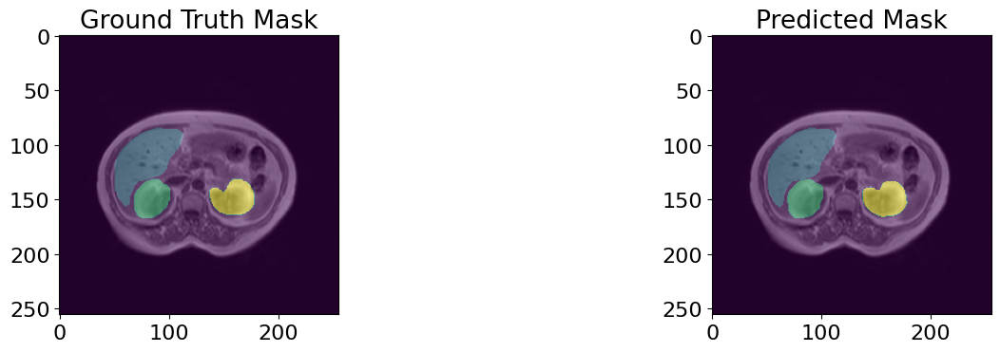

63/63 - 34s - loss: 0.0015 - accuracy: 0.9994 - mean_iou: 0.9852 - val_loss: 0.0688 - val_accuracy: 0.9897 - val_mean_iou: 0.7904 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 140/1000


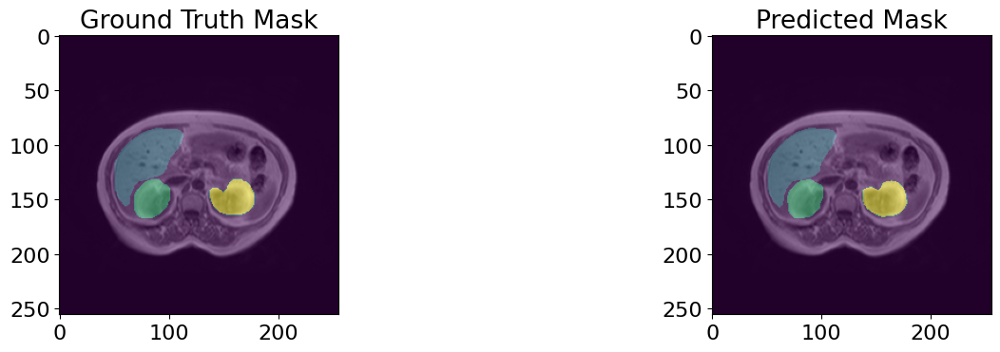

63/63 - 34s - loss: 0.0014 - accuracy: 0.9994 - mean_iou: 0.9861 - val_loss: 0.0703 - val_accuracy: 0.9896 - val_mean_iou: 0.7891 - lr: 1.0000e-04 - 34s/epoch - 542ms/step
Epoch 141/1000


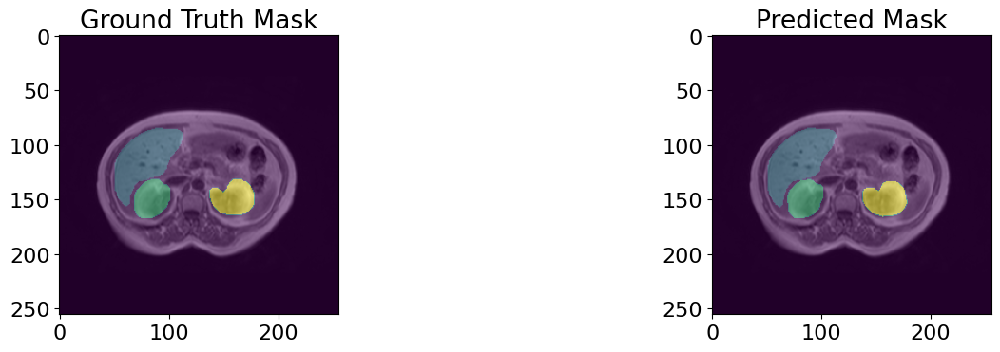

63/63 - 34s - loss: 0.0014 - accuracy: 0.9995 - mean_iou: 0.9862 - val_loss: 0.0709 - val_accuracy: 0.9896 - val_mean_iou: 0.7897 - lr: 1.0000e-04 - 34s/epoch - 545ms/step
Epoch 142/1000


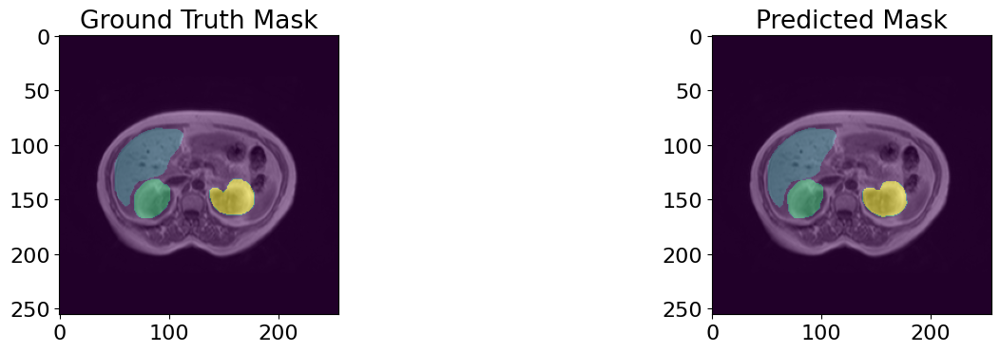

63/63 - 34s - loss: 0.0014 - accuracy: 0.9994 - mean_iou: 0.9857 - val_loss: 0.0721 - val_accuracy: 0.9896 - val_mean_iou: 0.7885 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 143/1000


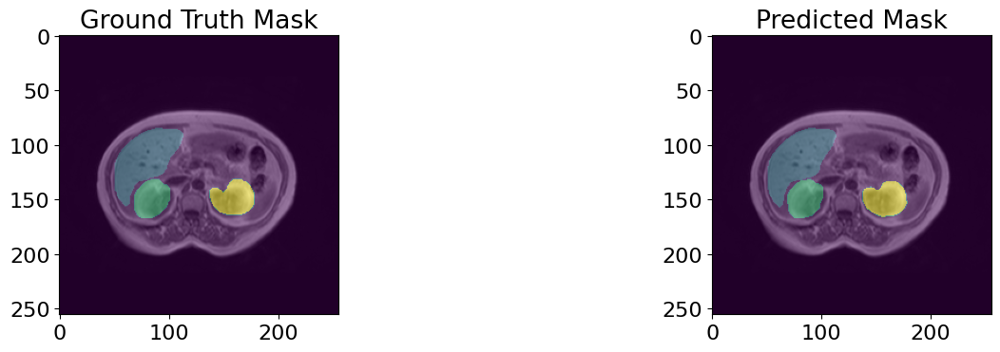

63/63 - 34s - loss: 0.0013 - accuracy: 0.9995 - mean_iou: 0.9867 - val_loss: 0.0728 - val_accuracy: 0.9896 - val_mean_iou: 0.7897 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 144/1000


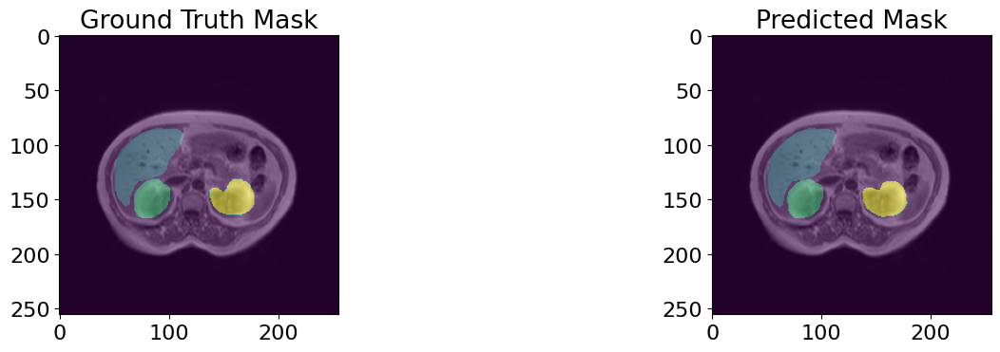

63/63 - 34s - loss: 0.0013 - accuracy: 0.9995 - mean_iou: 0.9870 - val_loss: 0.0734 - val_accuracy: 0.9896 - val_mean_iou: 0.7904 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 145/1000


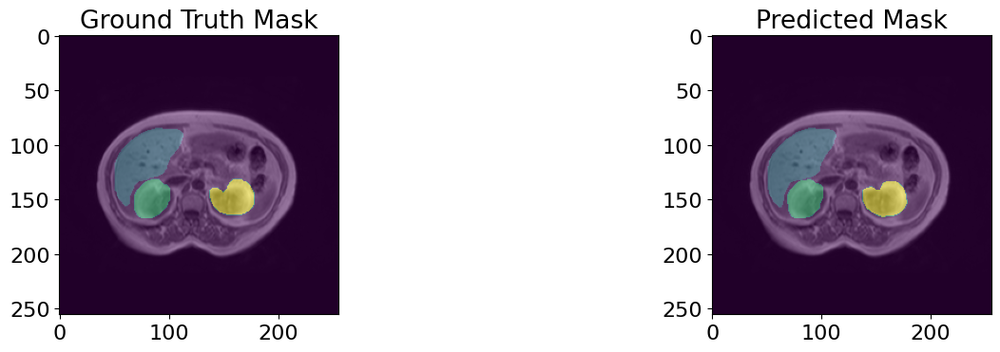

63/63 - 34s - loss: 0.0013 - accuracy: 0.9995 - mean_iou: 0.9872 - val_loss: 0.0741 - val_accuracy: 0.9895 - val_mean_iou: 0.7880 - lr: 1.0000e-04 - 34s/epoch - 543ms/step
Epoch 146/1000


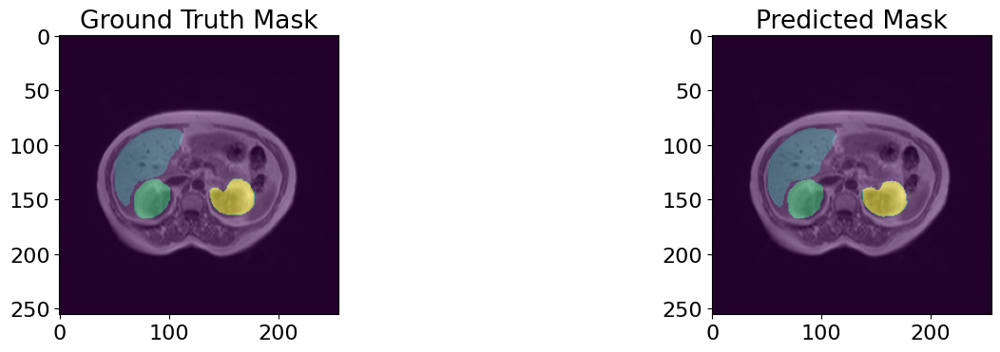

63/63 - 34s - loss: 0.0013 - accuracy: 0.9995 - mean_iou: 0.9871 - val_loss: 0.0746 - val_accuracy: 0.9895 - val_mean_iou: 0.7885 - lr: 1.0000e-04 - 34s/epoch - 543ms/step
Epoch 147/1000


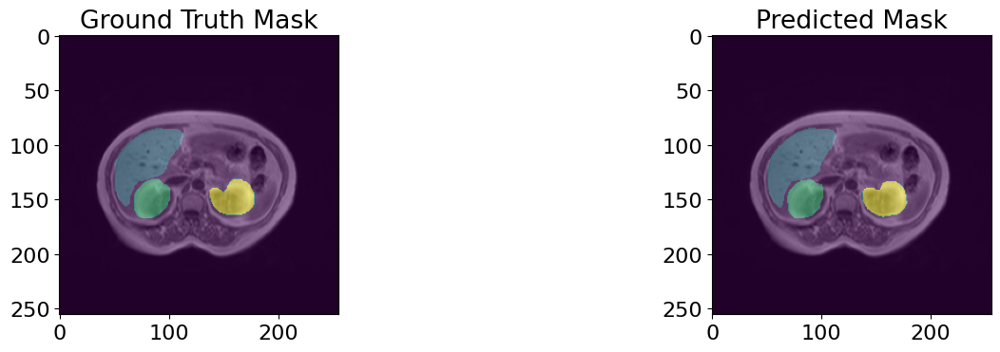

63/63 - 34s - loss: 0.0012 - accuracy: 0.9995 - mean_iou: 0.9876 - val_loss: 0.0753 - val_accuracy: 0.9896 - val_mean_iou: 0.7889 - lr: 1.0000e-04 - 34s/epoch - 543ms/step
Epoch 148/1000


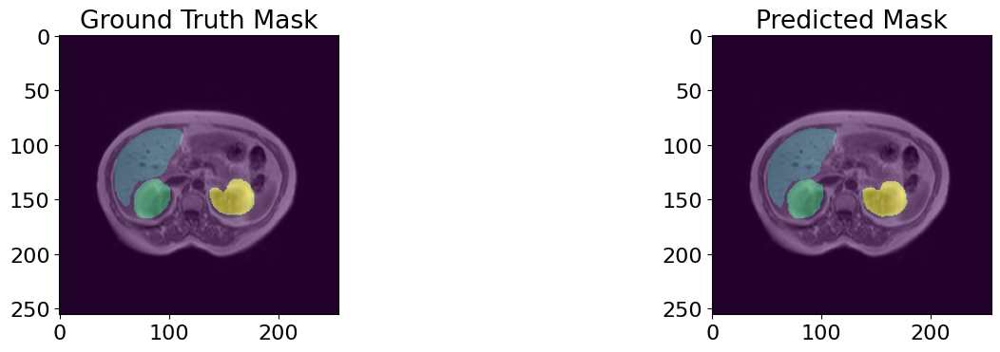

63/63 - 34s - loss: 0.0012 - accuracy: 0.9995 - mean_iou: 0.9881 - val_loss: 0.0755 - val_accuracy: 0.9895 - val_mean_iou: 0.7897 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 149/1000


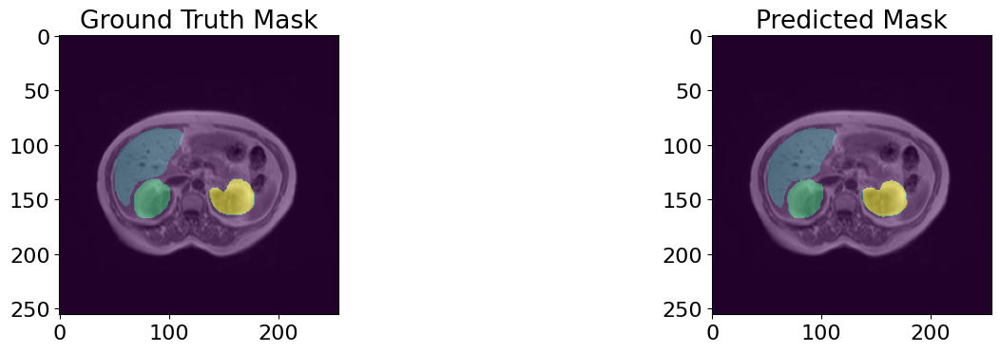

63/63 - 34s - loss: 0.0012 - accuracy: 0.9995 - mean_iou: 0.9883 - val_loss: 0.0769 - val_accuracy: 0.9895 - val_mean_iou: 0.7887 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 150/1000


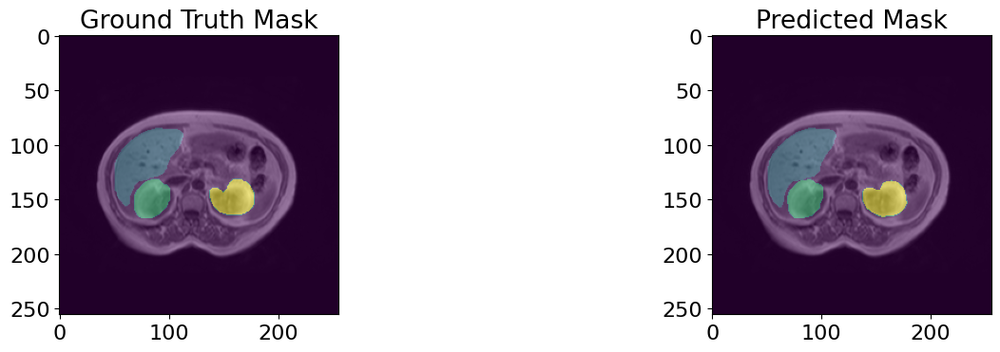

63/63 - 34s - loss: 0.0012 - accuracy: 0.9995 - mean_iou: 0.9879 - val_loss: 0.0776 - val_accuracy: 0.9895 - val_mean_iou: 0.7884 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 151/1000


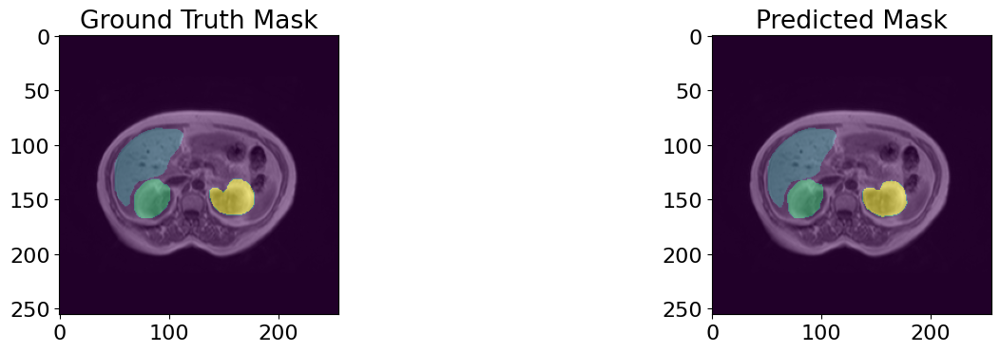

63/63 - 34s - loss: 0.0012 - accuracy: 0.9995 - mean_iou: 0.9886 - val_loss: 0.0780 - val_accuracy: 0.9895 - val_mean_iou: 0.7888 - lr: 1.0000e-04 - 34s/epoch - 544ms/step
Epoch 152/1000


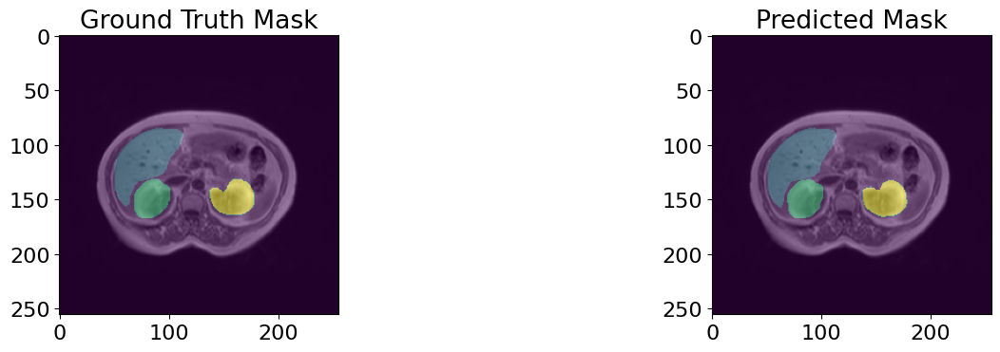

63/63 - 34s - loss: 0.0011 - accuracy: 0.9996 - mean_iou: 0.9891 - val_loss: 0.0787 - val_accuracy: 0.9895 - val_mean_iou: 0.7888 - lr: 1.0000e-04 - 34s/epoch - 545ms/step
Epoch 153/1000


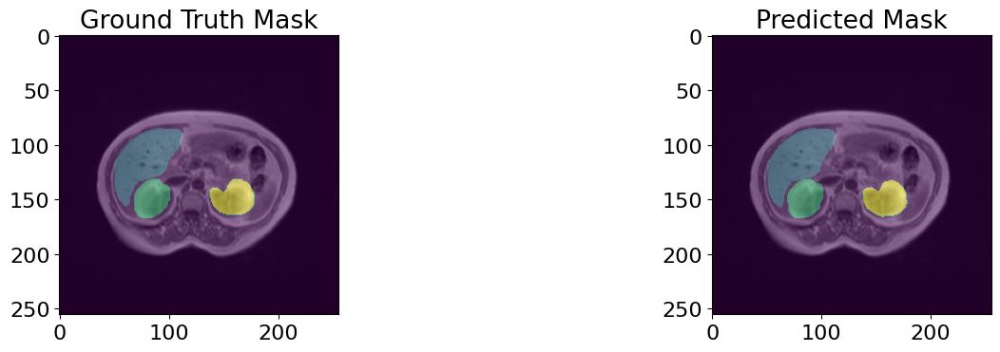

63/63 - 34s - loss: 0.0011 - accuracy: 0.9996 - mean_iou: 0.9892 - val_loss: 0.0788 - val_accuracy: 0.9895 - val_mean_iou: 0.7886 - lr: 1.0000e-04 - 34s/epoch - 545ms/step
Epoch 154/1000


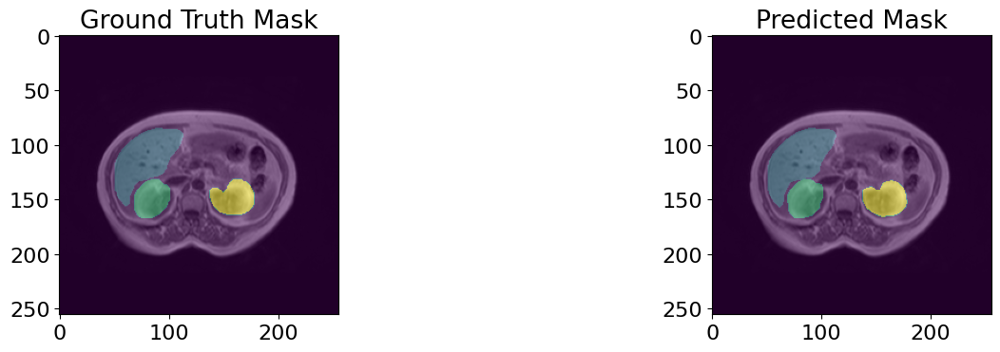

63/63 - 35s - loss: 0.0011 - accuracy: 0.9996 - mean_iou: 0.9895 - val_loss: 0.0789 - val_accuracy: 0.9895 - val_mean_iou: 0.7891 - lr: 1.0000e-04 - 35s/epoch - 550ms/step
Epoch 155/1000


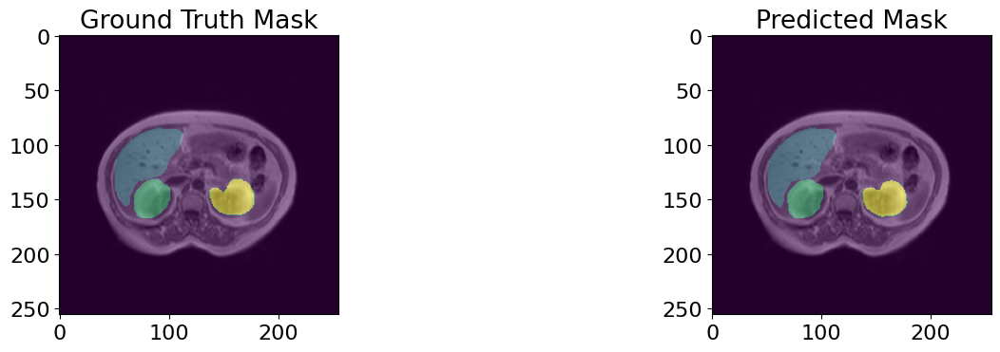

63/63 - 34s - loss: 0.0010 - accuracy: 0.9996 - mean_iou: 0.9897 - val_loss: 0.0804 - val_accuracy: 0.9895 - val_mean_iou: 0.7888 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 156/1000


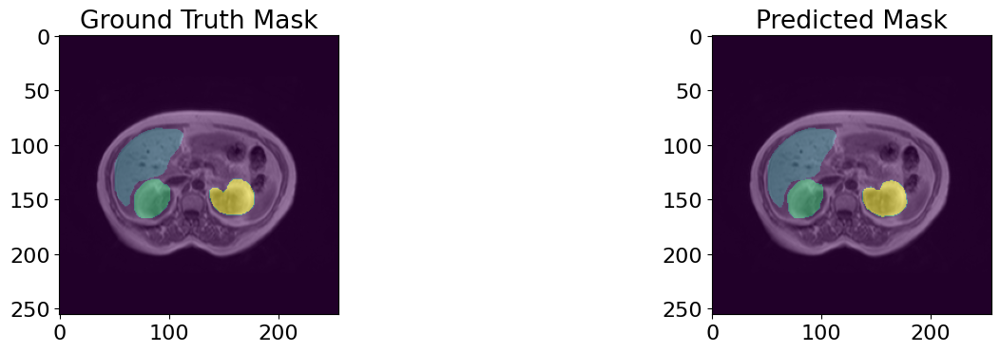

63/63 - 34s - loss: 0.0010 - accuracy: 0.9996 - mean_iou: 0.9900 - val_loss: 0.0808 - val_accuracy: 0.9895 - val_mean_iou: 0.7887 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 157/1000


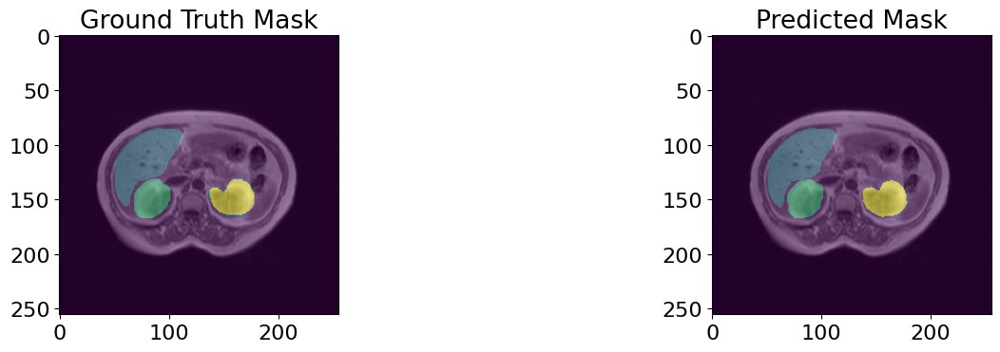

63/63 - 34s - loss: 9.9814e-04 - accuracy: 0.9996 - mean_iou: 0.9903 - val_loss: 0.0812 - val_accuracy: 0.9895 - val_mean_iou: 0.7887 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 158/1000


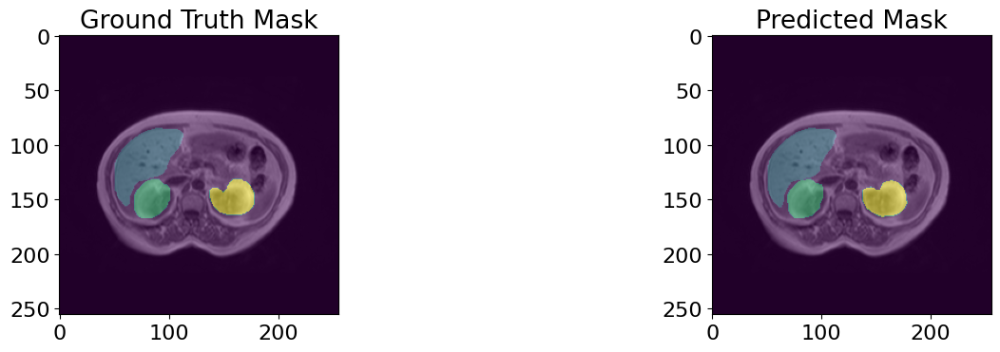

63/63 - 34s - loss: 9.9724e-04 - accuracy: 0.9996 - mean_iou: 0.9902 - val_loss: 0.0813 - val_accuracy: 0.9895 - val_mean_iou: 0.7888 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 159/1000


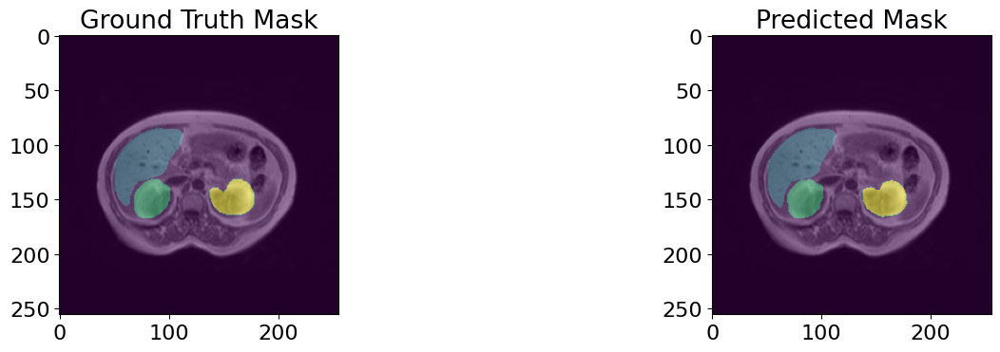

63/63 - 34s - loss: 0.0010 - accuracy: 0.9996 - mean_iou: 0.9903 - val_loss: 0.0817 - val_accuracy: 0.9895 - val_mean_iou: 0.7884 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 160/1000


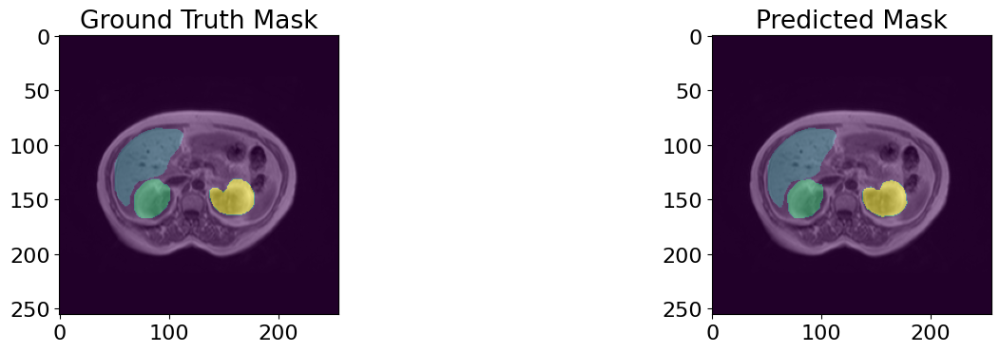

63/63 - 34s - loss: 0.0010 - accuracy: 0.9996 - mean_iou: 0.9901 - val_loss: 0.0818 - val_accuracy: 0.9895 - val_mean_iou: 0.7885 - lr: 1.0000e-05 - 34s/epoch - 547ms/step
Epoch 161/1000


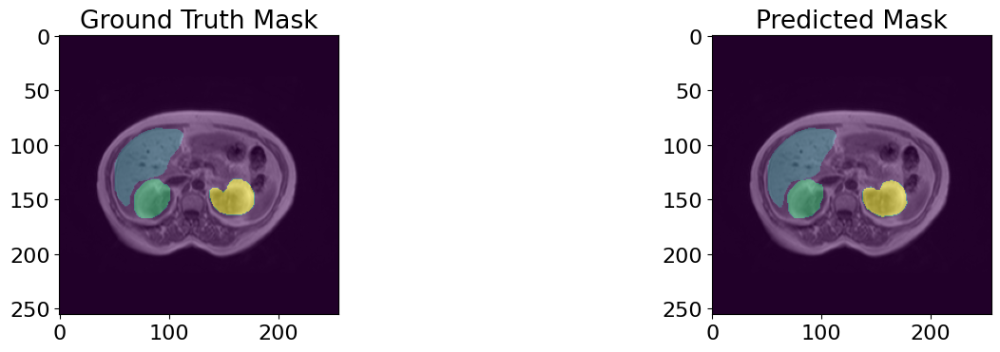

63/63 - 34s - loss: 9.7040e-04 - accuracy: 0.9996 - mean_iou: 0.9906 - val_loss: 0.0818 - val_accuracy: 0.9895 - val_mean_iou: 0.7881 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 162/1000


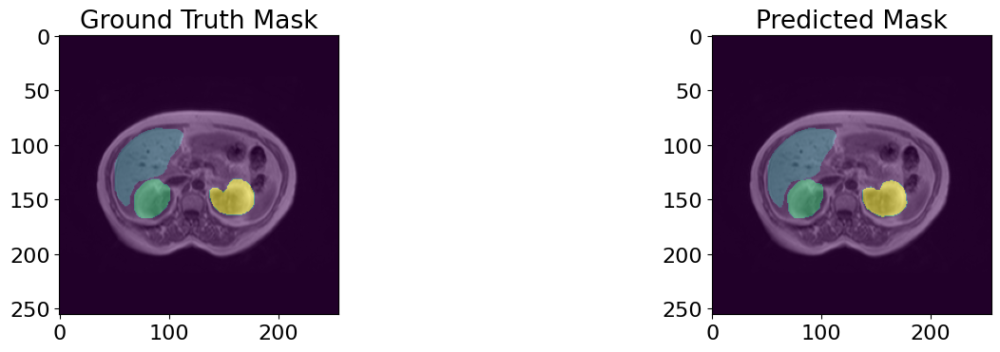

63/63 - 34s - loss: 9.9976e-04 - accuracy: 0.9996 - mean_iou: 0.9903 - val_loss: 0.0820 - val_accuracy: 0.9894 - val_mean_iou: 0.7883 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 163/1000


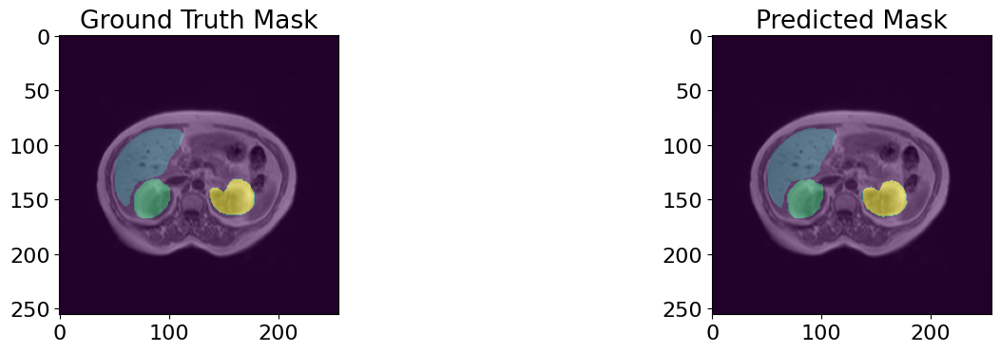

63/63 - 34s - loss: 9.7789e-04 - accuracy: 0.9996 - mean_iou: 0.9904 - val_loss: 0.0821 - val_accuracy: 0.9895 - val_mean_iou: 0.7883 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 164/1000


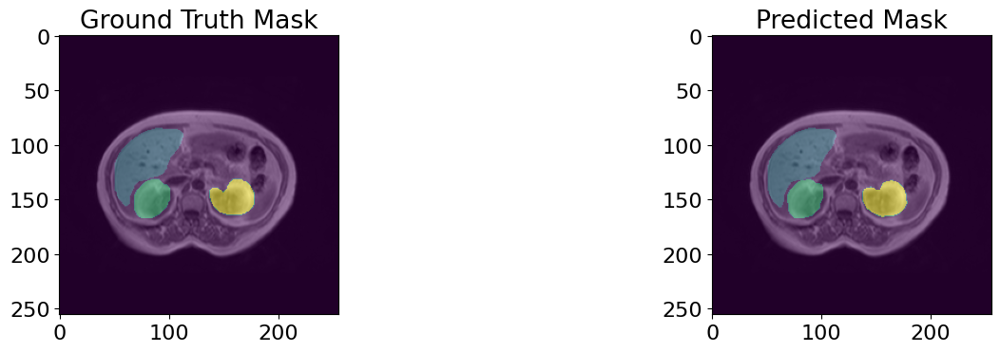

63/63 - 34s - loss: 9.8922e-04 - accuracy: 0.9996 - mean_iou: 0.9905 - val_loss: 0.0822 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 165/1000


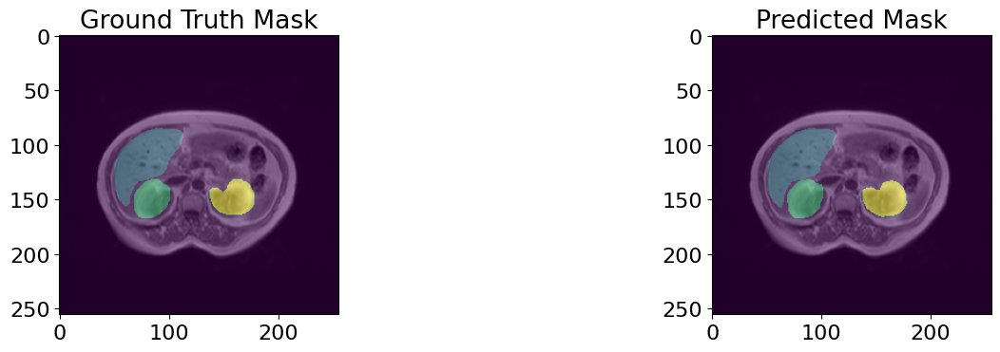

63/63 - 34s - loss: 9.8591e-04 - accuracy: 0.9996 - mean_iou: 0.9904 - val_loss: 0.0825 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 166/1000


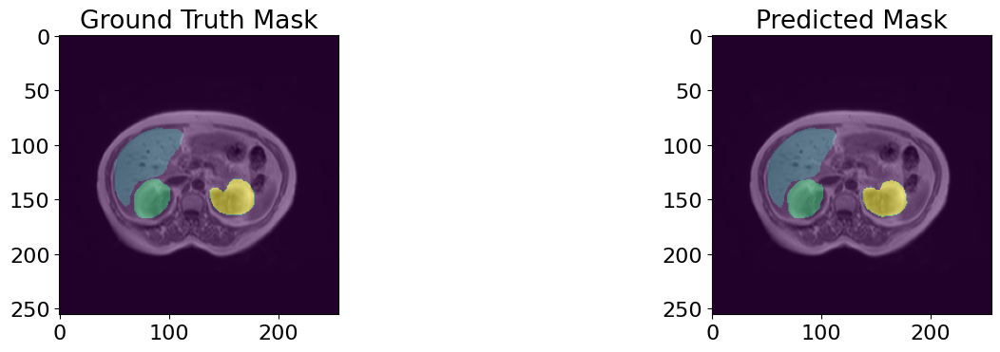

63/63 - 34s - loss: 9.7643e-04 - accuracy: 0.9996 - mean_iou: 0.9904 - val_loss: 0.0825 - val_accuracy: 0.9895 - val_mean_iou: 0.7886 - lr: 1.0000e-05 - 34s/epoch - 542ms/step
Epoch 167/1000


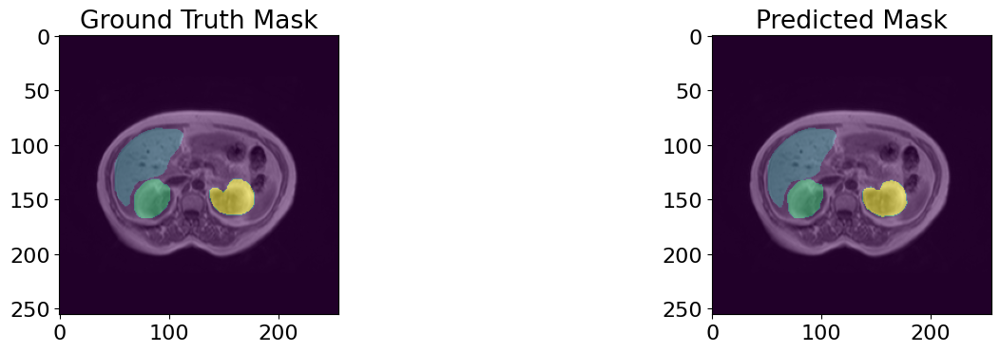

63/63 - 34s - loss: 9.8140e-04 - accuracy: 0.9996 - mean_iou: 0.9905 - val_loss: 0.0828 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 542ms/step
Epoch 168/1000


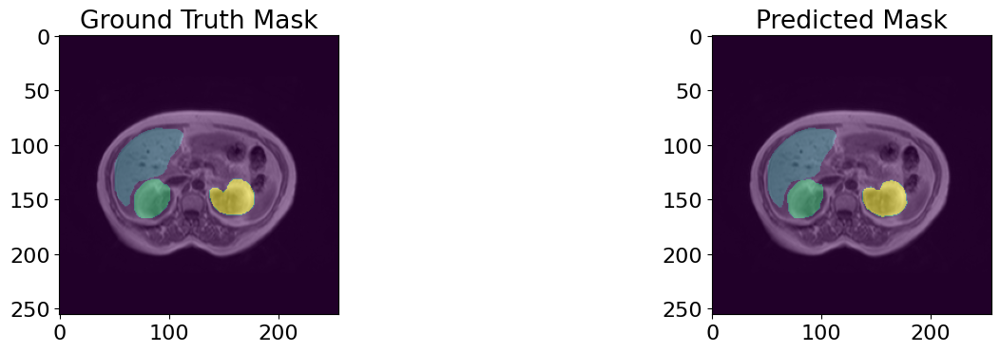

63/63 - 34s - loss: 9.6188e-04 - accuracy: 0.9996 - mean_iou: 0.9907 - val_loss: 0.0830 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 169/1000


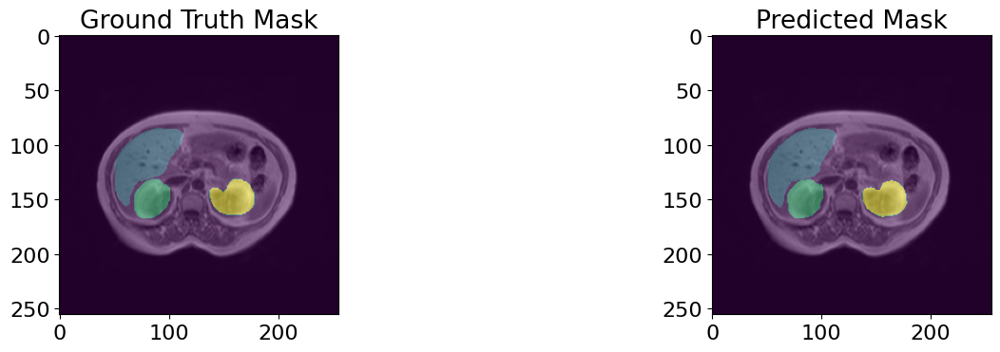

63/63 - 34s - loss: 9.5689e-04 - accuracy: 0.9996 - mean_iou: 0.9907 - val_loss: 0.0831 - val_accuracy: 0.9894 - val_mean_iou: 0.7882 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 170/1000


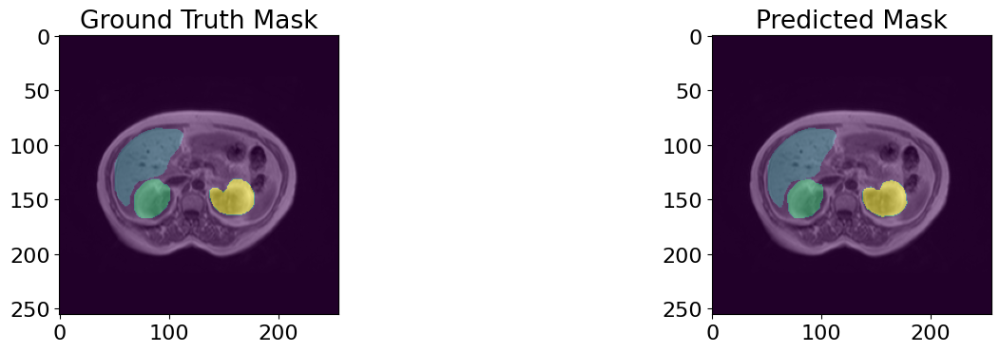

63/63 - 34s - loss: 9.7843e-04 - accuracy: 0.9996 - mean_iou: 0.9906 - val_loss: 0.0833 - val_accuracy: 0.9894 - val_mean_iou: 0.7883 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 171/1000


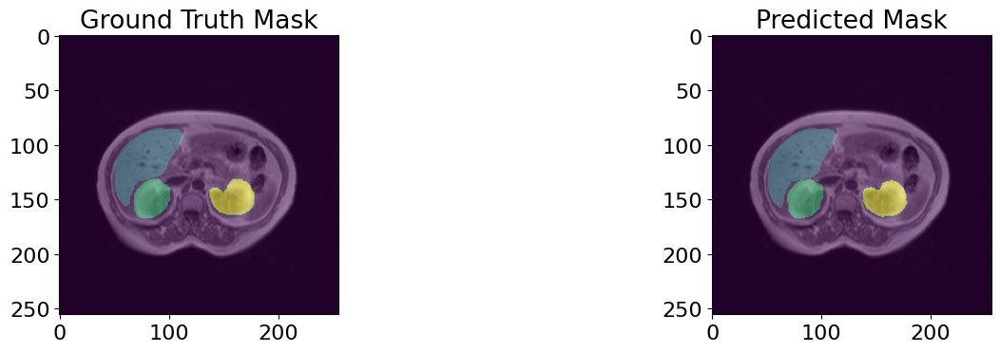

63/63 - 34s - loss: 9.3438e-04 - accuracy: 0.9996 - mean_iou: 0.9910 - val_loss: 0.0834 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 172/1000


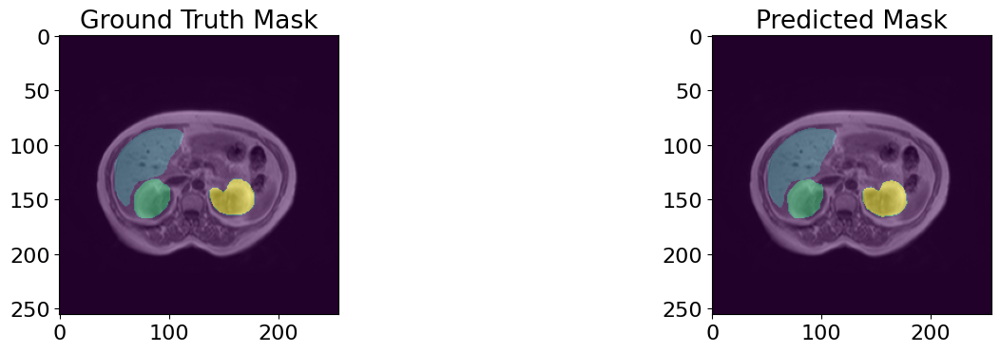

63/63 - 34s - loss: 9.5442e-04 - accuracy: 0.9996 - mean_iou: 0.9908 - val_loss: 0.0834 - val_accuracy: 0.9895 - val_mean_iou: 0.7885 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 173/1000


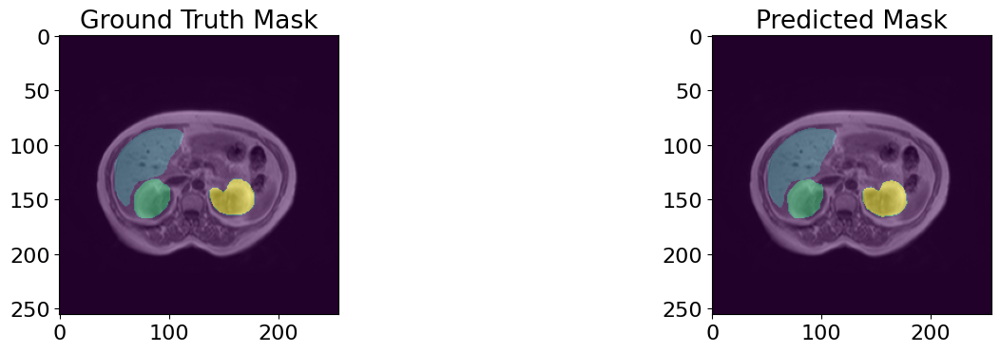

63/63 - 34s - loss: 9.4840e-04 - accuracy: 0.9996 - mean_iou: 0.9908 - val_loss: 0.0834 - val_accuracy: 0.9895 - val_mean_iou: 0.7884 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 174/1000


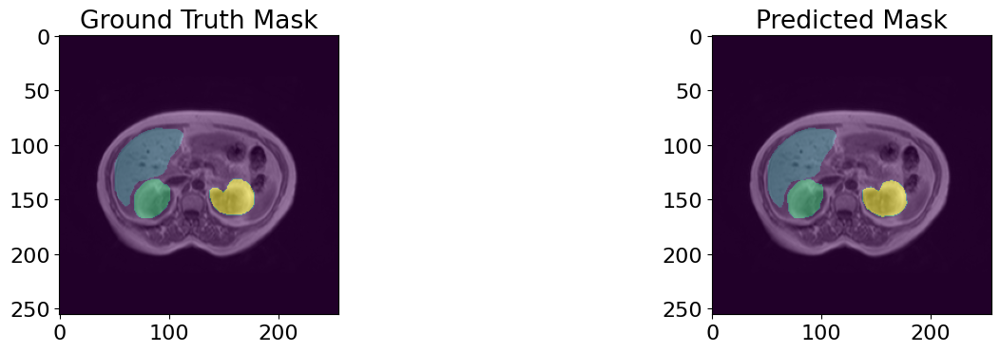

63/63 - 34s - loss: 9.8127e-04 - accuracy: 0.9996 - mean_iou: 0.9904 - val_loss: 0.0836 - val_accuracy: 0.9894 - val_mean_iou: 0.7884 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 175/1000


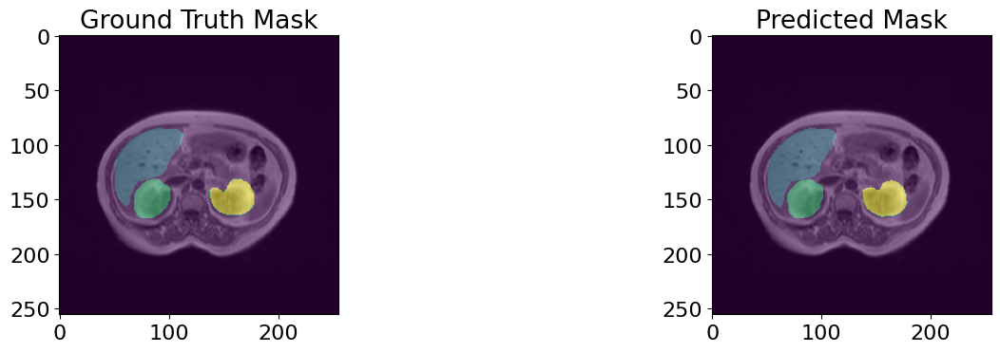

63/63 - 34s - loss: 9.7490e-04 - accuracy: 0.9996 - mean_iou: 0.9906 - val_loss: 0.0837 - val_accuracy: 0.9894 - val_mean_iou: 0.7880 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 176/1000


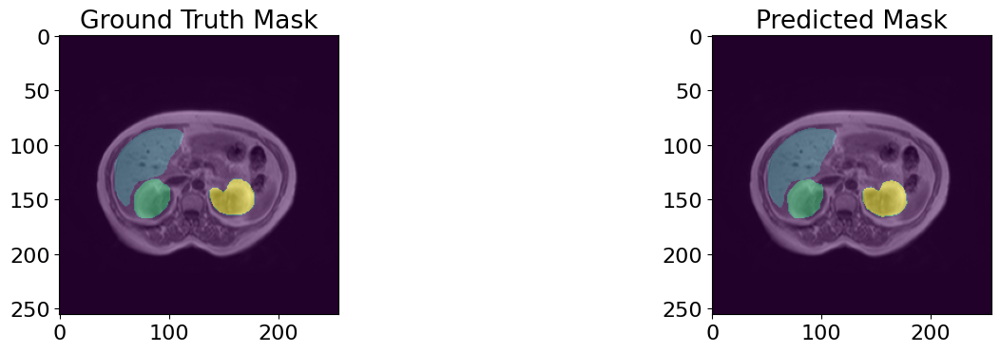

63/63 - 34s - loss: 9.8442e-04 - accuracy: 0.9996 - mean_iou: 0.9905 - val_loss: 0.0839 - val_accuracy: 0.9894 - val_mean_iou: 0.7877 - lr: 1.0000e-05 - 34s/epoch - 542ms/step
Epoch 177/1000


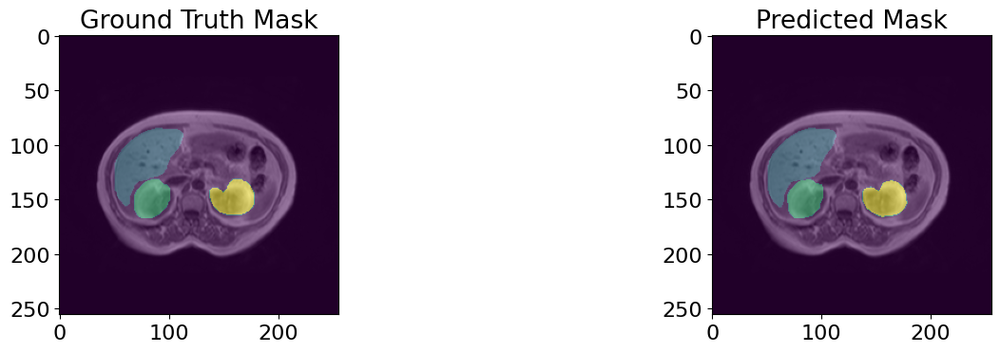

63/63 - 34s - loss: 9.3363e-04 - accuracy: 0.9996 - mean_iou: 0.9910 - val_loss: 0.0840 - val_accuracy: 0.9894 - val_mean_iou: 0.7880 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 178/1000


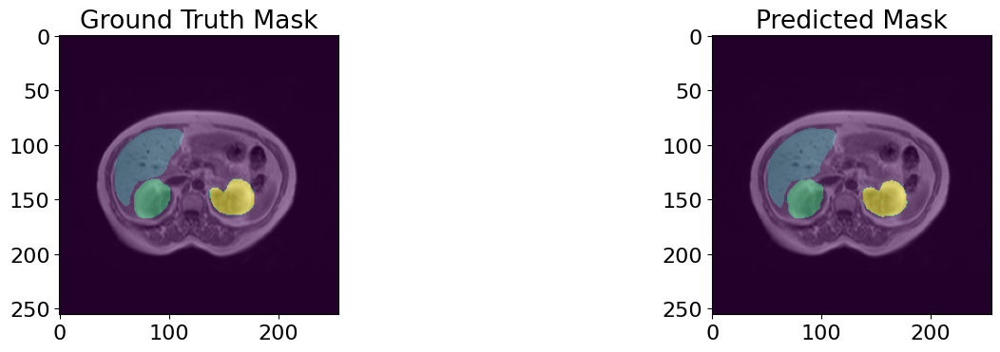

63/63 - 34s - loss: 9.4921e-04 - accuracy: 0.9996 - mean_iou: 0.9909 - val_loss: 0.0842 - val_accuracy: 0.9894 - val_mean_iou: 0.7880 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 179/1000


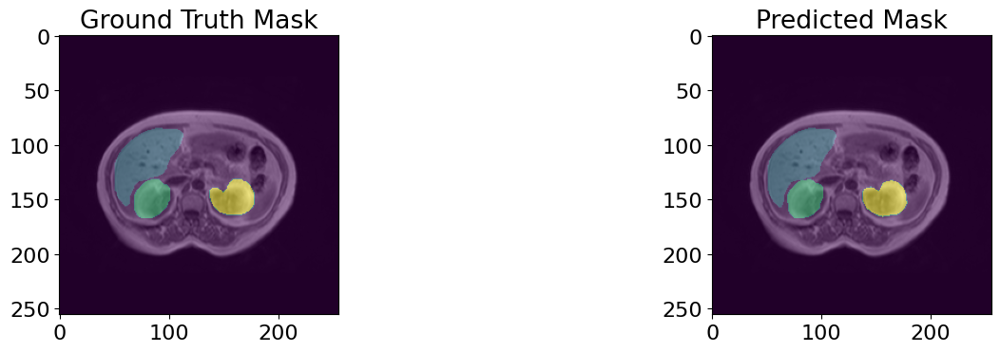

63/63 - 34s - loss: 9.5710e-04 - accuracy: 0.9996 - mean_iou: 0.9906 - val_loss: 0.0846 - val_accuracy: 0.9894 - val_mean_iou: 0.7875 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 180/1000


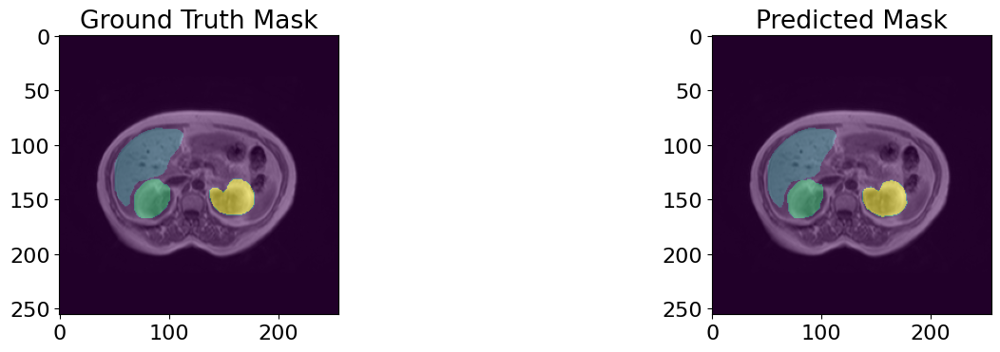

63/63 - 34s - loss: 9.3771e-04 - accuracy: 0.9996 - mean_iou: 0.9908 - val_loss: 0.0845 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 181/1000


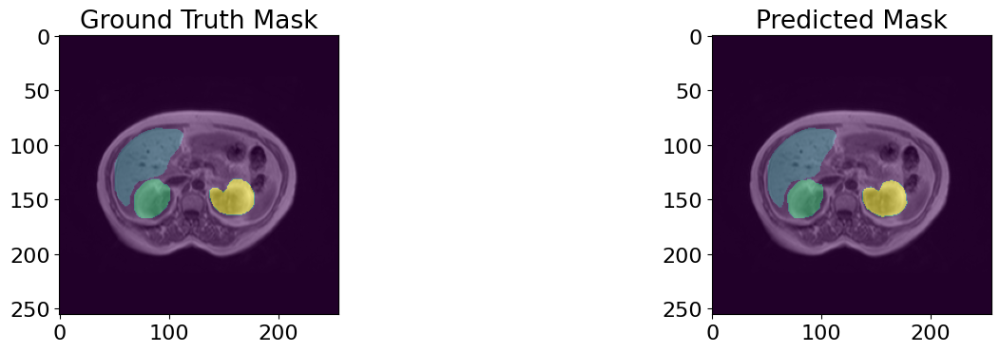

63/63 - 34s - loss: 9.2818e-04 - accuracy: 0.9996 - mean_iou: 0.9909 - val_loss: 0.0847 - val_accuracy: 0.9894 - val_mean_iou: 0.7878 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 182/1000


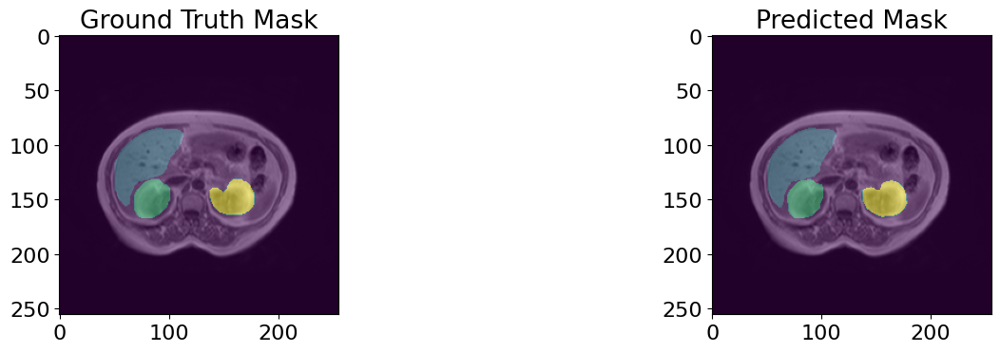

63/63 - 35s - loss: 9.1526e-04 - accuracy: 0.9996 - mean_iou: 0.9911 - val_loss: 0.0849 - val_accuracy: 0.9894 - val_mean_iou: 0.7882 - lr: 1.0000e-05 - 35s/epoch - 551ms/step
Epoch 183/1000


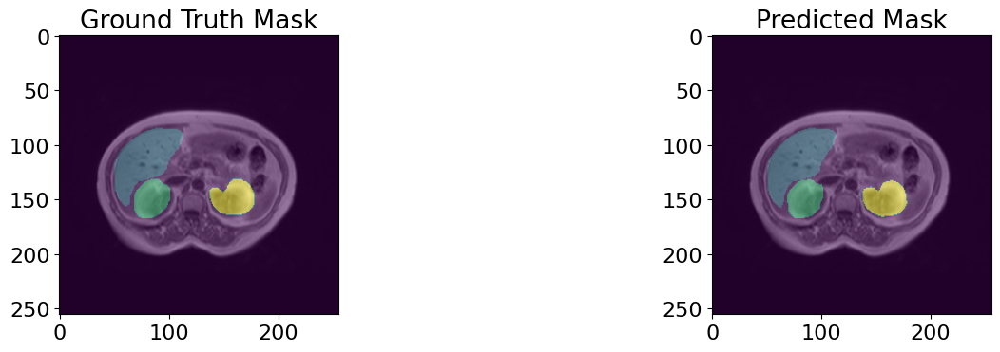

63/63 - 34s - loss: 9.4684e-04 - accuracy: 0.9996 - mean_iou: 0.9908 - val_loss: 0.0848 - val_accuracy: 0.9894 - val_mean_iou: 0.7881 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 184/1000


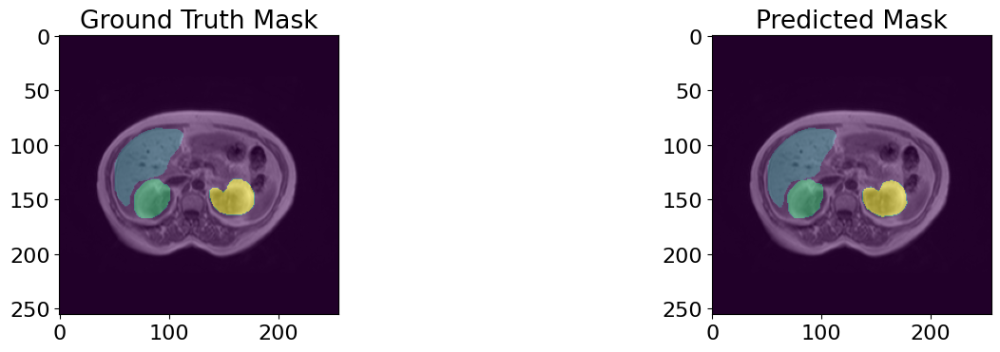

63/63 - 34s - loss: 9.1882e-04 - accuracy: 0.9996 - mean_iou: 0.9911 - val_loss: 0.0852 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 185/1000


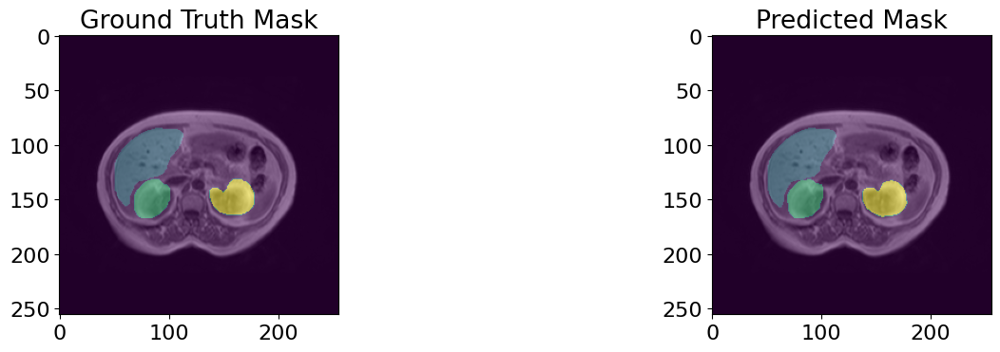

63/63 - 34s - loss: 9.3066e-04 - accuracy: 0.9996 - mean_iou: 0.9910 - val_loss: 0.0855 - val_accuracy: 0.9894 - val_mean_iou: 0.7884 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 186/1000


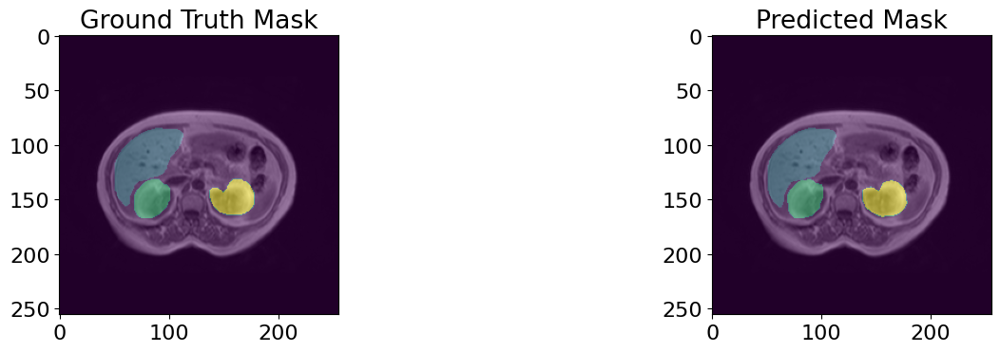

63/63 - 34s - loss: 9.2455e-04 - accuracy: 0.9996 - mean_iou: 0.9911 - val_loss: 0.0855 - val_accuracy: 0.9894 - val_mean_iou: 0.7881 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 187/1000


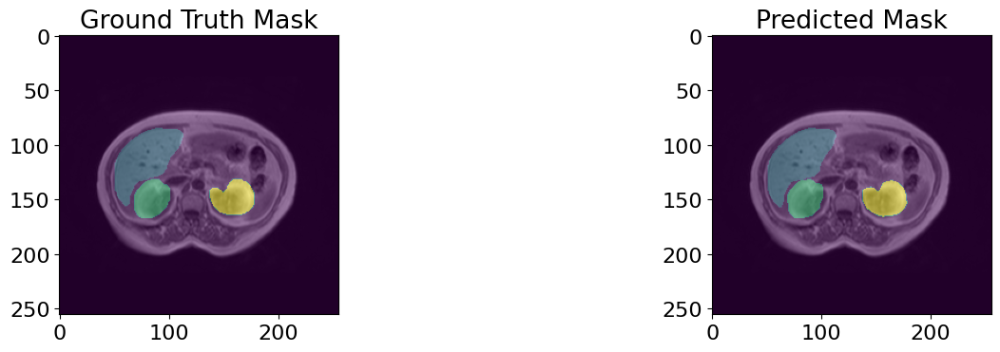

63/63 - 34s - loss: 9.3780e-04 - accuracy: 0.9996 - mean_iou: 0.9909 - val_loss: 0.0858 - val_accuracy: 0.9894 - val_mean_iou: 0.7883 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 188/1000


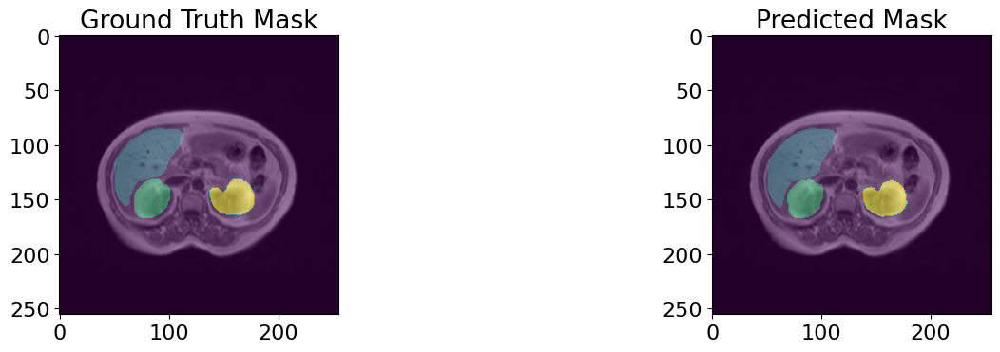

63/63 - 34s - loss: 9.3256e-04 - accuracy: 0.9996 - mean_iou: 0.9910 - val_loss: 0.0860 - val_accuracy: 0.9894 - val_mean_iou: 0.7883 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 189/1000


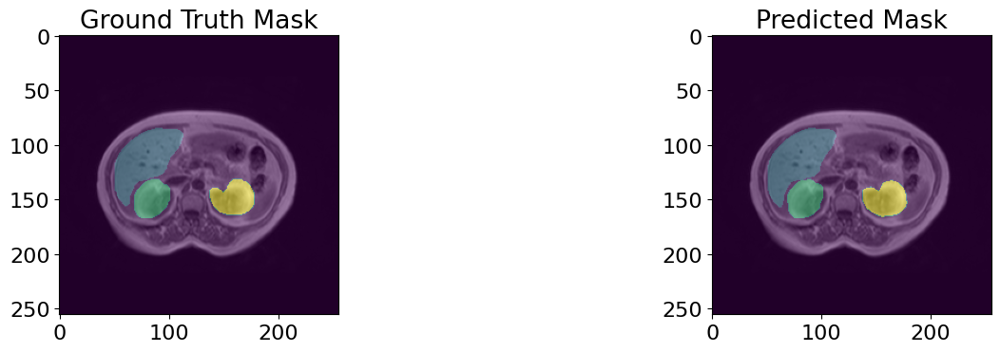

63/63 - 34s - loss: 9.1760e-04 - accuracy: 0.9996 - mean_iou: 0.9911 - val_loss: 0.0860 - val_accuracy: 0.9894 - val_mean_iou: 0.7878 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 190/1000


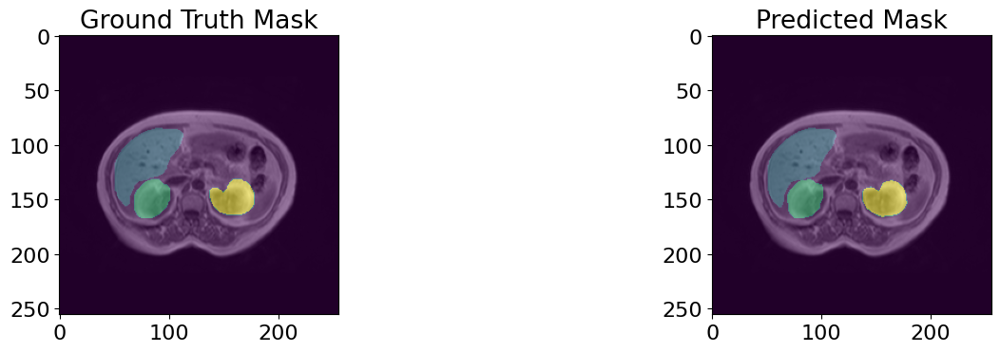

63/63 - 34s - loss: 8.9969e-04 - accuracy: 0.9997 - mean_iou: 0.9913 - val_loss: 0.0862 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 191/1000


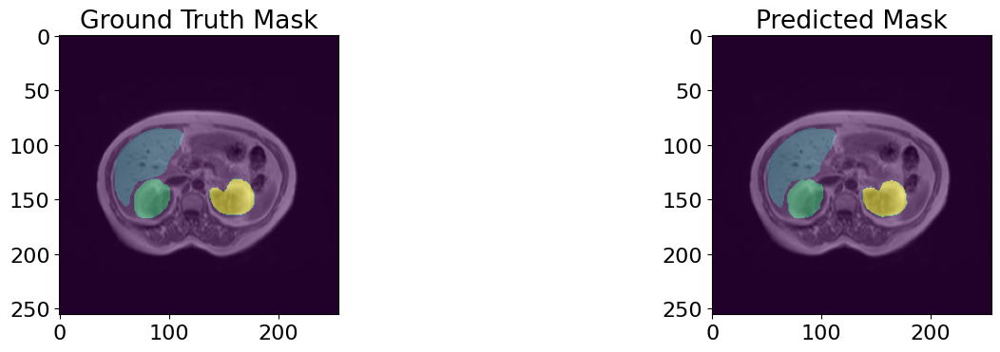

63/63 - 34s - loss: 9.1283e-04 - accuracy: 0.9996 - mean_iou: 0.9911 - val_loss: 0.0864 - val_accuracy: 0.9894 - val_mean_iou: 0.7881 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 192/1000


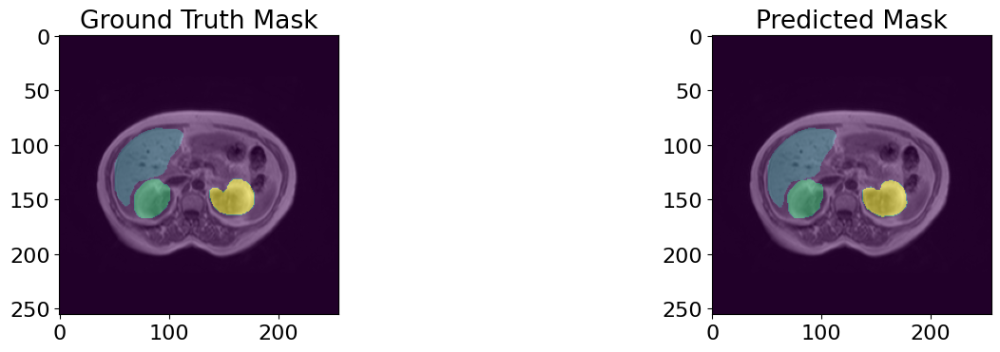

63/63 - 34s - loss: 9.2283e-04 - accuracy: 0.9996 - mean_iou: 0.9910 - val_loss: 0.0865 - val_accuracy: 0.9894 - val_mean_iou: 0.7882 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 193/1000


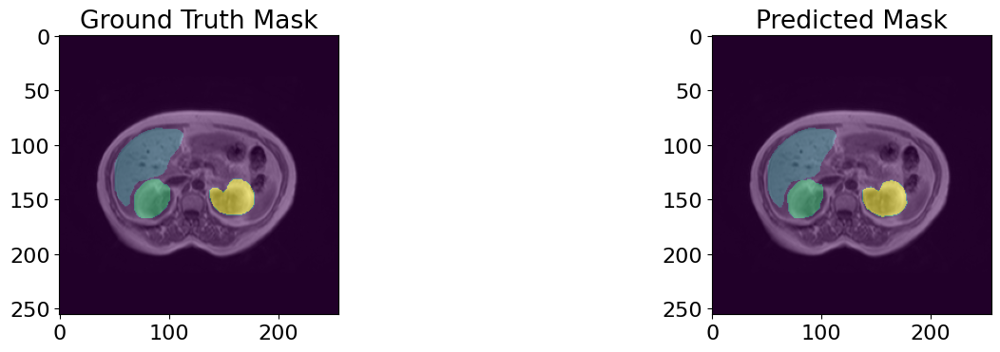

63/63 - 34s - loss: 8.9762e-04 - accuracy: 0.9997 - mean_iou: 0.9913 - val_loss: 0.0867 - val_accuracy: 0.9894 - val_mean_iou: 0.7878 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 194/1000


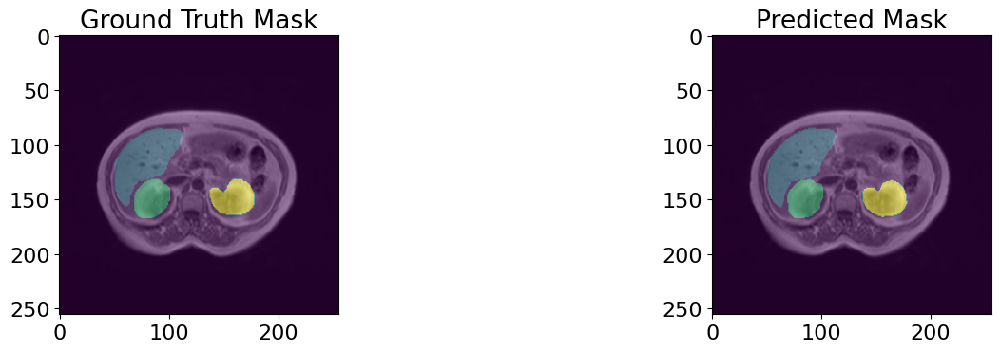

63/63 - 34s - loss: 9.0226e-04 - accuracy: 0.9996 - mean_iou: 0.9913 - val_loss: 0.0869 - val_accuracy: 0.9894 - val_mean_iou: 0.7878 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 195/1000


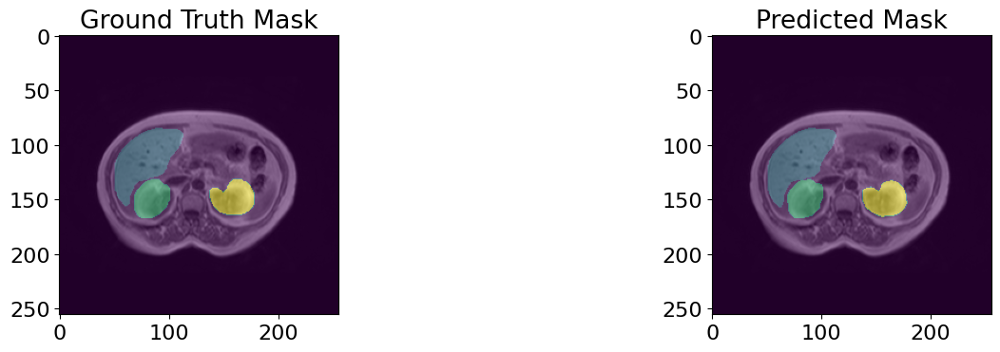

63/63 - 34s - loss: 9.3087e-04 - accuracy: 0.9996 - mean_iou: 0.9910 - val_loss: 0.0869 - val_accuracy: 0.9894 - val_mean_iou: 0.7874 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 196/1000


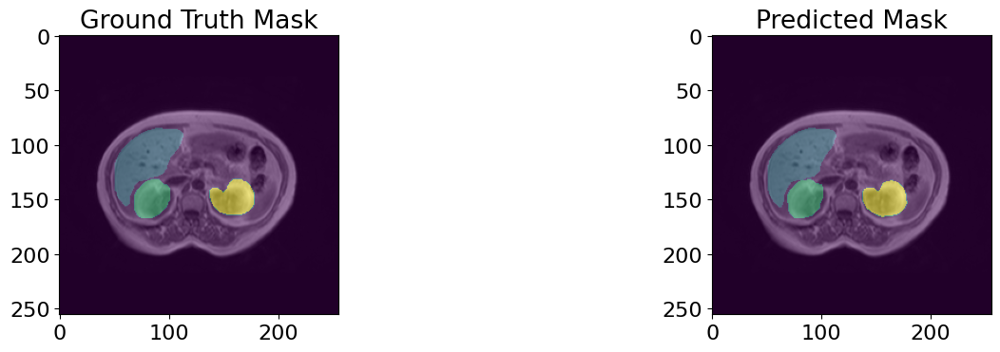

63/63 - 34s - loss: 8.9204e-04 - accuracy: 0.9997 - mean_iou: 0.9914 - val_loss: 0.0873 - val_accuracy: 0.9894 - val_mean_iou: 0.7871 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 197/1000


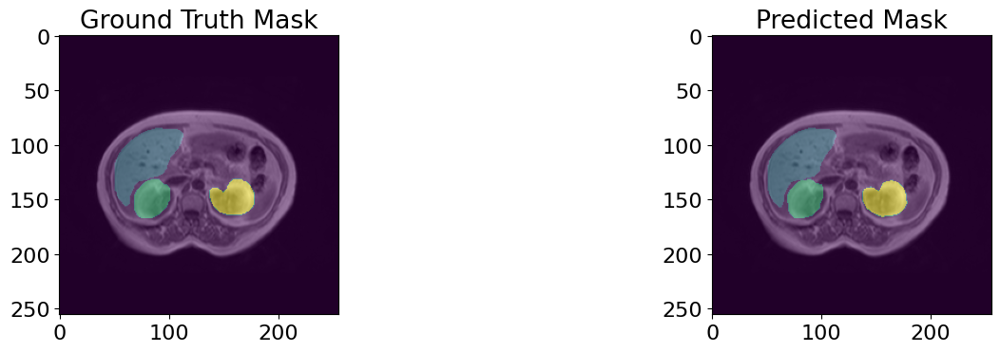

63/63 - 34s - loss: 9.1307e-04 - accuracy: 0.9996 - mean_iou: 0.9911 - val_loss: 0.0873 - val_accuracy: 0.9894 - val_mean_iou: 0.7871 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 198/1000


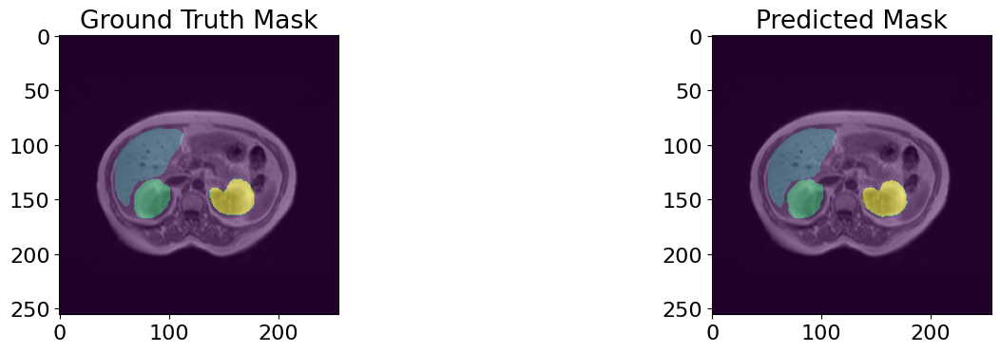

63/63 - 34s - loss: 9.0786e-04 - accuracy: 0.9996 - mean_iou: 0.9912 - val_loss: 0.0876 - val_accuracy: 0.9894 - val_mean_iou: 0.7872 - lr: 1.0000e-05 - 34s/epoch - 545ms/step
Epoch 199/1000


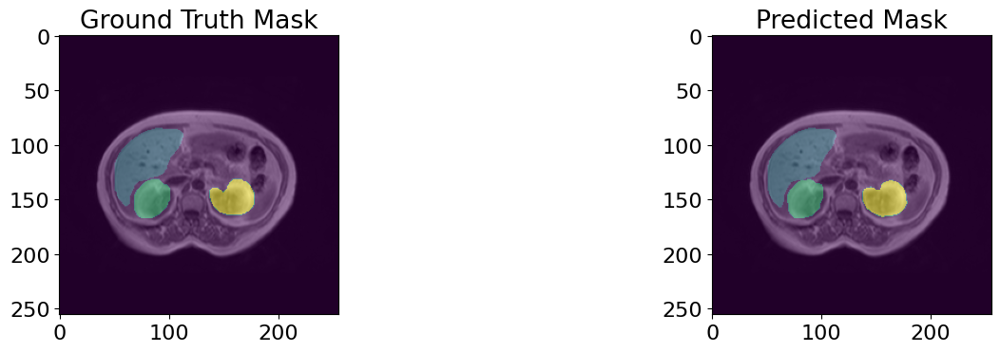

63/63 - 34s - loss: 8.9272e-04 - accuracy: 0.9997 - mean_iou: 0.9915 - val_loss: 0.0876 - val_accuracy: 0.9894 - val_mean_iou: 0.7876 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 200/1000


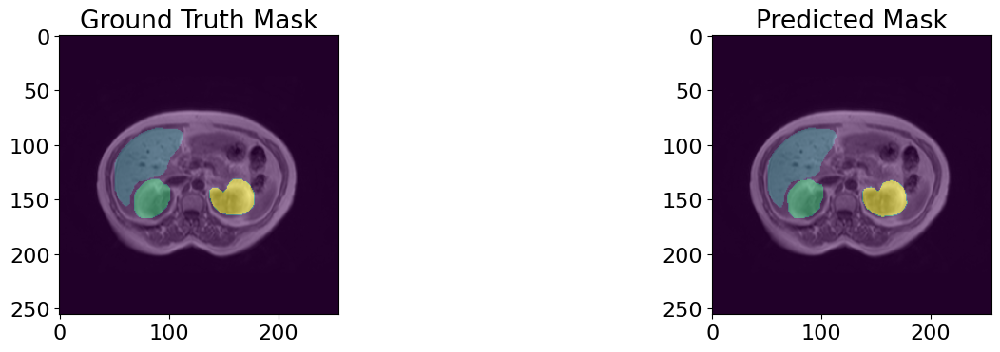

63/63 - 34s - loss: 8.8319e-04 - accuracy: 0.9997 - mean_iou: 0.9915 - val_loss: 0.0880 - val_accuracy: 0.9894 - val_mean_iou: 0.7874 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 201/1000


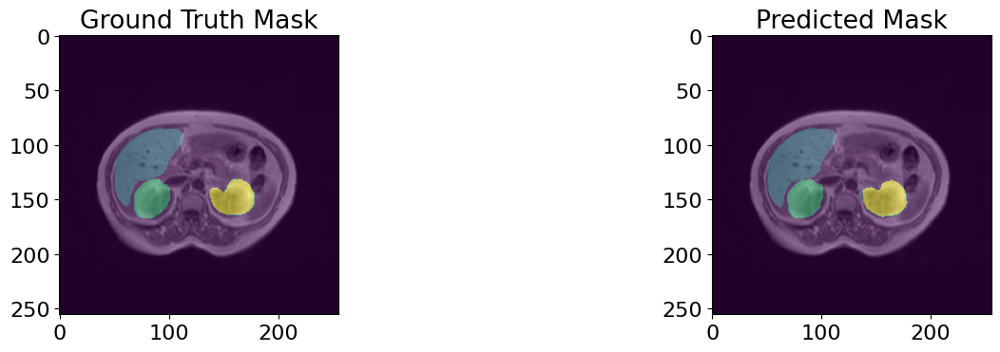

63/63 - 34s - loss: 8.8925e-04 - accuracy: 0.9997 - mean_iou: 0.9913 - val_loss: 0.0880 - val_accuracy: 0.9894 - val_mean_iou: 0.7874 - lr: 1.0000e-05 - 34s/epoch - 544ms/step
Epoch 202/1000


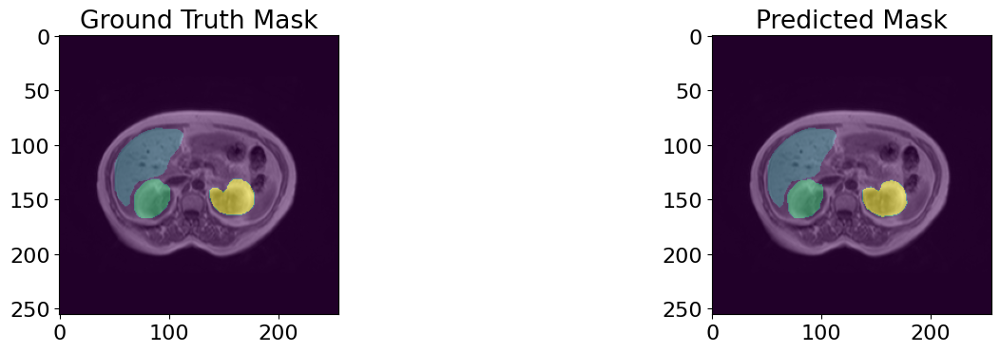

63/63 - 34s - loss: 8.9693e-04 - accuracy: 0.9996 - mean_iou: 0.9913 - val_loss: 0.0881 - val_accuracy: 0.9894 - val_mean_iou: 0.7879 - lr: 1.0000e-05 - 34s/epoch - 543ms/step
Epoch 203/1000


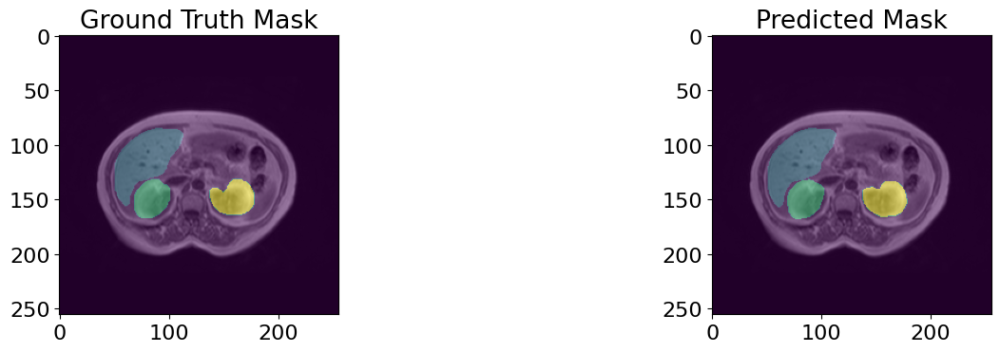

63/63 - 34s - loss: 8.9128e-04 - accuracy: 0.9997 - mean_iou: 0.9914 - val_loss: 0.0885 - val_accuracy: 0.9894 - val_mean_iou: 0.7872 - lr: 1.0000e-05 - 34s/epoch - 544ms/step


In [18]:
history = model.fit(
    x=X_train,
    y=y_train,
    epochs = epochs,
    batch_size = batch_size,
    validation_data = (X_val, y_val),
    callbacks=[early_stopping, viz_callback, scheduler],
    verbose=2
    )

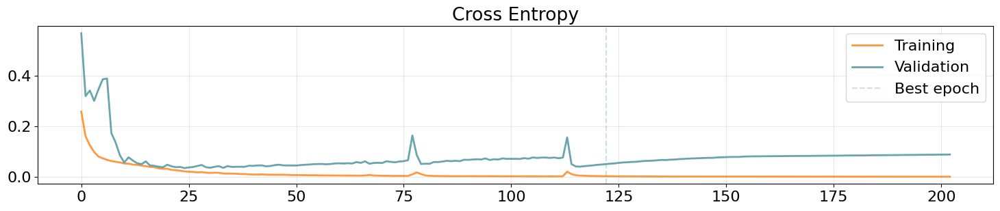

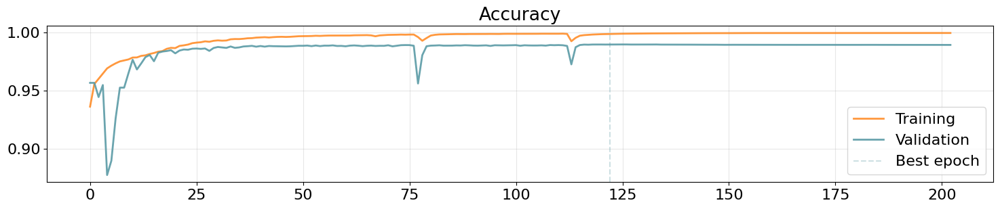

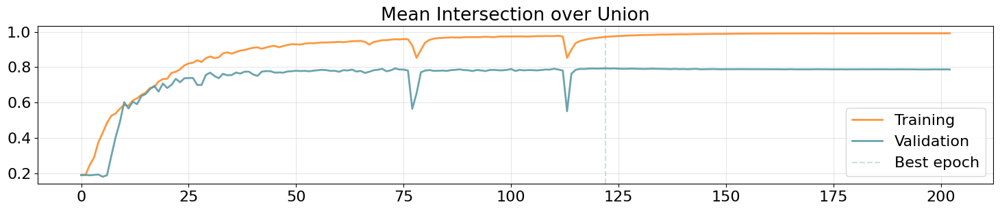

In [19]:
best_epoch = np.argmax(history.history['val_mean_iou'])
plt.figure(figsize=(18,3))
plt.plot(history.history['loss'], label='Training', alpha=.8, color='#ff7f0e', linewidth=2)
plt.plot(history.history['val_loss'], label='Validation', alpha=.9, color='#5a9aa5', linewidth=2)
plt.axvline(x=best_epoch, label='Best epoch', alpha=.3, ls='--', color='#5a9aa5')
plt.title('Cross Entropy')
plt.legend()
plt.grid(alpha=.3)
plt.show()

plt.figure(figsize=(18,3))
plt.plot(history.history['accuracy'], label='Training', alpha=.8, color='#ff7f0e', linewidth=2)
plt.plot(history.history['val_accuracy'], label='Validation', alpha=.9, color='#5a9aa5', linewidth=2)
plt.axvline(x=best_epoch, label='Best epoch', alpha=.3, ls='--', color='#5a9aa5')
plt.title('Accuracy')
plt.legend()
plt.grid(alpha=.3)
plt.show()

plt.figure(figsize=(18,3))
plt.plot(history.history['mean_iou'], label='Training', alpha=.8, color='#ff7f0e', linewidth=2)
plt.plot(history.history['val_mean_iou'], label='Validation', alpha=.9, color='#5a9aa5', linewidth=2)
plt.axvline(x=best_epoch, label='Best epoch', alpha=.3, ls='--', color='#5a9aa5')
plt.title('Mean Intersection over Union')
plt.legend()
plt.grid(alpha=.3)
plt.show()

In [20]:
model.save('UNet_augmented.h5')

In [21]:
# Evaluate the model on the test set and print the results
test_loss, test_accuracy, test_mean_iou = model.evaluate(X_test, y_test, verbose=0, batch_size=10)
print(f'Test Accuracy: {round(test_accuracy, 4)}')
print(f'Test Mean Intersection over Union: {round(test_mean_iou, 4)}')

Test Accuracy: 0.989
Test Mean Intersection over Union: 0.776


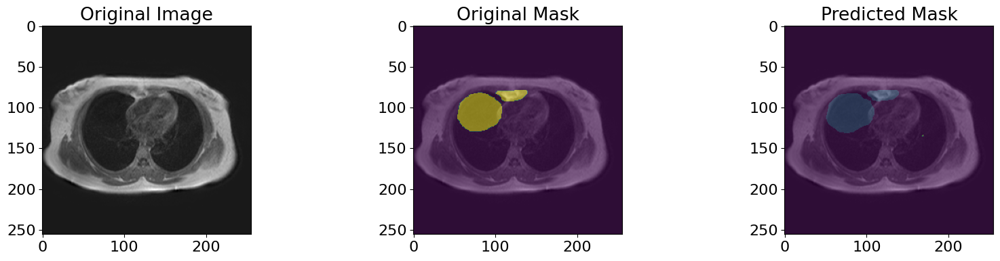

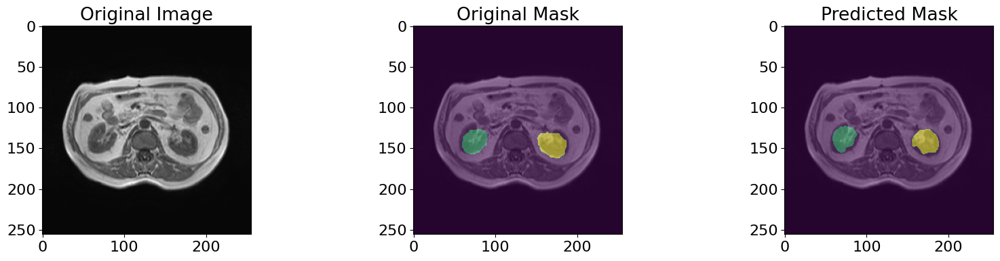

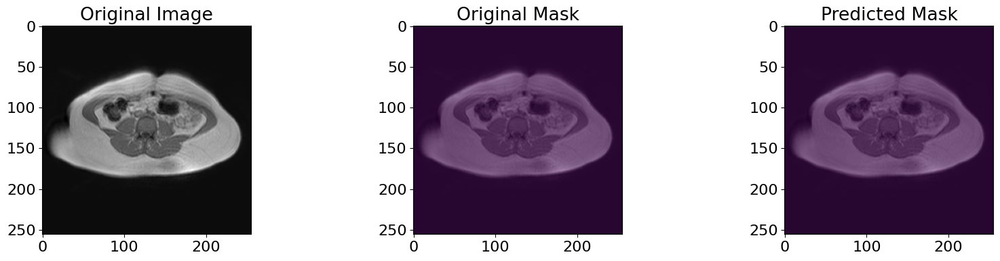

In [22]:
# Define a function to plot triptychs for model predictions
def plot_triptychs(data, labels, index=None):
    # If index is not specified, randomly select one
    if index is None:
        index = np.random.randint(0, len(data))

    # Generate predictions for the selected index
    pred = model.predict(np.expand_dims(data[index], axis=0), verbose=0)
    pred = np.array(tf.math.argmax(pred, axis=-1))
    pred = np.reshape(pred, (256, 256, 1))

    # Plot the original image, original mask, and predicted mask
    fig, axes = plt.subplots(1, 3, figsize=(20, 4))
    axes[0].set_title("Original Image")
    axes[0].imshow(data[index], cmap='gray')
    axes[1].set_title("Original Mask")
    axes[1].imshow(data[index], cmap='gray')
    #colored_image = display_color_mapped_image_continuous(labels[index])
    axes[1].imshow(np.squeeze(labels[index]),alpha=0.5)
    axes[2].set_title("Predicted Mask")
    axes[2].imshow(data[index], cmap='gray')
    #colored_image = display_color_mapped_image_continuous(pred)
    axes[2].imshow(np.squeeze(pred), alpha=0.5)
    plt.show()

# Plot triptychs for three random samples from the test set
plot_triptychs(X_test, y_test)
plot_triptychs(X_test, y_test)
plot_triptychs(X_test, y_test)